In [2]:
# Imports
%matplotlib notebook

import sys
import numpy as np  # Matrix and vector computation package
import matplotlib
import matplotlib.pyplot as plt  # Plotting library
from matplotlib import cm  # Colormaps
from matplotlib.colors import LogNorm
import seaborn as sns  # Fancier plots

# Set seaborn plotting style
sns.set_style('darkgrid')
# Set the seed for reproducability
np.random.seed(seed=1)
#

In [3]:
nb_of_samples = 20
sequence_len = 100

X = np.zeros((nb_of_samples, sequence_len))
for row in range(nb_of_samples):
    X[row,:] = np.around(np.random.rand(sequence_len)).astype(int)

t = np.sum(X, axis=1)
t

array([49., 54., 58., 55., 49., 47., 52., 50., 47., 45., 54., 52., 46.,
       57., 45., 53., 57., 57., 57., 51.])

In [4]:
def update_state(xk, sk, wx, wRec):
    return xk * wx + wRec * sk

def forward_states(X, wx, wRec):
    S = np.zeros((X.shape[0], X.shape[1] + 1))
    
    for k in range(0, X.shape[1]):
        S[:, k + 1] = update_state(X[:,k], S[:,k], wx, wRec)
    return S

def loss(y, t):
    return np.mean((t-y)**2)

In [5]:
def output_gradient(y, t):
    return 2. * (y - t)

In [6]:
def backward_gradient(X, S, grad_out, wRec):
    grad_over_time = np.zeros((X.shape[0], X.shape[1] + 1))
    grad_over_time[:, -1] = grad_out
    
    wx_grad = 0
    wRec_grad = 0
    cnt = 0
    for k in range(X.shape[1], 0, -1):
        print(grad_over_time)
        grad_over_time[:, k - 1] = grad_over_time[:, k] * wRec
        wx_grad += np.sum(np.mean(grad_over_time[:, k] * X[:, k-1], axis=0))
        wRec_grad += np.sum(np.mean(grad_over_time[:, k] * S[:,k-1], axis=0))
        
    return (wx_grad, wRec_grad), grad_over_time 

In [7]:
# Set the weight parameters used during gradient checking
params = [1.2, 1.2]  # [wx, wRec]
# Set the small change to compute the numerical gradient
eps = 1e-7
# Compute the backprop gradients
S = forward_states(X, params[0], params[1])
grad_out = output_gradient(S[:,-1], t)
backprop_grads, grad_over_time = backward_gradient(
    X, S, grad_out, params[1])
# Compute the numerical gradient for each parameter in the layer
for p_idx, _ in enumerate(params):
    grad_backprop = backprop_grads[p_idx]
    # + eps
    params[p_idx] += eps
    plus_loss = loss(forward_states(X, params[0], params[1])[:,-1], t)
    # - eps
    params[p_idx] -= 2 * eps
    min_loss = loss(forward_states(X, params[0], params[1])[:,-1], t)
    # reset param value
    params[p_idx] += eps
    # calculate numerical gradient
    grad_num = (plus_loss - min_loss) / (2*eps)
    # Raise error if the numerical grade is not close to 
    #  the backprop gradient
    if not np.isclose(grad_num, grad_backprop):
        raise ValueError((
            f'Numerical gradient of {grad_num:.6f} is not close to '
            f'the backpropagation gradient of {grad_backprop:.6f}!'))
print('No gradient errors found')

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 2.43334339e+08]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 5.93131428e+08]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 7.44392346e+08]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 5.53181867e+08]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 5.16989813e+08]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 3.97787977e+08]]
[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  2.92001207e+08 2.43334339e+08]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  7.11757714e+08 5.93131428e+08]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  8.93270816e+08 7.44392346e+08]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  6.63818240e+08 5.53181867e+08]

In [139]:
points = [(2,1,'r'), (1,2,'b'), (1.2,0.997,'m'), (1,0,'c'), 
          (1,0.5,'g'), (1,-0.5,'y')]

In [140]:
def get_loss_surface(w1_low, w1_high, w2_low, w2_high, nb_of_ws, loss_func):
    w1 = np.linspace(w1_low, w1_high, num = nb_of_ws)
    w2 = np.linspace(w2_low, w2_high, num = nb_of_ws)
    
    ws1, ws2 = np.meshgrid(w1, w2)
    loss_ws = np.zeros((nb_of_ws, nb_of_ws))
    
    for i in range (nb_of_ws):
        for j in range(nb_of_ws):
            loss_ws[i, j] = loss_func(ws1[i,j], ws2[i, j])
    return ws1, ws2, loss_ws

def plot_surface(ax, ws1, ws2, loss_ws):
    """Plot the loss in function of the weights."""
    surf = ax.contourf(
        ws1, ws2, loss_ws, levels=np.logspace(-0.2, 8, 30), 
        cmap=cm.viridis, norm=LogNorm())
    ax.set_xlabel('$w_{in}$', fontsize=12)
    ax.set_ylabel('$w_{rec}$', fontsize=12)
    return surf


def plot_points(ax, points):
    """Plot the annotation points on the given axis."""
    for wx, wRec, c in points:
        ax.plot(wx, wRec, c+'o', linewidth=2)

In [141]:
def get_loss_surface_figure(loss_func, points):
    """Plot the loss surfaces together with the annotated points."""
    # Plot figures
    fig = plt.figure(figsize=(10, 4))   
    # Plot overview of loss function
    ax_1 = fig.add_subplot(1,2,1)
    ws1_1, ws2_1, loss_ws_1 = get_loss_surface(
        -3, 3, -3, 3, 100, loss_func)
    surf_1 = plot_surface(ax_1, ws1_1, ws2_1, loss_ws_1 + 1)
    plot_points(ax_1, points)
    ax_1.set_xlim(-3, 3)
    ax_1.set_ylim(-3, 3)
    # Plot zoom of loss function
    ax_2 = fig.add_subplot(1,2,2)
    ws1_2, ws2_2, loss_ws_2 = get_loss_surface(
        -0.1, 2.1, -0.1, 2.1, 100, loss_func)
    surf_2 = plot_surface(ax_2, ws1_2, ws2_2, loss_ws_2 + 1)
    plot_points(ax_2, points)
    ax_2.set_xlim(-0.1, 2.1)
    ax_2.set_ylim(-0.1, 2.1)
    # Show the colorbar
    fig.subplots_adjust(right=0.8)
    cax = fig.add_axes([0.85, 0.12, 0.03, 0.78])
    cbar = fig.colorbar(
        surf_1, ticks=np.logspace(0, 8, 9), cax=cax)
    cbar.ax.set_ylabel(
        '$\\xi$', fontsize=12, rotation=0, labelpad=20)
    cbar.set_ticklabels(
        ['{:.0e}'.format(i) for i in np.logspace(0, 8, 9)])
    fig.suptitle('Loss surface', fontsize=15)
    return fig

def plot_gradient_over_time(points, get_grad_over_time):
    """Plot the gradients of the annotated points and how 
    they evolve over time."""
    fig = plt.figure(figsize=(6, 4))
    ax = plt.subplot(111)
    # Plot points
    for wx, wRec, c in points:
        grad_over_time = get_grad_over_time(wx, wRec)
        x = np.arange(-grad_over_time.shape[1]+1, 1, 1)
        plt.plot(
            x, np.sum(grad_over_time, axis=0), c+'-', 
            label=f'({wx}, {wRec})', linewidth=1, markersize=8)
    plt.xlim(0, -grad_over_time.shape[1]+1)
    # Set up plot axis
    plt.xticks(x)
    plt.yscale('symlog')
    plt.yticks([10**8, 10**6, 10**4, 10**2, 0, -10**2, -10**4, 
                -10**6, -10**8])
    plt.xlabel('timestep k', fontsize=12)
    plt.ylabel('$\\frac{\\partial \\xi}{\\partial S_{k}}$', 
               fontsize=20, rotation=0)
    plt.title(('Unstability of gradient in backward propagation.'
               '\n(backpropagate from left to right)'))
    # Set legend
    leg = plt.legend(
        loc='center left', bbox_to_anchor=(1, 0.5), 
        frameon=False, numpoints=1)
    leg.set_title('$(w_x, w_{rec})$', prop={'size':15})
    fig.subplots_adjust(right=0.8)

In [142]:
def get_grad_over_time(wx, wRec):
    """Helper func to only get the gradient over time 
    from wx and wRec."""
    S = forward_states(X, wx, wRec)
    grad_out = output_gradient(S[:,-1], t).sum()
    _, grad_over_time = backward_gradient(X, S, grad_out, wRec)
    return grad_over_time

<IPython.core.display.Javascript object>


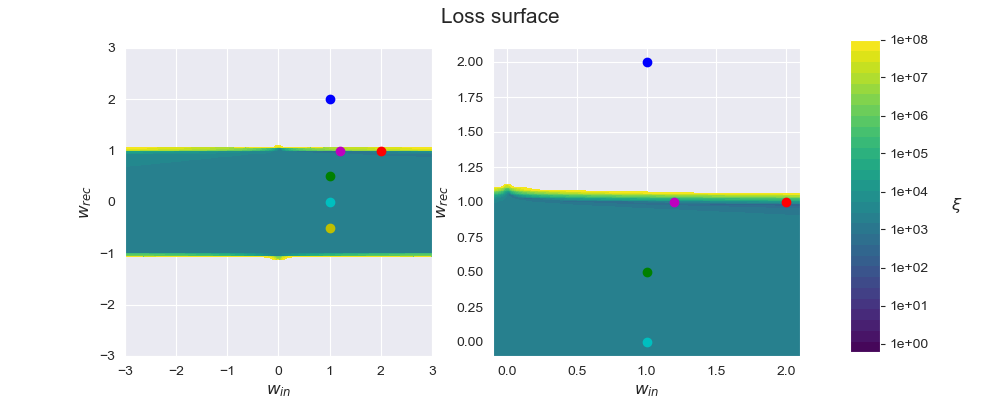

<IPython.core.display.Javascript object>


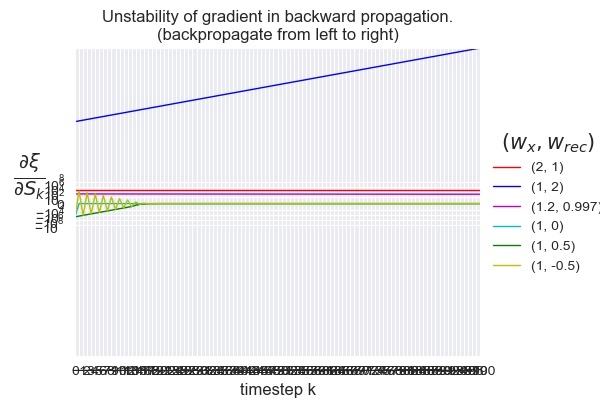

In [147]:
fig = get_loss_surface_figure(
    lambda w1, w2: loss(forward_states(X, w1, w2)[:,-1] , t), points)

# Get the plots of the gradients changing by backpropagating.
plot_gradient_over_time(points, get_grad_over_time)
# Show figures
plt.show()

In [8]:
def update_rprop(X, t, W, W_prev_sign, W_delta, eta_p, eta_n):
    S = forward_states(X, W[0], W[1])
    grad_out = output_gradient(S[:, -1], t)
    W_grads, _ = backward_gradient(X, S, grad_out, W[1])
    W_sign = np.sign(W_grads)
    
    for i, _ in enumerate(W):
        if W_sign[i] == W_prev_sign[i]:
            W_delta[i] = W_delta[i] * eta_p
        else:
            W_delta[i] = W_delta[i] * eta_n
            
    return W_delta, W_sign

In [ ]:
eta_p = 1.2
eta_n = 0.5

W = [-2, 2]
W_delta = [0.003, 0.003]
W_sign = [-1, 1]

ls_of_ws = [(W[0], W[1])]
nb_of_iters = 20000
for i in range(nb_of_iters):
    W_delta, W_sign = update_rprop(X, t, W, W_sign, W_delta, eta_p, eta_n)
    for i, _ in enumerate(W):
        W[i] -= W_sign[i] * W_delta[i]
    ls_of_ws.append((W[0], W[1]))
    
fig = plt.figure(figsize=(10,4))

ls1 = []
ls2 = []

for i in range(len(ls_of_ws)):
    ls1.append(ls_of_ws[i][0])
    ls2.append(ls_of_ws[i][1])
plt.plot(ls1, 'b-', label='wx')
plt.plot(ls2, 'r-', label='wrec')
leg = plt.legend(
loc='center left', bbox_to_anchor=(1, 0.5), 
frameon=False, numpoints=1)

[[ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
   0.00000000e+00 -1.27425066e+30]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
   0.00000000e+00 -2.17489652e+30]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
   0.00000000e+00 -4.82931093e+30]
 ...
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
   0.00000000e+00 -2.33830769e+30]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
   0.00000000e+00 -3.09390917e+30]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
   0.00000000e+00 -1.07053726e+30]]
[[ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
  -2.54850132e+30 -1.27425066e+30]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
  -4.34979305e+30 -2.17489652e+30]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
  -9.65862186e+30 -4.82931093e+30]
 ...
 [ 0.00000000e+00  0.00000000e+00  0.0000000

  -1.44944266e+30 -7.27602635e+29]]
[[ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -3.41466655e+30
  -1.71412119e+30 -8.60468050e+29]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -5.84493452e+30
  -2.93408624e+30 -1.47287571e+30]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -1.29303250e+31
  -6.49086632e+30 -3.25833617e+30]
 ...
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -6.28411014e+30
  -3.15454708e+30 -1.58354437e+30]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -8.27815054e+30
  -4.15553117e+30 -2.08602625e+30]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -2.88740573e+30
  -1.44944266e+30 -7.27602635e+29]]
[[ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -3.41466655e+30
  -1.71412119e+30 -8.60468050e+29]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -5.84493452e+30
  -2.93408624e+30 -1.47287571e+30]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -1.29303250e+31
  -6.49086632e+30 -3.25833617e+30]
 ...
 [ 0.000

[[ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
   0.00000000e+00 -1.24274907e+29]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
   0.00000000e+00 -2.15822484e+29]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
   0.00000000e+00 -4.68737812e+29]
 ...
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
   0.00000000e+00 -2.32016158e+29]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
   0.00000000e+00 -2.99123862e+29]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
   0.00000000e+00 -1.08513558e+29]]
[[ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
  -2.42771371e+29 -1.24274907e+29]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
  -4.21609814e+29 -2.15822484e+29]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ...  0.00000000e+00
  -9.15680604e+29 -4.68737812e+29]
 ...
 [ 0.00000000e+00  0.00000000e+00  0.0000000

[[ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -1.08267563e+29
  -5.62392684e+28 -2.92133233e+28]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -1.90134104e+29
  -9.87646036e+28 -5.13029841e+28]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -4.07264473e+29
  -2.11552338e+29 -1.09890242e+29]
 ...
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -2.04358930e+29
  -1.06153648e+29 -5.51412014e+28]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -2.59313512e+29
  -1.34699645e+29 -6.99693359e+28]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -9.68537345e+28
  -5.03103887e+28 -2.61335841e+28]]
[[ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -1.08267563e+29
  -5.62392684e+28 -2.92133233e+28]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -1.90134104e+29
  -9.87646036e+28 -5.13029841e+28]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -4.07264473e+29
  -2.11552338e+29 -1.09890242e+29]
 ...
 [ 0.00000000e+00  0.00000000e+00  0.0000000

[[ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -2.93340958e+27
  -1.57921588e+27 -8.50178848e+26]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -5.30062627e+27
  -2.85361894e+27 -1.53626018e+27]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -1.09726363e+28
  -5.90717418e+27 -3.18015708e+27]
 ...
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -5.69135174e+27
  -3.06396798e+27 -1.64950265e+27]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -6.95314219e+27
  -3.74325924e+27 -2.01520253e+27]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -2.78598961e+27
  -1.49985159e+27 -8.07452683e+26]]
[[ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -2.93340958e+27
  -1.57921588e+27 -8.50178848e+26]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -5.30062627e+27
  -2.85361894e+27 -1.53626018e+27]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -1.09726363e+28
  -5.90717418e+27 -3.18015708e+27]
 ...
 [ 0.00000000e+00  0.00000000e+00  0.0000000

[[ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -4.17925027e+24
  -2.40093849e+24 -1.37931573e+24]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -7.99114310e+24
  -4.59083372e+24 -2.63738916e+24]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -1.55262969e+25
  -8.91970602e+24 -5.12428405e+24]
 ...
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -8.54380837e+24
  -4.90833452e+24 -2.81979027e+24]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -9.78028712e+24
  -5.61867949e+24 -3.22787652e+24]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -4.43436880e+24
  -2.54750159e+24 -1.46351480e+24]]
[[ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -4.17925027e+24
  -2.40093849e+24 -1.37931573e+24]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -7.99114310e+24
  -4.59083372e+24 -2.63738916e+24]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -1.55262969e+25
  -8.91970602e+24 -5.12428405e+24]
 ...
 [ 0.00000000e+00  0.00000000e+00  0.0000000

  -2.04730310e+21 -1.26482136e+21]]
[[ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -2.75493149e+21
  -1.70199332e+21 -1.05148940e+21]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -5.65018839e+21
  -3.49067951e+21 -2.15653755e+21]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -1.02000771e+22
  -6.30159520e+21 -3.89311784e+21]
 ...
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -5.98273852e+21
  -3.69612857e+21 -2.28346373e+21]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -6.41297894e+21
  -3.96193058e+21 -2.44767589e+21]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -3.31386716e+21
  -2.04730310e+21 -1.26482136e+21]]
[[ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -2.75493149e+21
  -1.70199332e+21 -1.05148940e+21]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -5.65018839e+21
  -3.49067951e+21 -2.15653755e+21]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -1.02000771e+22
  -6.30159520e+21 -3.89311784e+21]
 ...
 [ 0.000

[[ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -6.82836866e+12
  -5.14214124e+12 -3.87231825e+12]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -1.68682526e+13
  -1.27027320e+13 -9.56586345e+12]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -2.43488843e+13
  -1.83360636e+13 -1.38080753e+13]
 ...
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -1.66768239e+13
  -1.25585756e+13 -9.45730566e+12]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -1.57990171e+13
  -1.18975383e+13 -8.95950779e+12]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -1.09864507e+13
  -8.27340817e+12 -6.23033634e+12]]
[[ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -6.82836866e+12
  -5.14214124e+12 -3.87231825e+12]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -1.68682526e+13
  -1.27027320e+13 -9.56586345e+12]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00 ... -2.43488843e+13
  -1.83360636e+13 -1.38080753e+13]
 ...
 [ 0.00000000e+00  0.00000000e+00  0.0000000

[[   0.            0.            0.         ...    0.
   -85.51819255 -103.58969544]
 [   0.            0.            0.         ...    0.
   -94.34297327 -114.27930803]
 [   0.            0.            0.         ...    0.
   -98.69453587 -119.55043258]
 ...
 [   0.            0.            0.         ...    0.
   -99.60668039 -120.65532933]
 [   0.            0.            0.         ...    0.
   -98.25877782 -119.02259117]
 [   0.            0.            0.         ...    0.
   -88.40479715 -107.08629053]]
[[   0.            0.            0.         ...  -70.59931227
   -85.51819255 -103.58969544]
 [   0.            0.            0.         ...  -77.8845861
   -94.34297327 -114.27930803]
 [   0.            0.            0.         ...  -81.47700682
   -98.69453587 -119.55043258]
 ...
 [   0.            0.            0.         ...  -82.23002526
   -99.60668039 -120.65532933]
 [   0.            0.            0.         ...  -81.11726794
   -98.25877782 -119.02259117]
 [   0.        

   -30.88660251 -102.65828272]]
[[   0.            0.            0.         ...   -8.93204703
   -29.6875841   -98.67308652]
 [   0.            0.            0.         ...   -9.8478264
   -32.73137427 -108.7897794 ]
 [   0.            0.            0.         ...  -10.51691292
   -34.95522757 -116.1812353 ]
 ...
 [   0.            0.            0.         ...  -10.3424585
   -34.37539071 -114.2540225 ]
 [   0.            0.            0.         ...  -10.37931606
   -34.49789475 -114.66119109]
 [   0.            0.            0.         ...   -9.29279343
   -30.88660251 -102.65828272]]
[[   0.            0.            0.         ...   -8.93204703
   -29.6875841   -98.67308652]
 [   0.            0.            0.         ...   -9.8478264
   -32.73137427 -108.7897794 ]
 [   0.            0.            0.         ...  -10.51691292
   -34.95522757 -116.1812353 ]
 ...
 [   0.            0.            0.         ...  -10.3424585
   -34.37539071 -114.2540225 ]
 [   0.            0.          

[[   0.            0.            0.         ...  -10.76622775
   -32.11778896  -95.81372337]
 [   0.            0.            0.         ...  -11.84672484
   -35.34112571 -105.42957506]
 [   0.            0.            0.         ...  -12.96282503
   -38.67067352 -115.3622754 ]
 ...
 [   0.            0.            0.         ...  -12.70488382
   -37.90118382 -113.06673529]
 [   0.            0.            0.         ...  -12.56972412
   -37.49797571 -111.86388564]
 [   0.            0.            0.         ...  -11.22275132
   -33.47968916  -99.8765413 ]]
[[   0.            0.            0.         ...  -10.76622775
   -32.11778896  -95.81372337]
 [   0.            0.            0.         ...  -11.84672484
   -35.34112571 -105.42957506]
 [   0.            0.            0.         ...  -12.96282503
   -38.67067352 -115.3622754 ]
 ...
 [   0.            0.            0.         ...  -12.70488382
   -37.90118382 -113.06673529]
 [   0.            0.            0.         ...  -12.569724

  1.92034581e+10 1.55460533e+10]]
[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.43152785e+10
  1.15888545e+10 9.38169303e+09]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.56884583e+10
  2.88913939e+10 2.33888681e+10]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.67411411e+10
  3.78390322e+10 3.06323792e+10]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.38432845e+10
  2.73976437e+10 2.21796109e+10]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.15954555e+10
  2.55779262e+10 2.07064687e+10]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 2.37213135e+10
  1.92034581e+10 1.55460533e+10]]
[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.43152785e+10
  1.15888545e+10 9.38169303e+09]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.56884583e+10
  2.88913939e+10 2.33888681e+10]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.67411411e+10
  3.78390322e+10 3.06323792e+10]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.38432845e+1

[[  0.           0.           0.         ... -38.82727709 -40.85314284
  -42.98471088]
 [  0.           0.           0.         ... -47.32603334 -49.7953332
  -52.39347213]
 [  0.           0.           0.         ... -58.24492757 -61.28393553
  -64.48150784]
 ...
 [  0.           0.           0.         ... -44.51340992 -46.83595735
  -49.27968684]
 [  0.           0.           0.         ... -54.58904552 -57.43730288
  -60.43417192]
 [  0.           0.           0.         ... -47.35559597 -49.82643831
  -52.42620019]]
[[  0.           0.           0.         ... -38.82727709 -40.85314284
  -42.98471088]
 [  0.           0.           0.         ... -47.32603334 -49.7953332
  -52.39347213]
 [  0.           0.           0.         ... -58.24492757 -61.28393553
  -64.48150784]
 ...
 [  0.           0.           0.         ... -44.51340992 -46.83595735
  -49.27968684]
 [  0.           0.           0.         ... -54.58904552 -57.43730288
  -60.43417192]
 [  0.           0.           0.  

[[  0.           0.           0.         ... -47.54053948 -50.70489522
  -54.0798743 ]
 [  0.           0.           0.         ... -55.50518411 -59.19967622
  -63.14007819]
 [  0.           0.           0.         ... -67.39209302 -71.87779215
  -76.66206483]
 ...
 [  0.           0.           0.         ... -54.03679904 -57.63355366
  -61.46971262]
 [  0.           0.           0.         ... -63.37373797 -67.59197053
  -72.09097374]
 [  0.           0.           0.         ... -55.35108071 -59.03531551
  -62.96477743]]
[[  0.           0.           0.         ... -47.54053948 -50.70489522
  -54.0798743 ]
 [  0.           0.           0.         ... -55.50518411 -59.19967622
  -63.14007819]
 [  0.           0.           0.         ... -67.39209302 -71.87779215
  -76.66206483]
 ...
 [  0.           0.           0.         ... -54.03679904 -57.63355366
  -61.46971262]
 [  0.           0.           0.         ... -63.37373797 -67.59197053
  -72.09097374]
 [  0.           0.           0.

[[  0.           0.           0.         ... 141.35906109 141.4834763
  141.608001  ]
 [  0.           0.           0.         ... 154.61190552 154.74798503
  154.88418431]
 [  0.           0.           0.         ... 165.89840517 166.04441834
  166.19056001]
 ...
 [  0.           0.           0.         ... 163.91056994 164.05483354
  164.19922411]
 [  0.           0.           0.         ... 163.20546036 163.34910337
  163.4928728 ]
 [  0.           0.           0.         ... 146.30004629 146.42881023
  146.5576875 ]]
[[  0.           0.           0.         ... 141.35906109 141.4834763
  141.608001  ]
 [  0.           0.           0.         ... 154.61190552 154.74798503
  154.88418431]
 [  0.           0.           0.         ... 165.89840517 166.04441834
  166.19056001]
 ...
 [  0.           0.           0.         ... 163.91056994 164.05483354
  164.19922411]
 [  0.           0.           0.         ... 163.20546036 163.34910337
  163.4928728 ]
 [  0.           0.           0.  

  33.32955506]]
[[ 0.          0.          0.         ... 38.19662362 38.76740184
  39.3467093 ]
 [ 0.          0.          0.         ... 33.64374735 34.14649122
  34.65674767]
 [ 0.          0.          0.         ... 32.94950988 33.44187964
  33.94160697]
 ...
 [ 0.          0.          0.         ... 41.59134013 42.21284614
  42.84363941]
 [ 0.          0.          0.         ... 33.879401   34.38566627
  34.89949675]
 [ 0.          0.          0.         ... 32.35534796 32.83883907
  33.32955506]]
[[ 0.          0.          0.         ... 38.19662362 38.76740184
  39.3467093 ]
 [ 0.          0.          0.         ... 33.64374735 34.14649122
  34.65674767]
 [ 0.          0.          0.         ... 32.94950988 33.44187964
  33.94160697]
 ...
 [ 0.          0.          0.         ... 41.59134013 42.21284614
  42.84363941]
 [ 0.          0.          0.         ... 33.879401   34.38566627
  34.89949675]
 [ 0.          0.          0.         ... 32.35534796 32.83883907
  33.32955506]]


[[  0.           0.           0.         ...  -1.57875437  -1.62056191
   -1.66347658]
 [  0.           0.           0.         ...  -9.67790965  -9.93419375
  -10.1972646 ]
 [  0.           0.           0.         ... -15.59887675 -16.01195605
  -16.43597423]
 ...
 [  0.           0.           0.         ...  -3.54911972  -3.6431052
   -3.73957954]
 [  0.           0.           0.         ... -13.35497487 -13.70863261
  -14.07165569]
 [  0.           0.           0.         ...  -9.94862152 -10.21207444
  -10.48250394]]
[[  0.           0.           0.         ...  -1.57875437  -1.62056191
   -1.66347658]
 [  0.           0.           0.         ...  -9.67790965  -9.93419375
  -10.1972646 ]
 [  0.           0.           0.         ... -15.59887675 -16.01195605
  -16.43597423]
 ...
 [  0.           0.           0.         ...  -3.54911972  -3.6431052
   -3.73957954]
 [  0.           0.           0.         ... -13.35497487 -13.70863261
  -14.07165569]
 [  0.           0.           0.  

   1.5201578 ]]
[[ 0.          0.          0.         ...  9.28822834  9.49775212
   9.71200235]
 [ 0.          0.          0.         ...  1.89852737  1.94135434
   1.98514739]
 [ 0.          0.          0.         ... -2.55839393 -2.61610616
  -2.67512026]
 ...
 [ 0.          0.          0.         ...  8.64093668  8.83585887
   9.03517811]
 [ 0.          0.          0.         ... -0.68287771 -0.69828206
  -0.7140339 ]
 [ 0.          0.          0.         ...  1.45382716  1.48662258
   1.5201578 ]]
[[ 0.          0.          0.         ...  9.28822834  9.49775212
   9.71200235]
 [ 0.          0.          0.         ...  1.89852737  1.94135434
   1.98514739]
 [ 0.          0.          0.         ... -2.55839393 -2.61610616
  -2.67512026]
 ...
 [ 0.          0.          0.         ...  8.64093668  8.83585887
   9.03517811]
 [ 0.          0.          0.         ... -0.68287771 -0.69828206
  -0.7140339 ]
 [ 0.          0.          0.         ...  1.45382716  1.48662258
   1.5201578 ]]


  -1.91070253]]
[[ 0.          0.          0.         ...  6.17851782  6.32433878
   6.47360131]
 [ 0.          0.          0.         ... -1.43644177 -1.47034364
  -1.50504565]
 [ 0.          0.          0.         ... -6.30986864 -6.45878965
  -6.61122539]
 ...
 [ 0.          0.          0.         ...  5.14105455  5.26239005
   5.38658922]
 [ 0.          0.          0.         ... -4.3301386  -4.43233544
  -4.53694425]
 [ 0.          0.          0.         ... -1.82360777 -1.86664725
  -1.91070253]]
[[ 0.          0.          0.         ...  6.17851782  6.32433878
   6.47360131]
 [ 0.          0.          0.         ... -1.43644177 -1.47034364
  -1.50504565]
 [ 0.          0.          0.         ... -6.30986864 -6.45878965
  -6.61122539]
 ...
 [ 0.          0.          0.         ...  5.14105455  5.26239005
   5.38658922]
 [ 0.          0.          0.         ... -4.3301386  -4.43233544
  -4.53694425]
 [ 0.          0.          0.         ... -1.82360777 -1.86664725
  -1.91070253]]


[[ 0.          0.64849952  0.66379224 ...  6.22004571  6.36672499
   6.51686322]
 [ 0.         -0.14505119 -0.14847175 ... -1.39125015 -1.4240582
  -1.45763992]
 [ 0.         -0.65240176 -0.66778651 ... -6.25747385 -6.40503575
  -6.55607741]
 ...
 [ 0.          0.54084117  0.55359512 ...  5.18744685  5.30977568
   5.43498924]
 [ 0.         -0.44619627 -0.45671834 ... -4.27966581 -4.38058762
  -4.48388935]
 [ 0.         -0.18542299 -0.18979558 ... -1.77847395 -1.8204134
  -1.86334185]]
[[ 0.          0.          0.         ...  0.          0.
   6.33923814]
 [ 0.          0.          0.         ...  0.          0.
  -1.6485956 ]
 [ 0.          0.          0.         ...  0.          0.
  -6.77156982]
 ...
 [ 0.          0.          0.         ...  0.          0.
   5.23512761]
 [ 0.          0.          0.         ...  0.          0.
  -4.69314116]
 [ 0.          0.          0.         ...  0.          0.
  -2.05122863]]
[[ 0.          0.          0.         ...  0.          6.19283669


[[ 0.          0.          0.         ...  5.93694962  6.07751107
   6.22140041]
 [ 0.          0.          0.         ... -1.69347267 -1.73356682
  -1.77461023]
 [ 0.          0.          0.         ... -6.59654084 -6.75271857
  -6.91259392]
 ...
 [ 0.          0.          0.         ...  4.869063    4.98434148
   5.10234926]
 [ 0.          0.          0.         ... -4.60958241 -4.71871751
  -4.83043646]
 [ 0.          0.          0.         ... -2.07527883 -2.12441251
  -2.17470947]]
[[ 0.          0.          0.         ...  5.93694962  6.07751107
   6.22140041]
 [ 0.          0.          0.         ... -1.69347267 -1.73356682
  -1.77461023]
 [ 0.          0.          0.         ... -6.59654084 -6.75271857
  -6.91259392]
 ...
 [ 0.          0.          0.         ...  4.869063    4.98434148
   5.10234926]
 [ 0.          0.          0.         ... -4.60958241 -4.71871751
  -4.83043646]
 [ 0.          0.          0.         ... -2.07527883 -2.12441251
  -2.17470947]]
[[ 0.          0

[[ 0.          0.          0.         ...  5.99187202  6.13354369
   6.27856505]
 [ 0.          0.          0.         ... -1.63290088 -1.67150914
  -1.71103027]
 [ 0.          0.          0.         ... -6.52466808 -6.67893717
  -6.8368538 ]
 ...
 [ 0.          0.          0.         ...  4.93009046  5.04665739
   5.16598044]
 [ 0.          0.          0.         ... -4.54082416 -4.6481873
  -4.75808892]
 [ 0.          0.          0.         ... -2.01404382 -2.06166382
  -2.11040975]]
[[ 0.          0.          0.         ...  5.99187202  6.13354369
   6.27856505]
 [ 0.          0.          0.         ... -1.63290088 -1.67150914
  -1.71103027]
 [ 0.          0.          0.         ... -6.52466808 -6.67893717
  -6.8368538 ]
 ...
 [ 0.          0.          0.         ...  4.93009046  5.04665739
   5.16598044]
 [ 0.          0.          0.         ... -4.54082416 -4.6481873
  -4.75808892]
 [ 0.          0.          0.         ... -2.01404382 -2.06166382
  -2.11040975]]
[[ 0.          0. 

[[ 0.          0.          0.         ...  5.96000001  6.10086138
   6.24505193]
 [ 0.          0.          0.         ... -1.66400726 -1.70333517
  -1.74359257]
 [ 0.          0.          0.         ... -6.553717   -6.70861055
  -6.86716492]
 ...
 [ 0.          0.          0.         ...  4.89314891  5.00879583
   5.127176  ]
 [ 0.          0.          0.         ... -4.57084384 -4.67887325
  -4.78945589]
 [ 0.          0.          0.         ... -2.04198514 -2.09024635
  -2.13964819]]
[[ 0.          0.          0.         ...  5.96000001  6.10086138
   6.24505193]
 [ 0.          0.          0.         ... -1.66400726 -1.70333517
  -1.74359257]
 [ 0.          0.          0.         ... -6.553717   -6.70861055
  -6.86716492]
 ...
 [ 0.          0.          0.         ...  4.89314891  5.00879583
   5.127176  ]
 [ 0.          0.          0.         ... -4.57084384 -4.67887325
  -4.78945589]
 [ 0.          0.          0.         ... -2.04198514 -2.09024635
  -2.13964819]]
[[ 0.          0

  -2.19824188]]
[[ 0.          0.          0.         ...  5.89763219  6.03693781
   6.17953391]
 [ 0.          0.          0.         ... -1.72556827 -1.76632723
  -1.80804894]
 [ 0.          0.          0.         ... -6.61272773 -6.76892434
  -6.9288104 ]
 ...
 [ 0.          0.          0.         ...  4.82112306  4.93500088
   5.05156857]
 [ 0.          0.          0.         ... -4.63127824 -4.74067182
  -4.85264934]
 [ 0.          0.          0.         ... -2.09796115 -2.14751626
  -2.19824188]]
[[ 0.          0.          0.         ...  5.89763219  6.03693781
   6.17953391]
 [ 0.          0.          0.         ... -1.72556827 -1.76632723
  -1.80804894]
 [ 0.          0.          0.         ... -6.61272773 -6.76892434
  -6.9288104 ]
 ...
 [ 0.          0.          0.         ...  4.82112306  4.93500088
   5.05156857]
 [ 0.          0.          0.         ... -4.63127824 -4.74067182
  -4.85264934]
 [ 0.          0.          0.         ... -2.09796115 -2.14751626
  -2.19824188]]


[[ 0.          0.          0.         ...  5.78972591  5.92634408
   6.06618599]
 [ 0.          0.          0.         ... -1.8320836  -1.87531465
  -1.91956581]
 [ 0.          0.          0.         ... -6.71485509 -6.87330322
  -7.0354902 ]
 ...
 [ 0.          0.          0.         ...  4.69651424  4.80733628
   4.92077335]
 [ 0.          0.          0.         ... -4.73586077 -4.84761125
  -4.96199867]
 [ 0.          0.          0.         ... -2.19482546 -2.246616
  -2.29962863]]
[[ 0.          0.          0.         ...  5.78972591  5.92634408
   6.06618599]
 [ 0.          0.          0.         ... -1.8320836  -1.87531465
  -1.91956581]
 [ 0.          0.          0.         ... -6.71485509 -6.87330322
  -7.0354902 ]
 ...
 [ 0.          0.          0.         ...  4.69651424  4.80733628
   4.92077335]
 [ 0.          0.          0.         ... -4.73586077 -4.84761125
  -4.96199867]
 [ 0.          0.          0.         ... -2.19482546 -2.246616
  -2.29962863]]
[[ 0.          0.   

  -2.23398955]]
[[ 0.          0.          0.         ...  5.8431832   5.98082104
   6.12170098]
 [ 0.          0.          0.         ... -1.77156482 -1.81329453
  -1.8560072 ]
 [ 0.          0.          0.         ... -6.64011837 -6.79652824
  -6.9566224 ]
 ...
 [ 0.          0.          0.         ...  4.75536829  4.86738234
   4.98203491]
 [ 0.          0.          0.         ... -4.66519242 -4.77508236
  -4.88756078]
 [ 0.          0.          0.         ... -2.13235018 -2.1825783
  -2.23398955]]
[[ 0.          0.          0.         ...  5.8431832   5.98082104
   6.12170098]
 [ 0.          0.          0.         ... -1.77156482 -1.81329453
  -1.8560072 ]
 [ 0.          0.          0.         ... -6.64011837 -6.79652824
  -6.9566224 ]
 ...
 [ 0.          0.          0.         ...  4.75536829  4.86738234
   4.98203491]
 [ 0.          0.          0.         ... -4.66519242 -4.77508236
  -4.88756078]
 [ 0.          0.          0.         ... -2.13235018 -2.1825783
  -2.23398955]]
[[

[[ 0.          0.          0.         ...  5.95275957  6.09255299
   6.23562928]
 [ 0.          0.          0.         ... -1.64937993 -1.68811364
  -1.72775696]
 [ 0.          0.          0.         ... -6.49286772 -6.64534493
  -6.80140288]
 ...
 [ 0.          0.          0.         ...  4.8767526   4.99127728
   5.10849144]
 [ 0.          0.          0.         ... -4.52496548 -4.63122886
  -4.73998771]
 [ 0.          0.          0.         ... -2.00784942 -2.05500135
  -2.10326059]]
[[ 0.          0.          0.         ...  5.95275957  6.09255299
   6.23562928]
 [ 0.          0.          0.         ... -1.64937993 -1.68811364
  -1.72775696]
 [ 0.          0.          0.         ... -6.49286772 -6.64534493
  -6.80140288]
 ...
 [ 0.          0.          0.         ...  4.8767526   4.99127728
   5.10849144]
 [ 0.          0.          0.         ... -4.52496548 -4.63122886
  -4.73998771]
 [ 0.          0.          0.         ... -2.00784942 -2.05500135
  -2.10326059]]
[[ 0.          0

  -2.1820633 ]]
[[ 0.          0.          0.         ...  5.86690653  6.00453449
   6.14539097]
 [ 0.          0.          0.         ... -1.73316621 -1.77382343
  -1.8154344 ]
 [ 0.          0.          0.         ... -6.57123898 -6.72538941
  -6.88315596]
 ...
 [ 0.          0.          0.         ...  4.77729691  4.88936442
   5.00406084]
 [ 0.          0.          0.         ... -4.6059095  -4.71395654
  -4.82453819]
 [ 0.          0.          0.         ... -2.08318096 -2.13204895
  -2.1820633 ]]
[[ 0.          0.          0.         ...  5.86690653  6.00453449
   6.14539097]
 [ 0.          0.          0.         ... -1.73316621 -1.77382343
  -1.8154344 ]
 [ 0.          0.          0.         ... -6.57123898 -6.72538941
  -6.88315596]
 ...
 [ 0.          0.          0.         ...  4.77729691  4.88936442
   5.00406084]
 [ 0.          0.          0.         ... -4.6059095  -4.71395654
  -4.82453819]
 [ 0.          0.          0.         ... -2.08318096 -2.13204895
  -2.1820633 ]]


  -2.34009374]]
[[ 0.          0.          0.         ...  5.69878406  5.83225699
   5.96885602]
 [ 0.          0.          0.         ... -1.89912382 -1.94360376
  -1.98912549]
 [ 0.          0.          0.         ... -6.73056196 -6.88820046
  -7.04953107]
 ...
 [ 0.          0.          0.         ...  4.58323109  4.69057632
   4.80043571]
 [ 0.          0.          0.         ... -4.7689909  -4.88068687
  -4.9949989 ]
 [ 0.          0.          0.         ... -2.23421186 -2.28654
  -2.34009374]]
[[ 0.          0.          0.         ...  5.69878406  5.83225699
   5.96885602]
 [ 0.          0.          0.         ... -1.89912382 -1.94360376
  -1.98912549]
 [ 0.          0.          0.         ... -6.73056196 -6.88820046
  -7.04953107]
 ...
 [ 0.          0.          0.         ...  4.58323109  4.69057632
   4.80043571]
 [ 0.          0.          0.         ... -4.7689909  -4.88068687
  -4.9949989 ]
 [ 0.          0.          0.         ... -2.23421186 -2.28654
  -2.34009374]]
[[ 0. 

[[ 0.          0.          0.         ...  0.          0.
   6.15080981]
 [ 0.          0.          0.         ...  0.          0.
  -1.79264884]
 [ 0.          0.          0.         ...  0.          0.
  -6.82666191]
 ...
 [ 0.          0.          0.         ...  0.          0.
   5.00507954]
 [ 0.          0.          0.         ...  0.          0.
  -4.77892731]
 [ 0.          0.          0.         ...  0.          0.
  -2.14632765]]
[[ 0.          0.          0.         ...  0.          6.01042268
   6.15080981]
 [ 0.          0.          0.         ...  0.         -1.75173312
  -1.79264884]
 [ 0.          0.          0.         ...  0.         -6.67084902
  -6.82666191]
 ...
 [ 0.          0.          0.         ...  0.          4.89084275
   5.00507954]
 [ 0.          0.          0.         ...  0.         -4.66985226
  -4.77892731]
 [ 0.          0.          0.         ...  0.         -2.0973395
  -2.14632765]]
[[ 0.          0.          0.         ...  5.87323977  6.01042268

[[ 0.          0.          0.         ...  5.97604814  6.11523286
   6.25765925]
 [ 0.          0.          0.         ... -1.5969316  -1.63412482
  -1.67218428]
 [ 0.          0.          0.         ... -6.38030667 -6.52890674
  -6.68096777]
 ...
 [ 0.          0.          0.         ...  4.89320802  5.00717293
   5.12379213]
 [ 0.          0.          0.         ... -4.43155147 -4.53476421
  -4.64038081]
 [ 0.          0.          0.         ... -1.93255878 -1.9775689
  -2.02362733]]
[[ 0.          0.          0.         ...  5.97604814  6.11523286
   6.25765925]
 [ 0.          0.          0.         ... -1.5969316  -1.63412482
  -1.67218428]
 [ 0.          0.          0.         ... -6.38030667 -6.52890674
  -6.68096777]
 ...
 [ 0.          0.          0.         ...  4.89320802  5.00717293
   5.12379213]
 [ 0.          0.          0.         ... -4.43155147 -4.53476421
  -4.64038081]
 [ 0.          0.          0.         ... -1.93255878 -1.9775689
  -2.02362733]]
[[ 0.          0. 

  -2.22281485]]
[[ 0.          0.          0.         ...  5.77714969  5.91169145
   6.04936649]
 [ 0.          0.          0.         ... -1.79950696 -1.84141496
  -1.88429895]
 [ 0.          0.          0.         ... -6.58802986 -6.74145589
  -6.89845499]
 ...
 [ 0.          0.          0.         ...  4.66585446  4.7745157
   4.88570751]
 [ 0.          0.          0.         ... -4.6395321  -4.74758033
  -4.85814485]
 [ 0.          0.          0.         ... -2.12278991 -2.17222672
  -2.22281485]]
[[ 0.          0.          0.         ...  5.77714969  5.91169145
   6.04936649]
 [ 0.          0.          0.         ... -1.79950696 -1.84141496
  -1.88429895]
 [ 0.          0.          0.         ... -6.58802986 -6.74145589
  -6.89845499]
 ...
 [ 0.          0.          0.         ...  4.66585446  4.7745157
   4.88570751]
 [ 0.          0.          0.         ... -4.6395321  -4.74758033
  -4.85814485]
 [ 0.          0.          0.         ... -2.12278991 -2.17222672
  -2.22281485]]
[[

  -2.22950352]]
[[ 0.          0.          0.         ...  5.75662001  5.89040862
   6.02730659]
 [ 0.          0.          0.         ... -1.81328978 -1.85543214
  -1.89855391]
 [ 0.          0.          0.         ... -6.58776875 -6.74087394
  -6.89753742]
 ...
 [ 0.          0.          0.         ...  4.6399412   4.74777727
   4.85811954]
 [ 0.          0.          0.         ... -4.64399314 -4.75192338
  -4.86236201]
 [ 0.          0.          0.         ... -2.12937643 -2.1788649
  -2.22950352]]
[[ 0.          0.          0.         ...  5.75662001  5.89040862
   6.02730659]
 [ 0.          0.          0.         ... -1.81328978 -1.85543214
  -1.89855391]
 [ 0.          0.          0.         ... -6.58776875 -6.74087394
  -6.89753742]
 ...
 [ 0.          0.          0.         ...  4.6399412   4.74777727
   4.85811954]
 [ 0.          0.          0.         ... -4.64399314 -4.75192338
  -4.86236201]
 [ 0.          0.          0.         ... -2.12937643 -2.1788649
  -2.22950352]]
[[

  -2.07796117]]
[[ 0.          0.          0.         ...  5.88352542  6.01977773
   6.1591854 ]
 [ 0.          0.          0.         ... -1.67140178 -1.71010856
  -1.74971173]
 [ 0.          0.          0.         ... -6.41692654 -6.5655315
  -6.71757789]
 ...
 [ 0.          0.          0.         ...  4.78073459  4.89144817
   5.00472568]
 [ 0.          0.          0.         ... -4.48125549 -4.58503364
  -4.69121512]
 [ 0.          0.          0.         ... -1.98496011 -2.03092837
  -2.07796117]]
[[ 0.          0.          0.         ...  5.88352542  6.01977773
   6.1591854 ]
 [ 0.          0.          0.         ... -1.67140178 -1.71010856
  -1.74971173]
 [ 0.          0.          0.         ... -6.41692654 -6.5655315
  -6.71757789]
 ...
 [ 0.          0.          0.         ...  4.78073459  4.89144817
   5.00472568]
 [ 0.          0.          0.         ... -4.48125549 -4.58503364
  -4.69121512]
 [ 0.          0.          0.         ... -1.98496011 -2.03092837
  -2.07796117]]
[[

  -2.17033166]]
[[ 0.          0.          0.         ...  5.78299435  5.91674858
   6.0535964 ]
 [ 0.          0.          0.         ... -1.76950047 -1.81042705
  -1.85230022]
 [ 0.          0.          0.         ... -6.50896364 -6.65950874
  -6.81353577]
 ...
 [ 0.          0.          0.         ...  4.6643933   4.77227553
   4.88265296]
 [ 0.          0.          0.         ... -4.57621295 -4.68205567
  -4.79034641]
 [ 0.          0.          0.         ... -2.07331558 -2.12126907
  -2.17033166]]
[[ 0.          0.          0.         ...  5.78299435  5.91674858
   6.0535964 ]
 [ 0.          0.          0.         ... -1.76950047 -1.81042705
  -1.85230022]
 [ 0.          0.          0.         ... -6.50896364 -6.65950874
  -6.81353577]
 ...
 [ 0.          0.          0.         ...  4.6643933   4.77227553
   4.88265296]
 [ 0.          0.          0.         ... -4.57621295 -4.68205567
  -4.79034641]
 [ 0.          0.          0.         ... -2.07331558 -2.12126907
  -2.17033166]]


  -2.17655788]]
[[ 0.          0.          0.         ...  5.7643337   5.89740969
   6.03355789]
 [ 0.          0.          0.         ... -1.7820372  -1.82317749
  -1.86526755]
 [ 0.          0.          0.         ... -6.50896871 -6.65923542
  -6.81297121]
 ...
 [ 0.          0.          0.         ...  4.6409291   4.74807007
   4.85768449]
 [ 0.          0.          0.         ... -4.58043363 -4.68617799
  -4.79436357]
 [ 0.          0.          0.         ... -2.0794374  -2.1274435
  -2.17655788]]
[[ 0.          0.          0.         ...  5.7643337   5.89740969
   6.03355789]
 [ 0.          0.          0.         ... -1.7820372  -1.82317749
  -1.86526755]
 [ 0.          0.          0.         ... -6.50896871 -6.65923542
  -6.81297121]
 ...
 [ 0.          0.          0.         ...  4.6409291   4.74807007
   4.85768449]
 [ 0.          0.          0.         ... -4.58043363 -4.68617799
  -4.79436357]
 [ 0.          0.          0.         ... -2.0794374  -2.1274435
  -2.17655788]]
[[

  -2.04051831]]
[[ 0.          0.          0.         ...  5.87821829  6.01348888
   6.15187235]
 [ 0.          0.          0.         ... -1.65454927 -1.69262405
  -1.73157501]
 [ 0.          0.          0.         ... -6.3555375  -6.50179225
  -6.65141263]
 ...
 [ 0.          0.          0.         ...  4.76736892  4.87707645
   4.98930859]
 [ 0.          0.          0.         ... -4.4342605  -4.53630249
  -4.64069267]
 [ 0.          0.          0.         ... -1.94974983 -1.99461781
  -2.04051831]]
[[ 0.          0.          0.         ...  5.87821829  6.01348888
   6.15187235]
 [ 0.          0.          0.         ... -1.65454927 -1.69262405
  -1.73157501]
 [ 0.          0.          0.         ... -6.3555375  -6.50179225
  -6.65141263]
 ...
 [ 0.          0.          0.         ...  4.76736892  4.87707645
   4.98930859]
 [ 0.          0.          0.         ... -4.4342605  -4.53630249
  -4.64069267]
 [ 0.          0.          0.         ... -1.94974983 -1.99461781
  -2.04051831]]


[[ 0.          0.          0.         ...  5.82815012  5.96216628
   6.09926408]
 [ 0.          0.          0.         ... -1.70294265 -1.74210119
  -1.78216016]
 [ 0.          0.          0.         ... -6.40005345 -6.54722031
  -6.69777122]
 ...
 [ 0.          0.          0.         ...  4.70930351  4.8175922
   4.92837095]
 [ 0.          0.          0.         ... -4.48050692 -4.58353452
  -4.6889312 ]
 [ 0.          0.          0.         ... -1.9929548  -2.03878206
  -2.0856631 ]]
[[ 0.          0.          0.65718668 ...  5.82815012  5.96216628
   6.09926408]
 [ 0.          0.         -0.19202512 ... -1.70294265 -1.74210119
  -1.78216016]
 [ 0.          0.         -0.72167494 ... -6.40005345 -6.54722031
  -6.69777122]
 ...
 [ 0.          0.          0.53102468 ...  4.70930351  4.8175922
   4.92837095]
 [ 0.          0.         -0.5052254  ... -4.48050692 -4.58353452
  -4.6889312 ]
 [ 0.          0.         -0.22472711 ... -1.9929548  -2.03878206
  -2.0856631 ]]
[[ 0.          0.6

[[ 0.          0.          0.         ...  0.          0.
   5.87095962]
 [ 0.          0.          0.         ...  0.          0.
  -2.00680922]
 [ 0.          0.          0.         ...  0.          0.
  -6.91370857]
 ...
 [ 0.          0.          0.         ...  0.          0.
   4.66532212]
 [ 0.          0.          0.         ...  0.          0.
  -4.90990474]
 [ 0.          0.          0.         ...  0.          0.
  -2.29046364]]
[[ 0.          0.          0.         ...  0.          5.73925778
   5.87095962]
 [ 0.          0.          0.         ...  0.         -1.96179095
  -2.00680922]
 [ 0.          0.          0.         ...  0.         -6.75861498
  -6.91370857]
 ...
 [ 0.          0.          0.         ...  0.          4.56066605
   4.66532212]
 [ 0.          0.          0.         ...  0.         -4.79976201
  -4.90990474]
 [ 0.          0.          0.         ...  0.         -2.23908222
  -2.29046364]]
[[ 0.          0.          0.         ...  5.61051037  5.7392577

  -2.13634538]]
[[ 0.          0.          0.         ...  5.7522409   5.8840105
   6.01879861]
 [ 0.          0.          0.         ... -1.76697956 -1.80745669
  -1.84886105]
 [ 0.          0.          0.         ... -6.43977999 -6.58729941
  -6.73819813]
 ...
 [ 0.          0.          0.         ...  4.61833006  4.72412457
   4.83234257]
 [ 0.          0.          0.         ... -4.52879124 -4.63253464
  -4.73865454]
 [ 0.          0.          0.         ... -2.04173192 -2.08850295
  -2.13634538]]
[[ 0.          0.          0.         ...  5.7522409   5.8840105
   6.01879861]
 [ 0.          0.          0.         ... -1.76697956 -1.80745669
  -1.84886105]
 [ 0.          0.          0.         ... -6.43977999 -6.58729941
  -6.73819813]
 ...
 [ 0.          0.          0.         ...  4.61833006  4.72412457
   4.83234257]
 [ 0.          0.          0.         ... -4.52879124 -4.63253464
  -4.73865454]
 [ 0.          0.          0.         ... -2.04173192 -2.08850295
  -2.13634538]]
[[

[[ 0.          0.          0.         ...  5.89948276  6.03406294
   6.17171318]
 [ 0.          0.          0.         ... -1.60189186 -1.63843453
  -1.67581083]
 [ 0.          0.          0.         ... -6.24121659 -6.38359246
  -6.52921624]
 ...
 [ 0.          0.          0.         ...  4.78195586  4.89104279
   5.00261823]
 [ 0.          0.          0.         ... -4.33958759 -4.43858313
  -4.53983697]
 [ 0.          0.          0.         ... -1.8739145  -1.91666261
  -1.9603859 ]]
[[ 0.          0.          0.         ...  5.89948276  6.03406294
   6.17171318]
 [ 0.          0.          0.         ... -1.60189186 -1.63843453
  -1.67581083]
 [ 0.          0.          0.         ... -6.24121659 -6.38359246
  -6.52921624]
 ...
 [ 0.          0.          0.         ...  4.78195586  4.89104279
   5.00261823]
 [ 0.          0.          0.         ... -4.33958759 -4.43858313
  -4.53983697]
 [ 0.          0.          0.         ... -1.8739145  -1.91666261
  -1.9603859 ]]
[[ 0.          0

  -2.16972195]]
[[ 0.          0.          0.         ...  5.69056289  5.82036642
   5.9531308 ]
 [ 0.          0.          0.         ... -1.81483474 -1.85623169
  -1.89857291]
 [ 0.          0.          0.         ... -6.45989671 -6.60724898
  -6.7579624 ]
 ...
 [ 0.          0.          0.         ...  4.54320237  4.64683424
   4.75282999]
 [ 0.          0.          0.         ... -4.55843098 -4.66241022
  -4.76876125]
 [ 0.          0.          0.         ... -2.07402452 -2.12133367
  -2.16972195]]
[[ 0.          0.          0.         ...  5.69056289  5.82036642
   5.9531308 ]
 [ 0.          0.          0.         ... -1.81483474 -1.85623169
  -1.89857291]
 [ 0.          0.          0.         ... -6.45989671 -6.60724898
  -6.7579624 ]
 ...
 [ 0.          0.          0.         ...  4.54320237  4.64683424
   4.75282999]
 [ 0.          0.          0.         ... -4.55843098 -4.66241022
  -4.76876125]
 [ 0.          0.          0.         ... -2.07402452 -2.12133367
  -2.16972195]]


[[ 0.          0.          0.         ...  0.          0.
   6.01973407]
 [ 0.          0.          0.         ...  0.          0.
  -1.82174317]
 [ 0.          0.          0.         ...  0.          0.
  -6.6629113 ]
 ...
 [ 0.          0.          0.         ...  0.          0.
   4.8266631 ]
 [ 0.          0.          0.         ...  0.          0.
  -4.67897007]
 [ 0.          0.          0.         ...  0.          0.
  -2.09064755]]
[[ 0.          0.          0.         ...  0.          5.88576865
   6.01973407]
 [ 0.          0.          0.         ...  0.         -1.78120142
  -1.82174317]
 [ 0.          0.          0.         ...  0.         -6.51463238
  -6.6629113 ]
 ...
 [ 0.          0.          0.         ...  0.          4.71924873
   4.8266631 ]
 [ 0.          0.          0.         ...  0.         -4.57484251
  -4.67897007]
 [ 0.          0.          0.         ...  0.         -2.04412149
  -2.09064755]]
[[ 0.          0.          0.         ...  5.75478455  5.8857686

  -1.99526728]]
[[ 0.          0.          0.         ...  5.83456931  5.96706833
   6.10257631]
 [ 0.          0.          0.         ... -1.65201215 -1.6895282
  -1.72789622]
 [ 0.          0.          0.         ... -6.26198319 -6.40418848
  -6.54962316]
 ...
 [ 0.          0.          0.         ...  4.70294088  4.8097414
   4.91896729]
 [ 0.          0.          0.         ... -4.37042687 -4.46967623
  -4.57117948]
 [ 0.          0.          0.         ... -1.90764107 -1.95096228
  -1.99526728]]
[[ 0.          0.          0.         ...  5.83456931  5.96706833
   6.10257631]
 [ 0.          0.          0.         ... -1.65201215 -1.6895282
  -1.72789622]
 [ 0.          0.          0.         ... -6.26198319 -6.40418848
  -6.54962316]
 ...
 [ 0.          0.          0.         ...  4.70294088  4.8097414
   4.91896729]
 [ 0.          0.          0.         ... -4.37042687 -4.46967623
  -4.57117948]
 [ 0.          0.          0.         ... -1.90764107 -1.95096228
  -1.99526728]]
[[ 0

[[ 0.          0.          0.         ...  5.74630235  5.87665135
   6.00995717]
 [ 0.          0.          0.         ... -1.73812829 -1.77755595
  -1.81787799]
 [ 0.          0.          0.         ... -6.34310002 -6.48698676
  -6.63413742]
 ...
 [ 0.          0.          0.         ...  4.6009298   4.70529719
   4.81203205]
 [ 0.          0.          0.         ... -4.45400171 -4.55503619
  -4.65836253]
 [ 0.          0.          0.         ... -1.98538524 -2.03042168
  -2.07647972]]
[[ 0.          0.          0.         ...  5.74630235  5.87665135
   6.00995717]
 [ 0.          0.          0.         ... -1.73812829 -1.77755595
  -1.81787799]
 [ 0.          0.          0.         ... -6.34310002 -6.48698676
  -6.63413742]
 ...
 [ 0.          0.          0.         ...  4.6009298   4.70529719
   4.81203205]
 [ 0.          0.          0.         ... -4.45400171 -4.55503619
  -4.65836253]
 [ 0.          0.          0.         ... -1.98538524 -2.03042168
  -2.07647972]]
[[ 0.          0

  -2.23894629]]
[[ 0.          0.          0.         ...  5.57377926  5.70000921
   5.8290979 ]
 [ 0.          0.          0.         ... -1.90843992 -1.95166055
  -1.99586001]
 [ 0.          0.          0.         ... -6.50751574 -6.65489211
  -6.80560614]
 ...
 [ 0.          0.          0.         ...  4.40214656  4.50184242
   4.60379611]
 [ 0.          0.          0.         ... -4.62197423 -4.72664855
  -4.83369345]
 [ 0.          0.          0.         ... -2.14087885 -2.18936355
  -2.23894629]]
[[ 0.          0.          0.         ...  5.57377926  5.70000921
   5.8290979 ]
 [ 0.          0.          0.         ... -1.90843992 -1.95166055
  -1.99586001]
 [ 0.          0.          0.         ... -6.50751574 -6.65489211
  -6.80560614]
 ...
 [ 0.          0.          0.         ...  4.40214656  4.50184242
   4.60379611]
 [ 0.          0.          0.         ... -4.62197423 -4.72664855
  -4.83369345]
 [ 0.          0.          0.         ... -2.14087885 -2.18936355
  -2.23894629]]


  -2.04291497]]
[[ 0.          0.          0.         ...  5.7501212   5.87997842
   6.01276825]
 [ 0.          0.          0.         ... -1.7182933  -1.75709819
  -1.79677942]
 [ 0.          0.          0.         ... -6.29261808 -6.43472672
  -6.58004465]
 ...
 [ 0.          0.          0.         ...  4.6006536   4.70455195
   4.81079667]
 [ 0.          0.          0.         ... -4.4133457  -4.513014
  -4.61493315]
 [ 0.          0.          0.         ... -1.95367727 -1.99779792
  -2.04291497]]
[[ 0.          0.          0.         ...  5.7501212   5.87997842
   6.01276825]
 [ 0.          0.          0.         ... -1.7182933  -1.75709819
  -1.79677942]
 [ 0.          0.          0.         ... -6.29261808 -6.43472672
  -6.58004465]
 ...
 [ 0.          0.          0.         ...  4.6006536   4.70455195
   4.81079667]
 [ 0.          0.          0.         ... -4.4133457  -4.513014
  -4.61493315]
 [ 0.          0.          0.         ... -1.95367727 -1.99779792
  -2.04291497]]
[[ 0

[[ 0.          0.          0.         ...  5.74412326  5.87356707
   6.0059279 ]
 [ 0.          0.          0.         ... -1.71670141 -1.75538727
  -1.79494492]
 [ 0.          0.          0.         ... -6.27654194 -6.4179838
  -6.56261306]
 ...
 [ 0.          0.          0.         ...  4.5916019   4.69507364
   4.80087712]
 [ 0.          0.          0.         ... -4.40198805 -4.50118685
  -4.60262108]
 [ 0.          0.          0.         ... -1.94592759 -1.98977907
  -2.03461874]]
[[ 0.          0.          0.         ...  5.74412326  5.87356707
   6.0059279 ]
 [ 0.          0.          0.         ... -1.71670141 -1.75538727
  -1.79494492]
 [ 0.          0.          0.         ... -6.27654194 -6.4179838
  -6.56261306]
 ...
 [ 0.          0.          0.         ...  4.5916019   4.69507364
   4.80087712]
 [ 0.          0.          0.         ... -4.40198805 -4.50118685
  -4.60262108]
 [ 0.          0.          0.         ... -1.94592759 -1.98977907
  -2.03461874]]
[[ 0.          0. 

[[ 0.          0.65178846  0.6664635  ...  5.65025399  5.77746967
   5.90754963]
 [ 0.         -0.20872057 -0.21341992 ... -1.80936654 -1.8501045
  -1.89175967]
 [ 0.         -0.73436328 -0.7508975  ... -6.36608246 -6.50941505
  -6.65597478]
 ...
 [ 0.          0.51719438  0.52883904 ...  4.48347864  4.58442434
   4.68764283]
 [ 0.         -0.51834309 -0.5300136  ... -4.49343657 -4.59460647
  -4.69805421]
 [ 0.         -0.2342384  -0.23951229 ... -2.03057668 -2.0762952
  -2.12304306]]
[[ 0.          0.          0.         ...  0.          0.
   5.84308902]
 [ 0.          0.          0.         ...  0.          0.
  -1.95519911]
 [ 0.          0.          0.         ...  0.          0.
  -6.71716424]
 ...
 [ 0.          0.          0.         ...  0.          0.
   4.61345155]
 [ 0.          0.          0.         ...  0.          0.
  -4.76059683]
 [ 0.          0.          0.         ...  0.          0.
  -2.18099076]]
[[ 0.          0.          0.         ...  0.          5.71450146


  -2.13128167]]
[[ 0.          0.          0.         ...  5.62803617  5.75448401
   5.88377281]
 [ 0.          0.          0.         ... -1.82443702 -1.86542753
  -1.907339  ]
 [ 0.          0.          0.         ... -6.36746115 -6.51052201
  -6.65679708]
 ...
 [ 0.          0.          0.         ...  4.45596825  4.55608266
   4.6584464 ]
 [ 0.          0.          0.         ... -4.49943431 -4.6005253
  -4.70388754]
 [ 0.          0.          0.         ... -2.03864607 -2.08444933
  -2.13128167]]
[[ 0.          0.          0.         ...  5.62803617  5.75448401
   5.88377281]
 [ 0.          0.          0.         ... -1.82443702 -1.86542753
  -1.907339  ]
 [ 0.          0.          0.         ... -6.36746115 -6.51052201
  -6.65679708]
 ...
 [ 0.          0.          0.         ...  4.45596825  4.55608266
   4.6584464 ]
 [ 0.          0.          0.         ... -4.49943431 -4.6005253
  -4.70388754]
 [ 0.          0.          0.         ... -2.03864607 -2.08444933
  -2.13128167]]
[[

  -1.97894637]]
[[ 0.          0.          0.         ...  5.75534044  5.88417564
   6.01589485]
 [ 0.          0.          0.         ... -1.68117063 -1.71880419
  -1.75728019]
 [ 0.          0.          0.         ... -6.19535085 -6.33403582
  -6.47582531]
 ...
 [ 0.          0.          0.         ...  4.59773574  4.70065758
   4.80588335]
 [ 0.          0.          0.         ... -4.33538031 -4.43242923
  -4.53165062]
 [ 0.          0.          0.         ... -1.89323623 -1.93561695
  -1.97894637]]
[[ 0.          0.          0.         ...  5.75534044  5.88417564
   6.01589485]
 [ 0.          0.          0.         ... -1.68117063 -1.71880419
  -1.75728019]
 [ 0.          0.          0.         ... -6.19535085 -6.33403582
  -6.47582531]
 ...
 [ 0.          0.          0.         ...  4.59773574  4.70065758
   4.80588335]
 [ 0.          0.          0.         ... -4.33538031 -4.43242923
  -4.53165062]
 [ 0.          0.          0.         ... -1.89323623 -1.93561695
  -1.97894637]]


  -2.07416753]]
[[ 0.          0.          0.         ...  5.65195928  5.77831494
   5.90749542]
 [ 0.          0.          0.         ... -1.78202857 -1.82186775
  -1.86259757]
 [ 0.          0.          0.         ... -6.29063661 -6.43127059
  -6.5750486 ]
 ...
 [ 0.          0.          0.         ...  4.47837346  4.57849234
   4.68084948]
 [ 0.          0.          0.         ... -4.43345251 -4.53256714
  -4.63389758]
 [ 0.          0.          0.         ... -1.98444681 -2.02881126
  -2.07416753]]
[[ 0.          0.          0.         ...  5.65195928  5.77831494
   5.90749542]
 [ 0.          0.          0.         ... -1.78202857 -1.82186775
  -1.86259757]
 [ 0.          0.          0.         ... -6.29063661 -6.43127059
  -6.5750486 ]
 ...
 [ 0.          0.          0.         ...  4.47837346  4.57849234
   4.68084948]
 [ 0.          0.          0.         ... -4.43345251 -4.53256714
  -4.63389758]
 [ 0.          0.          0.         ... -1.98444681 -2.02881126
  -2.07416753]]


[[ 0.          0.          0.         ...  5.63176398  5.75742833
   5.8858967 ]
 [ 0.          0.          0.         ... -1.79574149 -1.83581077
  -1.87677413]
 [ 0.          0.          0.         ... -6.2921373  -6.4325369
  -6.5760693 ]
 ...
 [ 0.          0.          0.         ...  4.45345486  4.55282702
   4.65441652]
 [ 0.          0.          0.         ... -4.43907609 -4.53812741
  -4.63938891]
 [ 0.          0.          0.         ... -1.9919212  -2.03636793
  -2.08180642]]
[[ 0.          0.          0.         ...  5.63176398  5.75742833
   5.8858967 ]
 [ 0.          0.          0.         ... -1.79574149 -1.83581077
  -1.87677413]
 [ 0.          0.          0.         ... -6.2921373  -6.4325369
  -6.5760693 ]
 ...
 [ 0.          0.          0.         ...  4.45345486  4.55282702
   4.65441652]
 [ 0.          0.          0.         ... -4.43907609 -4.53812741
  -4.63938891]
 [ 0.          0.          0.         ... -1.9919212  -2.03636793
  -2.08180642]]
[[ 0.          0. 

  -1.94507477]]
[[ 0.          0.          0.         ...  5.74598871  5.87377906
   6.00441145]
 [ 0.          0.          0.         ... -1.66703239 -1.70410706
  -1.74200627]
 [ 0.          0.          0.         ... -6.13758794 -6.27408743
  -6.41362265]
 ...
 [ 0.          0.          0.         ...  4.58075191  4.68262748
   4.78676876]
 [ 0.          0.          0.         ... -4.29174152 -4.38718953
  -4.48476028]
 [ 0.          0.          0.         ... -1.86136106 -1.90275758
  -1.94507477]]
[[ 0.          0.          0.         ...  5.74598871  5.87377906
   6.00441145]
 [ 0.          0.          0.         ... -1.66703239 -1.70410706
  -1.74200627]
 [ 0.          0.          0.         ... -6.13758794 -6.27408743
  -6.41362265]
 ...
 [ 0.          0.          0.         ...  4.58075191  4.68262748
   4.78676876]
 [ 0.          0.          0.         ... -4.29174152 -4.38718953
  -4.48476028]
 [ 0.          0.          0.         ... -1.86136106 -1.90275758
  -1.94507477]]


  -2.03089806]]
[[ 0.          0.          0.         ...  5.65285189  5.77842281
   5.90678314]
 [ 0.          0.          0.         ... -1.75789244 -1.79694179
  -1.83685857]
 [ 0.          0.          0.         ... -6.22353487 -6.36178279
  -6.50310171]
 ...
 [ 0.          0.          0.         ...  4.4732626   4.57263045
   4.67420563]
 [ 0.          0.          0.         ... -4.38016399 -4.47746377
  -4.57692494]
 [ 0.          0.          0.         ... -1.94359022 -1.98676461
  -2.03089806]]
[[ 0.          0.          0.         ...  5.65285189  5.77842281
   5.90678314]
 [ 0.          0.          0.         ... -1.75789244 -1.79694179
  -1.83685857]
 [ 0.          0.          0.         ... -6.22353487 -6.36178279
  -6.50310171]
 ...
 [ 0.          0.          0.         ...  4.4732626   4.57263045
   4.67420563]
 [ 0.          0.          0.         ... -4.38016399 -4.47746377
  -4.57692494]
 [ 0.          0.          0.         ... -1.94359022 -1.98676461
  -2.03089806]]


  -2.20233754]]
[[ 0.          0.          0.         ...  5.47101484  5.59233784
   5.71635126]
 [ 0.          0.          0.         ... -1.93742033 -1.98038378
  -2.02429996]
 [ 0.          0.          0.         ... -6.39743159 -6.53929844
  -6.68431127]
 ...
 [ 0.          0.          0.         ...  4.26397295  4.35852908
   4.45518206]
 [ 0.          0.          0.         ... -4.55761953 -4.65868745
  -4.76199661]
 [ 0.          0.          0.         ... -2.10781682 -2.15455891
  -2.20233754]]
[[ 0.          0.          0.         ...  5.47101484  5.59233784
   5.71635126]
 [ 0.          0.          0.         ... -1.93742033 -1.98038378
  -2.02429996]
 [ 0.          0.          0.         ... -6.39743159 -6.53929844
  -6.68431127]
 ...
 [ 0.          0.          0.         ...  4.26397295  4.35852908
   4.45518206]
 [ 0.          0.          0.         ... -4.55761953 -4.65868745
  -4.76199661]
 [ 0.          0.          0.         ... -2.10781682 -2.15455891
  -2.20233754]]


  -1.99762013]]
[[ 0.          0.          0.         ...  5.6550715   5.78010346
   5.90789984]
 [ 0.          0.          0.         ... -1.73847142 -1.77690851
  -1.81619543]
 [ 0.          0.          0.         ... -6.17272355 -6.30920064
  -6.4486952 ]
 ...
 [ 0.          0.          0.         ...  4.47142965  4.57029164
   4.67133943]
 [ 0.          0.          0.         ... -4.33942852 -4.435372
  -4.53343676]
 [ 0.          0.          0.         ... -1.91213206 -1.95440873
  -1.99762013]]
[[ 0.          0.          0.         ...  5.6550715   5.78010346
   5.90789984]
 [ 0.          0.          0.         ... -1.73847142 -1.77690851
  -1.81619543]
 [ 0.          0.          0.         ... -6.17272355 -6.30920064
  -6.4486952 ]
 ...
 [ 0.          0.          0.         ...  4.47142965  4.57029164
   4.67133943]
 [ 0.          0.          0.         ... -4.33942852 -4.435372
  -4.53343676]
 [ 0.          0.          0.         ... -1.91213206 -1.95440873
  -1.99762013]]
[[ 0

[[ 0.          0.          0.         ...  5.64789987  5.77249062
   5.89982981]
 [ 0.          0.          0.         ... -1.73749445 -1.77582299
  -1.81499705]
 [ 0.          0.          0.         ... -6.15693174 -6.29275157
  -6.43156754]
 ...
 [ 0.          0.          0.         ...  4.46117178  4.55958372
   4.66016659]
 [ 0.          0.          0.         ... -4.32847082 -4.42395542
  -4.52154637]
 [ 0.          0.          0.         ... -1.90490153 -1.94692301
  -1.98987148]]
[[ 0.          0.          0.         ...  5.64789987  5.77249062
   5.89982981]
 [ 0.          0.          0.         ... -1.73749445 -1.77582299
  -1.81499705]
 [ 0.          0.          0.         ... -6.15693174 -6.29275157
  -6.43156754]
 ...
 [ 0.          0.          0.         ...  4.46117178  4.55958372
   4.66016659]
 [ 0.          0.          0.         ... -4.32847082 -4.42395542
  -4.52154637]
 [ 0.          0.          0.         ... -1.90490153 -1.94692301
  -1.98987148]]
[[ 0.          0

[[ 0.          0.          0.         ...  5.48408972  5.60487959
   5.72832992]
 [ 0.          0.          0.         ... -1.89922904 -1.94106052
  -1.98381337]
 [ 0.          0.          0.         ... -6.31375588 -6.45281958
  -6.59494622]
 ...
 [ 0.          0.          0.         ...  4.27269421  4.36680248
   4.46298353]
 [ 0.          0.          0.         ... -4.48844824 -4.5873086
  -4.68834641]
 [ 0.          0.          0.         ... -2.05294074 -2.09815781
  -2.14437081]]
[[ 0.          0.          0.         ...  5.48408972  5.60487959
   5.72832992]
 [ 0.          0.          0.         ... -1.89922904 -1.94106052
  -1.98381337]
 [ 0.          0.          0.         ... -6.31375588 -6.45281958
  -6.59494622]
 ...
 [ 0.          0.          0.         ...  4.27269421  4.36680248
   4.46298353]
 [ 0.          0.          0.         ... -4.48844824 -4.5873086
  -4.68834641]
 [ 0.          0.          0.         ... -2.05294074 -2.09815781
  -2.14437081]]
[[ 0.          0. 

  -1.96041654]]
[[ 0.          0.          0.         ...  5.64945532  5.7735541
   5.90037889]
 [ 0.          0.          0.         ... -1.72034777 -1.75813779
  -1.79675793]
 [ 0.          0.          0.         ... -6.1117531  -6.24600694
  -6.38320987]
 ...
 [ 0.          0.          0.         ...  4.45915859  4.55711071
   4.6572145 ]
 [ 0.          0.          0.         ... -4.29229342 -4.38658009
  -4.48293791]
 [ 0.          0.          0.         ... -1.87704652 -1.91827866
  -1.96041654]]
[[ 0.          0.          0.         ...  5.64945532  5.7735541
   5.90037889]
 [ 0.          0.          0.         ... -1.72034777 -1.75813779
  -1.79675793]
 [ 0.          0.          0.         ... -6.1117531  -6.24600694
  -6.38320987]
 ...
 [ 0.          0.          0.         ...  4.45915859  4.55711071
   4.6572145 ]
 [ 0.          0.          0.         ... -4.29229342 -4.38658009
  -4.48293791]
 [ 0.          0.          0.         ... -1.87704652 -1.91827866
  -1.96041654]]
[[

[[ 0.          0.          0.         ...  5.74556431  5.87142022
   6.00003299]
 [ 0.          0.          0.         ... -1.6117395  -1.64704446
  -1.68312277]
 [ 0.          0.          0.         ... -5.98148293 -6.11250661
  -6.24640035]
 ...
 [ 0.          0.          0.         ...  4.56645127  4.66647884
   4.76869751]
 [ 0.          0.          0.         ... -4.16806709 -4.25936811
  -4.35266906]
 [ 0.          0.          0.         ... -1.76702228 -1.80572869
  -1.84528297]]
[[ 0.          0.          0.         ...  5.74556431  5.87142022
   6.00003299]
 [ 0.          0.          0.         ... -1.6117395  -1.64704446
  -1.68312277]
 [ 0.          0.          0.         ... -5.98148293 -6.11250661
  -6.24640035]
 ...
 [ 0.          0.          0.         ...  4.56645127  4.66647884
   4.76869751]
 [ 0.          0.          0.         ... -4.16806709 -4.25936811
  -4.35266906]
 [ 0.          0.          0.         ... -1.76702228 -1.80572869
  -1.84528297]]
[[ 0.          0

  -2.03773545]]
[[ 0.          0.          0.         ...  5.55369713  5.67534088
   5.79964901]
 [ 0.          0.          0.         ... -1.80759803 -1.84719021
  -1.88764959]
 [ 0.          0.          0.         ... -6.18317841 -6.31860982
  -6.4570076 ]
 ...
 [ 0.          0.          0.         ...  4.34727105  4.4424902
   4.53979496]
 [ 0.          0.          0.         ... -4.36972841 -4.46543945
  -4.56324688]
 [ 0.          0.          0.         ... -1.95131904 -1.99405917
  -2.03773545]]
[[ 0.          0.          0.         ...  5.55369713  5.67534088
   5.79964901]
 [ 0.          0.          0.         ... -1.80759803 -1.84719021
  -1.88764959]
 [ 0.          0.          0.         ... -6.18317841 -6.31860982
  -6.4570076 ]
 ...
 [ 0.          0.          0.         ...  4.34727105  4.4424902
   4.53979496]
 [ 0.          0.          0.         ... -4.36972841 -4.46543945
  -4.56324688]
 [ 0.          0.          0.         ... -1.95131904 -1.99405917
  -2.03773545]]
[[

  -2.04659657]]
[[ 0.          0.          0.         ...  5.53174481  5.65266412
   5.77622663]
 [ 0.          0.          0.         ... -1.8226118  -1.86245257
  -1.90316422]
 [ 0.          0.          0.         ... -6.18573346 -6.32094842
  -6.45911905]
 ...
 [ 0.          0.          0.         ...  4.3204633   4.41490501
   4.51141113]
 [ 0.          0.          0.         ... -4.37650135 -4.472168
  -4.56992585]
 [ 0.          0.          0.         ... -1.9599733  -2.00281668
  -2.04659657]]
[[ 0.          0.          0.         ...  5.53174481  5.65266412
   5.77622663]
 [ 0.          0.          0.         ... -1.8226118  -1.86245257
  -1.90316422]
 [ 0.          0.          0.         ... -6.18573346 -6.32094842
  -6.45911905]
 ...
 [ 0.          0.          0.         ...  4.3204633   4.41490501
   4.51141113]
 [ 0.          0.          0.         ... -4.37650135 -4.472168
  -4.56992585]
 [ 0.          0.          0.         ... -1.9599733  -2.00281668
  -2.04659657]]
[[ 0

  -1.90443964]]
[[ 0.          0.          0.         ...  5.65034816  5.7734301
   5.89919314]
 [ 0.          0.          0.         ... -1.68844069 -1.72522012
  -1.76280071]
 [ 0.          0.          0.         ... -6.02484017 -6.1560797
  -6.29017802]
 ...
 [ 0.          0.          0.         ...  4.45294163  4.54994038
   4.64905206]
 [ 0.          0.          0.         ... -4.22306319 -4.31505448
  -4.40904962]
 [ 0.          0.          0.         ... -1.82410488 -1.86383949
  -1.90443964]]
[[ 0.          0.          0.         ...  5.65034816  5.7734301
   5.89919314]
 [ 0.          0.          0.         ... -1.68844069 -1.72522012
  -1.76280071]
 [ 0.          0.          0.         ... -6.02484017 -6.1560797
  -6.29017802]
 ...
 [ 0.          0.          0.         ...  4.45294163  4.54994038
   4.64905206]
 [ 0.          0.          0.         ... -4.22306319 -4.31505448
  -4.40904962]
 [ 0.          0.          0.         ... -1.82410488 -1.86383949
  -1.90443964]]
[[ 0

  -1.99511208]]
[[ 0.          0.          0.         ...  5.55209842  5.67288978
   5.79630907]
 [ 0.          0.          0.         ... -1.78428815 -1.82310709
  -1.86277058]
 [ 0.          0.          0.         ... -6.1158743  -6.24893115
  -6.38488279]
 ...
 [ 0.          0.          0.         ...  4.33970174  4.43411621
   4.53058477]
 [ 0.          0.          0.         ... -4.31658908 -4.41050072
  -4.5064555 ]
 [ 0.          0.          0.         ... -1.91105383 -1.95263068
  -1.99511208]]
[[ 0.          0.          0.         ...  5.55209842  5.67288978
   5.79630907]
 [ 0.          0.          0.         ... -1.78428815 -1.82310709
  -1.86277058]
 [ 0.          0.          0.         ... -6.1158743  -6.24893115
  -6.38488279]
 ...
 [ 0.          0.          0.         ...  4.33970174  4.43411621
   4.53058477]
 [ 0.          0.          0.         ... -4.31658908 -4.41050072
  -4.5064555 ]
 [ 0.          0.          0.         ... -1.91105383 -1.95263068
  -1.99511208]]


  -2.00329078]]
[[ 0.          0.          0.         ...  5.5321647   5.6523042
   5.77505271]
 [ 0.          0.          0.         ... -1.79793773 -1.83698273
  -1.87687564]
 [ 0.          0.          0.         ... -6.11841182 -6.25128258
  -6.38703883]
 ...
 [ 0.          0.          0.         ...  4.31543287  4.40914916
   4.50490064]
 [ 0.          0.          0.         ... -4.32289189 -4.41677016
  -4.51268715]
 [ 0.          0.          0.         ... -1.91903609 -1.96071092
  -2.00329078]]
[[ 0.          0.          0.         ...  5.5321647   5.6523042
   5.77505271]
 [ 0.          0.          0.         ... -1.79793773 -1.83698273
  -1.87687564]
 [ 0.          0.          0.         ... -6.11841182 -6.25128258
  -6.38703883]
 ...
 [ 0.          0.          0.         ...  4.31543287  4.40914916
   4.50490064]
 [ 0.          0.          0.         ... -4.32289189 -4.41677016
  -4.51268715]
 [ 0.          0.          0.         ... -1.91903609 -1.96071092
  -2.00329078]]
[[

  -1.87572683]]
[[ 0.          0.          0.         ...  5.63855746  5.76062321
   5.88533149]
 [ 0.          0.          0.         ... -1.67743678 -1.7137506
  -1.75085056]
 [ 0.          0.          0.         ... -5.97397447 -6.10330147
  -6.23542818]
 ...
 [ 0.          0.          0.         ...  4.4343563   4.53035302
   4.62842792]
 [ 0.          0.          0.         ... -4.18513106 -4.27573246
  -4.36829523]
 [ 0.          0.          0.         ... -1.79707694 -1.83598079
  -1.87572683]]
[[ 0.          0.          0.         ...  5.63855746  5.76062321
   5.88533149]
 [ 0.          0.          0.         ... -1.67743678 -1.7137506
  -1.75085056]
 [ 0.          0.          0.         ... -5.97397447 -6.10330147
  -6.23542818]
 ...
 [ 0.          0.          0.         ...  4.4343563   4.53035302
   4.62842792]
 [ 0.          0.          0.         ... -4.18513106 -4.27573246
  -4.36829523]
 [ 0.          0.          0.         ... -1.79707694 -1.83598079
  -1.87572683]]
[[

  -1.92019943]]
[[ 0.          0.          0.         ...  5.58949878  5.71041209
   5.83394102]
 [ 0.          0.          0.         ... -1.72482628 -1.76213811
  -1.80025708]
 [ 0.          0.          0.         ... -6.01819786 -6.14838488
  -6.28138814]
 ...
 [ 0.          0.          0.         ...  4.37773163  4.47243171
   4.56918037]
 [ 0.          0.          0.         ... -4.23084391 -4.32236649
  -4.4158689 ]
 [ 0.          0.          0.         ... -1.83974303 -1.87954077
  -1.92019943]]
[[ 0.          0.          0.71629641 ...  5.58949878  5.71041209
   5.83394102]
 [ 0.          0.         -0.22103715 ... -1.72482628 -1.76213811
  -1.80025708]
 [ 0.          0.         -0.77123437 ... -6.01819786 -6.14838488
  -6.28138814]
 ...
 [ 0.          0.          0.56100799 ...  4.37773163  4.47243171
   4.56918037]
 [ 0.          0.         -0.54218427 ... -4.23084391 -4.32236649
  -4.4158689 ]
 [ 0.          0.         -0.23576378 ... -1.83974303 -1.87954077
  -1.92019943]]


  -2.12027433]]
[[ 0.          0.          0.         ...  0.          5.49369781
   5.61230027]
 [ 0.          0.          0.         ...  0.         -1.97582856
  -2.01848437]
 [ 0.          0.          0.         ...  0.         -6.35602795
  -6.49324709]
 ...
 [ 0.          0.          0.         ...  0.          4.22340994
   4.31458838]
 [ 0.          0.          0.         ...  0.         -4.53405118
  -4.63193599]
 [ 0.          0.          0.         ...  0.         -2.07546743
  -2.12027433]]
[[ 0.          0.          0.         ...  5.37760173  5.49369781
   5.61230027]
 [ 0.          0.          0.         ... -1.93407418 -1.97582856
  -2.01848437]
 [ 0.          0.          0.         ... -6.2217086  -6.35602795
  -6.49324709]
 ...
 [ 0.          0.          0.         ...  4.13415834  4.22340994
   4.31458838]
 [ 0.          0.          0.         ... -4.43823492 -4.53405118
  -4.63193599]
 [ 0.          0.          0.         ... -2.03160743 -2.07546743
  -2.12027433]]


  -1.97356542]]
[[ 0.          0.          0.         ...  5.51235482  5.63115673
   5.75251905]
 [ 0.          0.          0.         ... -1.78985525 -1.8284301
  -1.8678363 ]
 [ 0.          0.          0.         ... -6.06191921 -6.1925653
  -6.32602706]
 ...
 [ 0.          0.          0.         ...  4.28667985  4.3790661
   4.47344344]
 [ 0.          0.          0.         ... -4.28215915 -4.37444796
  -4.46872578]
 [ 0.          0.          0.         ... -1.89117024 -1.93192862
  -1.97356542]]
[[ 0.          0.          0.         ...  5.51235482  5.63115673
   5.75251905]
 [ 0.          0.          0.         ... -1.78985525 -1.8284301
  -1.8678363 ]
 [ 0.          0.          0.         ... -6.06191921 -6.1925653
  -6.32602706]
 ...
 [ 0.          0.          0.         ...  4.28667985  4.3790661
   4.47344344]
 [ 0.          0.          0.         ... -4.28215915 -4.37444796
  -4.46872578]
 [ 0.          0.          0.         ... -1.89117024 -1.93192862
  -1.97356542]]
[[ 0. 

  -1.80865093]]
[[ 0.          0.          0.         ...  5.64984242  5.77111099
   5.89498249]
 [ 0.          0.          0.         ... -1.63390244 -1.66897262
  -1.70479556]
 [ 0.          0.          0.         ... -5.87509156 -6.0011949
  -6.13000494]
 ...
 [ 0.          0.          0.         ...  4.44049829  4.53580943
   4.63316634]
 [ 0.          0.          0.         ... -4.10394134 -4.1920286
  -4.28200657]
 [ 0.          0.          0.         ... -1.73343904 -1.77064568
  -1.80865093]]
[[ 0.          0.          0.73556231 ...  5.64984242  5.77111099
   5.89498249]
 [ 0.          0.         -0.21272046 ... -1.63390244 -1.66897262
  -1.70479556]
 [ 0.          0.         -0.76488787 ... -5.87509156 -6.0011949
  -6.13000494]
 ...
 [ 0.          0.          0.57811581 ...  4.44049829  4.53580943
   4.63316634]
 [ 0.          0.         -0.5342989  ... -4.10394134 -4.1920286
  -4.28200657]
 [ 0.          0.         -0.22567929 ... -1.73343904 -1.77064568
  -1.80865093]]
[[ 0

  -2.01074992]]
[[ 0.          0.          0.70946051 ...  5.44846484  5.56540157
   5.68484803]
 [ 0.          0.         -0.23954346 ... -1.83962901 -1.87911172
  -1.91944183]
 [ 0.          0.         -0.79263607 ... -6.08723071 -6.21787684
  -6.35132694]
 ...
 [ 0.          0.          0.54826045 ...  4.21049198  4.30085893
   4.39316537]
 [ 0.          0.         -0.5619927  ... -4.31595195 -4.40858231
  -4.50320074]
 [ 0.          0.         -0.25093857 ... -1.92714038 -1.9685013
  -2.01074992]]
[[ 0.          0.69455377  0.70946051 ...  5.44846484  5.56540157
   5.68484803]
 [ 0.         -0.23451032 -0.23954346 ... -1.83962901 -1.87911172
  -1.91944183]
 [ 0.         -0.7759817  -0.79263607 ... -6.08723071 -6.21787684
  -6.35132694]
 ...
 [ 0.          0.53674074  0.54826045 ...  4.21049198  4.30085893
   4.39316537]
 [ 0.         -0.55018446 -0.5619927  ... -4.31595195 -4.40858231
  -4.50320074]
 [ 0.         -0.24566601 -0.25093857 ... -1.92714038 -1.9685013
  -2.01074992]]
[[

[[ 0.          0.          0.72029797 ...  5.50806489  5.6260299
   5.74652134]
 [ 0.          0.         -0.2315548  ... -1.77068232 -1.80860463
  -1.84733912]
 [ 0.          0.         -0.78498181 ... -6.00269744 -6.13125589
  -6.26256764]
 ...
 [ 0.          0.          0.55930067 ...  4.27693058  4.36852866
   4.46208847]
 [ 0.          0.         -0.55392975 ... -4.2358595  -4.32657797
  -4.41923933]
 [ 0.          0.         -0.24279164 ... -1.85660957 -1.89637217
  -1.93698635]]
[[ 0.          0.70519496  0.72029797 ...  5.50806489  5.6260299
   5.74652134]
 [ 0.         -0.22669963 -0.2315548  ... -1.77068232 -1.80860463
  -1.84733912]
 [ 0.         -0.76852253 -0.78498181 ... -6.00269744 -6.13125589
  -6.26256764]
 ...
 [ 0.          0.54757341  0.55930067 ...  4.27693058  4.36852866
   4.46208847]
 [ 0.         -0.5423151  -0.55392975 ... -4.2358595  -4.32657797
  -4.41923933]
 [ 0.         -0.23770085 -0.24279164 ... -1.85660957 -1.89637217
  -1.93698635]]
[[ 0.          0. 

  -1.78903514]]
[[ 0.          0.          0.         ...  5.63136956  5.75153221
   5.87425889]
 [ 0.          0.          0.         ... -1.6306586  -1.66545374
  -1.70099133]
 [ 0.          0.          0.         ... -5.83502065 -5.95952882
  -6.08669376]
 ...
 [ 0.          0.          0.         ...  4.41497434  4.50918144
   4.60539874]
 [ 0.          0.          0.         ... -4.07589308 -4.16286484
  -4.2516924 ]
 [ 0.          0.          0.         ... -1.71506197 -1.75165811
  -1.78903514]]
[[ 0.          0.          0.         ...  5.63136956  5.75153221
   5.87425889]
 [ 0.          0.          0.         ... -1.6306586  -1.66545374
  -1.70099133]
 [ 0.          0.          0.         ... -5.83502065 -5.95952882
  -6.08669376]
 ...
 [ 0.          0.          0.         ...  4.41497434  4.50918144
   4.60539874]
 [ 0.          0.          0.         ... -4.07589308 -4.16286484
  -4.2516924 ]
 [ 0.          0.          0.         ... -1.71506197 -1.75165811
  -1.78903514]]


  -1.97082345]]
[[ 0.          0.          0.         ...  5.45025789  5.56654747
   5.68531827]
 [ 0.          0.          0.         ... -1.8157235  -1.85446474
  -1.89403258]
 [ 0.          0.          0.         ... -6.02592582 -6.15449816
  -6.28581379]
 ...
 [ 0.          0.          0.         ...  4.2081242   4.29791096
   4.38961346]
 [ 0.          0.          0.         ... -4.26665901 -4.3576947
  -4.45067278]
 [ 0.          0.          0.         ... -1.88933944 -1.92965139
  -1.97082345]]
[[ 0.          0.          0.         ...  5.45025789  5.56654747
   5.68531827]
 [ 0.          0.          0.         ... -1.8157235  -1.85446474
  -1.89403258]
 [ 0.          0.          0.         ... -6.02592582 -6.15449816
  -6.28581379]
 ...
 [ 0.          0.          0.         ...  4.2081242   4.29791096
   4.38961346]
 [ 0.          0.          0.         ... -4.26665901 -4.3576947
  -4.45067278]
 [ 0.          0.          0.         ... -1.88933944 -1.92965139
  -1.97082345]]
[[

  -1.98016829]]
[[ 0.          0.          0.         ...  5.42866837  5.54427588
   5.66234533]
 [ 0.          0.          0.         ... -1.8306127  -1.86959695
  -1.9094114 ]
 [ 0.          0.          0.         ... -6.02947879 -6.15788099
  -6.28901761]
 ...
 [ 0.          0.          0.         ...  4.18207263  4.27113296
   4.36208989]
 [ 0.          0.          0.         ... -4.27406566 -4.36508505
  -4.45804276]
 [ 0.          0.          0.         ... -1.89844956 -1.93887844
  -1.98016829]]
[[ 0.          0.          0.         ...  5.42866837  5.54427588
   5.66234533]
 [ 0.          0.          0.         ... -1.8306127  -1.86959695
  -1.9094114 ]
 [ 0.          0.          0.         ... -6.02947879 -6.15788099
  -6.28901761]
 ...
 [ 0.          0.          0.         ...  4.18207263  4.27113296
   4.36208989]
 [ 0.          0.          0.         ... -4.27406566 -4.36508505
  -4.45804276]
 [ 0.          0.          0.         ... -1.89844956 -1.93887844
  -1.98016829]]


[[ 0.          0.          0.         ...  5.49535645  5.61215004
   5.73142585]
 [ 0.          0.          0.         ... -1.75480754 -1.79210271
  -1.83019052]
 [ 0.          0.          0.         ... -5.93872145 -6.06493793
  -6.19383691]
 ...
 [ 0.          0.          0.         ...  4.25677044  4.34724018
   4.43963269]
 [ 0.          0.          0.         ... -4.18747748 -4.27647453
  -4.36736305]
 [ 0.          0.          0.         ... -1.8218461  -1.86056605
  -1.90010892]]
[[ 0.          0.          0.         ...  5.49535645  5.61215004
   5.73142585]
 [ 0.          0.          0.         ... -1.75480754 -1.79210271
  -1.83019052]
 [ 0.          0.          0.         ... -5.93872145 -6.06493793
  -6.19383691]
 ...
 [ 0.          0.          0.         ...  4.25677044  4.34724018
   4.43963269]
 [ 0.          0.          0.         ... -4.18747748 -4.27647453
  -4.36736305]
 [ 0.          0.          0.         ... -1.8218461  -1.86056605
  -1.90010892]]
[[ 0.          0

  -1.89461954]]
[[ 0.          0.          0.         ...  5.48733011  5.60370833
   5.72255477]
 [ 0.          0.          0.         ... -1.75508342 -1.79230617
  -1.83031835]
 [ 0.          0.          0.         ... -5.92607072 -6.05175399
  -6.18010282]
 ...
 [ 0.          0.          0.         ...  4.24610886  4.3361626
   4.42812625]
 [ 0.          0.          0.         ... -4.17906202 -4.26769379
  -4.35820532]
 [ 0.          0.          0.         ... -1.81674152 -1.85527194
  -1.89461954]]
[[ 0.          0.          0.         ...  5.48733011  5.60370833
   5.72255477]
 [ 0.          0.          0.         ... -1.75508342 -1.79230617
  -1.83031835]
 [ 0.          0.          0.         ... -5.92607072 -6.05175399
  -6.18010282]
 ...
 [ 0.          0.          0.         ...  4.24610886  4.3361626
   4.42812625]
 [ 0.          0.          0.         ... -4.17906202 -4.26769379
  -4.35820532]
 [ 0.          0.          0.         ... -1.81674152 -1.85527194
  -1.89461954]]
[[

[[ 0.          0.          0.         ...  5.33616341  5.44917316
   5.56457625]
 [ 0.          0.          0.         ... -1.90439075 -1.94472211
  -1.98590762]
 [ 0.          0.          0.         ... -6.0717039  -6.200291
  -6.33160132]
 ...
 [ 0.          0.          0.         ...  4.0725002   4.15874798
   4.24682233]
 [ 0.          0.          0.         ... -4.32732884 -4.41897341
  -4.51255883]
 [ 0.          0.          0.         ... -1.95387287 -1.99525217
  -2.0375078 ]]
[[ 0.          0.          0.         ...  5.33616341  5.44917316
   5.56457625]
 [ 0.          0.          0.         ... -1.90439075 -1.94472211
  -1.98590762]
 [ 0.          0.          0.         ... -6.0717039  -6.200291
  -6.33160132]
 ...
 [ 0.          0.          0.         ...  4.0725002   4.15874798
   4.24682233]
 [ 0.          0.          0.         ... -4.32732884 -4.41897341
  -4.51255883]
 [ 0.          0.          0.         ... -1.95387287 -1.99525217
  -2.0375078 ]]
[[ 0.          0.   

  -1.87060671]]
[[ 0.          0.          0.         ...  5.48606046  5.60195618
   5.72030025]
 [ 0.          0.          0.         ... -1.74152595 -1.77831654
  -1.81588435]
 [ 0.          0.          0.         ... -5.88799625 -6.01238306
  -6.1393976 ]
 ...
 [ 0.          0.          0.         ...  4.241921    4.33153366
   4.42303943]
 [ 0.          0.          0.         ... -4.14888668 -4.23653395
  -4.3260328 ]
 [ 0.          0.          0.         ... -1.79400749 -1.83190678
  -1.87060671]]
[[ 0.          0.          0.         ...  5.48606046  5.60195618
   5.72030025]
 [ 0.          0.          0.         ... -1.74152595 -1.77831654
  -1.81588435]
 [ 0.          0.          0.         ... -5.88799625 -6.01238306
  -6.1393976 ]
 ...
 [ 0.          0.          0.         ...  4.241921    4.33153366
   4.42303943]
 [ 0.          0.          0.         ... -4.14888668 -4.23653395
  -4.3260328 ]
 [ 0.          0.          0.         ... -1.79400749 -1.83190678
  -1.87060671]]


  -1.86586814]]
[[ 0.          0.          0.         ...  5.47866611  5.59418675
   5.7121432 ]
 [ 0.          0.          0.         ... -1.74191319 -1.77864237
  -1.816146  ]
 [ 0.          0.          0.         ... -5.87684283 -6.00075925
  -6.1272885 ]
 ...
 [ 0.          0.          0.         ...  4.23218403  4.32142192
   4.41254144]
 [ 0.          0.          0.         ... -4.14151703 -4.22884316
  -4.31801061]
 [ 0.          0.          0.         ... -1.78960298 -1.82733773
  -1.86586814]]
[[ 0.          0.          0.         ...  5.47866611  5.59418675
   5.7121432 ]
 [ 0.          0.          0.         ... -1.74191319 -1.77864237
  -1.816146  ]
 [ 0.          0.          0.         ... -5.87684283 -6.00075925
  -6.1272885 ]
 ...
 [ 0.          0.          0.         ...  4.23218403  4.32142192
   4.41254144]
 [ 0.          0.          0.         ... -4.14151703 -4.22884316
  -4.31801061]
 [ 0.          0.          0.         ... -1.78960298 -1.82733773
  -1.86586814]]


[[ 0.          0.          0.         ...  5.34262373  5.45513019
   5.57000583]
 [ 0.          0.          0.         ... -1.87628967 -1.91580109
  -1.95614457]
 [ 0.          0.          0.         ... -6.00801916 -6.1345377
  -6.2637205 ]
 ...
 [ 0.          0.          0.         ...  4.07598485  4.16181807
   4.24945879]
 [ 0.          0.          0.         ... -4.27502946 -4.36505422
  -4.45697474]
 [ 0.          0.          0.         ... -1.91307924 -1.95336539
  -1.9944999 ]]
[[ 0.          0.          0.         ...  5.34262373  5.45513019
   5.57000583]
 [ 0.          0.          0.         ... -1.87628967 -1.91580109
  -1.95614457]
 [ 0.          0.          0.         ... -6.00801916 -6.1345377
  -6.2637205 ]
 ...
 [ 0.          0.          0.         ...  4.07598485  4.16181807
   4.24945879]
 [ 0.          0.          0.         ... -4.27502946 -4.36505422
  -4.45697474]
 [ 0.          0.          0.         ... -1.91307924 -1.95336539
  -1.9944999 ]]
[[ 0.          0. 

[[ 0.          0.          0.         ...  5.40432279  5.51787393
   5.63381091]
 [ 0.          0.          0.         ... -1.80460485 -1.8425217
  -1.88123524]
 [ 0.          0.          0.         ... -5.92024432 -6.04463558
  -6.17164044]
 ...
 [ 0.          0.          0.         ...  4.14493438  4.2320243
   4.32094407]
 [ 0.          0.          0.         ... -4.19183873 -4.27991416
  -4.36984016]
 [ 0.          0.          0.         ... -1.83987918 -1.87853719
  -1.91800746]]
[[ 0.          0.          0.         ...  5.40432279  5.51787393
   5.63381091]
 [ 0.          0.          0.         ... -1.80460485 -1.8425217
  -1.88123524]
 [ 0.          0.          0.         ... -5.92024432 -6.04463558
  -6.17164044]
 ...
 [ 0.          0.          0.         ...  4.14493438  4.2320243
   4.32094407]
 [ 0.          0.          0.         ... -4.19183873 -4.27991416
  -4.36984016]
 [ 0.          0.          0.         ... -1.83987918 -1.87853719
  -1.91800746]]
[[ 0.          0.   

  -1.76433177]]
[[ 0.          0.          0.         ...  5.53224373  5.64803236
   5.76624441]
 [ 0.          0.          0.         ... -1.65881211 -1.69353068
  -1.7289759 ]
 [ 0.          0.          0.         ... -5.74586772 -5.86612744
  -5.98890418]
 ...
 [ 0.          0.          0.         ...  4.28844833  4.3782046
   4.46983944]
 [ 0.          0.          0.         ... -4.02543058 -4.10968194
  -4.19569667]
 [ 0.          0.          0.         ... -1.6927332  -1.72816173
  -1.76433177]]
[[ 0.          0.          0.         ...  5.53224373  5.64803236
   5.76624441]
 [ 0.          0.          0.         ... -1.65881211 -1.69353068
  -1.7289759 ]
 [ 0.          0.          0.         ... -5.74586772 -5.86612744
  -5.98890418]
 ...
 [ 0.          0.          0.         ...  4.28844833  4.3782046
   4.46983944]
 [ 0.          0.          0.         ... -4.02543058 -4.10968194
  -4.19569667]
 [ 0.          0.          0.         ... -1.6927332  -1.72816173
  -1.76433177]]
[[

  -1.9550586 ]]
[[ 0.          0.          0.         ...  5.34232246  5.45412747
   5.56827236]
 [ 0.          0.          0.         ... -1.85302465 -1.89180505
  -1.93139707]
 [ 0.          0.          0.         ... -5.94645211 -6.07090045
  -6.19795327]
 ...
 [ 0.          0.          0.         ...  4.07156591  4.15677632
   4.24377003]
 [ 0.          0.          0.         ... -4.22578885 -4.31422686
  -4.40451572]
 [ 0.          0.          0.         ... -1.87572604 -1.91498154
  -1.9550586 ]]
[[ 0.          0.          0.         ...  5.34232246  5.45412747
   5.56827236]
 [ 0.          0.          0.         ... -1.85302465 -1.89180505
  -1.93139707]
 [ 0.          0.          0.         ... -5.94645211 -6.07090045
  -6.19795327]
 ...
 [ 0.          0.          0.         ...  4.07156591  4.15677632
   4.24377003]
 [ 0.          0.          0.         ... -4.22578885 -4.31422686
  -4.40451572]
 [ 0.          0.          0.         ... -1.87572604 -1.91498154
  -1.9550586 ]]


  -1.91795937]]
[[ 0.          0.          0.         ...  5.37142032  5.48369733
   5.59832123]
 [ 0.          0.          0.         ... -1.81857368 -1.85658672
  -1.89539433]
 [ 0.          0.          0.         ... -5.90345143 -6.02684931
  -6.15282654]
 ...
 [ 0.          0.          0.         ...  4.10400661  4.18979129
   4.27736911]
 [ 0.          0.          0.         ... -4.18525979 -4.27274288
  -4.36205461]
 [ 0.          0.          0.         ... -1.84022415 -1.87868974
  -1.91795937]]
[[ 0.          0.          0.         ...  5.37142032  5.48369733
   5.59832123]
 [ 0.          0.          0.         ... -1.81857368 -1.85658672
  -1.89539433]
 [ 0.          0.          0.         ... -5.90345143 -6.02684931
  -6.15282654]
 ...
 [ 0.          0.          0.         ...  4.10400661  4.18979129
   4.27736911]
 [ 0.          0.          0.         ... -4.18525979 -4.27274288
  -4.36205461]
 [ 0.          0.          0.         ... -1.84022415 -1.87868974
  -1.91795937]]


[[ 0.          0.          0.         ...  5.46691531  5.58085632
   5.69717208]
 [ 0.          0.          0.         ... -1.7096388  -1.74527096
  -1.78164576]
 [ 0.          0.          0.         ... -5.77319292 -5.89351735
  -6.01634956]
 ...
 [ 0.          0.          0.         ...  4.21119658  4.298966
   4.3885647 ]
 [ 0.          0.          0.         ... -4.06094591 -4.14558382
  -4.23198574]
 [ 0.          0.          0.         ... -1.73031911 -1.76638229
  -1.80319708]]
[[ 0.          0.          0.         ...  5.46691531  5.58085632
   5.69717208]
 [ 0.          0.          0.         ... -1.7096388  -1.74527096
  -1.78164576]
 [ 0.          0.          0.         ... -5.77319292 -5.89351735
  -6.01634956]
 ...
 [ 0.          0.          0.         ...  4.21119658  4.298966
   4.3885647 ]
 [ 0.          0.          0.         ... -4.06094591 -4.14558382
  -4.23198574]
 [ 0.          0.          0.         ... -1.73031911 -1.76638229
  -1.80319708]]
[[ 0.          0.   

  -1.87885642]]
[[ 0.          0.          0.         ...  5.38519378  5.4973151
   5.61177081]
 [ 0.          0.          0.         ... -1.78937523 -1.82663055
  -1.86466153]
 [ 0.          0.          0.         ... -5.84954326 -5.97133246
  -6.09565735]
 ...
 [ 0.          0.          0.         ...  4.11725231  4.20297471
   4.29048187]
 [ 0.          0.          0.         ... -4.13917094 -4.22534969
  -4.3133227 ]
 [ 0.          0.          0.         ... -1.802997   -1.84053592
  -1.87885642]]
[[ 0.          0.          0.         ...  5.38519378  5.4973151
   5.61177081]
 [ 0.          0.          0.         ... -1.78937523 -1.82663055
  -1.86466153]
 [ 0.          0.          0.         ... -5.84954326 -5.97133246
  -6.09565735]
 ...
 [ 0.          0.          0.         ...  4.11725231  4.20297471
   4.29048187]
 [ 0.          0.          0.         ... -4.13917094 -4.22534969
  -4.3133227 ]
 [ 0.          0.          0.         ... -1.802997   -1.84053592
  -1.87885642]]
[[

  -1.88687579]]
[[ 0.          0.          0.         ...  5.36764026  5.47922709
   5.59313367]
 [ 0.          0.          0.         ... -1.80156209 -1.83901441
  -1.87724533]
 [ 0.          0.          0.         ... -5.85312447 -5.97480393
  -6.09901297]
 ...
 [ 0.          0.          0.         ...  4.09628124  4.18143803
   4.26836513]
 [ 0.          0.          0.         ... -4.1456903  -4.23187425
  -4.31984986]
 [ 0.          0.          0.         ... -1.8108043  -1.84844875
  -1.88687579]]
[[ 0.          0.          0.         ...  5.36764026  5.47922709
   5.59313367]
 [ 0.          0.          0.         ... -1.80156209 -1.83901441
  -1.87724533]
 [ 0.          0.          0.         ... -5.85312447 -5.97480393
  -6.09901297]
 ...
 [ 0.          0.          0.         ...  4.09628124  4.18143803
   4.26836513]
 [ 0.          0.          0.         ... -4.1456903  -4.23187425
  -4.31984986]
 [ 0.          0.          0.         ... -1.8108043  -1.84844875
  -1.88687579]]


  -1.7839448 ]]
[[ 0.          0.          0.         ...  5.45326621  5.56633641
   5.68175105]
 [ 0.          0.          0.         ... -1.70378975 -1.7391168
  -1.77517635]
 [ 0.          0.          0.         ... -5.7362544  -5.85519219
  -5.97659609]
 ...
 [ 0.          0.          0.         ...  4.19244984  4.27937777
   4.3681081 ]
 [ 0.          0.          0.         ... -4.03414425 -4.11778981
  -4.20316971]
 [ 0.          0.          0.         ... -1.71220558 -1.74770714
  -1.7839448 ]]
[[ 0.          0.          0.         ...  5.45326621  5.56633641
   5.68175105]
 [ 0.          0.          0.         ... -1.70378975 -1.7391168
  -1.77517635]
 [ 0.          0.          0.         ... -5.7362544  -5.85519219
  -5.97659609]
 ...
 [ 0.          0.          0.         ...  4.19244984  4.27937777
   4.3681081 ]
 [ 0.          0.          0.         ... -4.03414425 -4.11778981
  -4.20316971]
 [ 0.          0.          0.         ... -1.71220558 -1.74770714
  -1.7839448 ]]
[[

  -1.85204304]]
[[ 0.          0.          0.         ...  5.37973789  5.49117932
   5.60492926]
 [ 0.          0.          0.         ... -1.77553385 -1.81231408
  -1.84985622]
 [ 0.          0.          0.         ... -5.80501302 -5.92526404
  -6.04800607]
 ...
 [ 0.          0.          0.         ...  4.10794834  4.19304461
   4.27990366]
 [ 0.          0.          0.         ... -4.10457018 -4.18959648
  -4.2763841 ]
 [ 0.          0.          0.         ... -1.7776328  -1.81445652
  -1.85204304]]
[[ 0.          0.          0.         ...  5.37973789  5.49117932
   5.60492926]
 [ 0.          0.          0.         ... -1.77553385 -1.81231408
  -1.84985622]
 [ 0.          0.          0.         ... -5.80501302 -5.92526404
  -6.04800607]
 ...
 [ 0.          0.          0.         ...  4.10794834  4.19304461
   4.27990366]
 [ 0.          0.          0.         ... -4.10457018 -4.18959648
  -4.2763841 ]
 [ 0.          0.          0.         ... -1.7776328  -1.81445652
  -1.85204304]]


[[ 0.          0.          0.         ...  0.          0.
   5.45572121]
 [ 0.          0.          0.         ...  0.          0.
  -1.99686653]
 [ 0.          0.          0.         ...  0.          0.
  -6.19165027]
 ...
 [ 0.          0.          0.         ...  0.          0.
   4.1088396 ]
 [ 0.          0.          0.         ...  0.          0.
  -4.42256548]
 [ 0.          0.          0.         ...  0.          0.
  -1.98731894]]
[[ 0.          0.          0.         ...  0.          5.34514706
   5.45572121]
 [ 0.          0.          0.         ...  0.         -1.95639492
  -1.99686653]
 [ 0.          0.          0.         ...  0.         -6.06616064
  -6.19165027]
 ...
 [ 0.          0.          0.         ...  0.          4.02556345
   4.1088396 ]
 [ 0.          0.          0.         ...  0.         -4.33293088
  -4.42256548]
 [ 0.          0.          0.         ...  0.         -1.94704084
  -1.98731894]]
[[ 0.          0.          0.         ...  5.23681398  5.3451470

[[ 0.          0.          0.         ...  5.34665647  5.45710438
   5.56983385]
 [ 0.          0.          0.         ... -1.79872027 -1.83587712
  -1.87380153]
 [ 0.          0.          0.         ... -5.81252655 -5.93259811
  -6.05515004]
 ...
 [ 0.          0.          0.         ...  4.0685418   4.15258721
   4.23836878]
 [ 0.          0.          0.         ... -4.11744644 -4.20250209
  -4.28931477]
 [ 0.          0.          0.         ... -1.79280355 -1.82983817
  -1.86763783]]
[[ 0.          0.          0.75093828 ...  5.34665647  5.45710438
   5.56983385]
 [ 0.          0.         -0.25263039 ... -1.79872027 -1.83587712
  -1.87380153]
 [ 0.          0.         -0.81636976 ... -5.81252655 -5.93259811
  -6.05515004]
 ...
 [ 0.          0.          0.57142698 ...  4.0685418   4.15258721
   4.23836878]
 [ 0.          0.         -0.57829564 ... -4.11744644 -4.20250209
  -4.28931477]
 [ 0.          0.         -0.25179938 ... -1.79280355 -1.82983817
  -1.86763783]]
[[ 0.          0

  -1.73465112]]
[[ 0.          0.          0.         ...  5.45724656  5.56959608
   5.68425857]
 [ 0.          0.          0.         ... -1.67228696 -1.7067147
  -1.7418512 ]
 [ 0.          0.          0.         ... -5.66146429 -5.77801808
  -5.8969714 ]
 ...
 [ 0.          0.          0.         ...  4.19284031  4.27915923
   4.36725521]
 [ 0.          0.          0.         ... -3.97325026 -4.05504842
  -4.13853059]
 [ 0.          0.          0.         ... -1.66537442 -1.69965985
  -1.73465112]]
[[ 0.          0.          0.         ...  5.45724656  5.56959608
   5.68425857]
 [ 0.          0.          0.         ... -1.67228696 -1.7067147
  -1.7418512 ]
 [ 0.          0.          0.         ... -5.66146429 -5.77801808
  -5.8969714 ]
 ...
 [ 0.          0.          0.         ...  4.19284031  4.27915923
   4.36725521]
 [ 0.          0.          0.         ... -3.97325026 -4.05504842
  -4.13853059]
 [ 0.          0.          0.         ... -1.66537442 -1.69965985
  -1.73465112]]
[[

  -1.82308111]]
[[ 0.          0.          0.         ...  5.36181293  5.47206381
   5.5845817 ]
 [ 0.          0.          0.         ... -1.76540818 -1.80170892
  -1.83875609]
 [ 0.          0.          0.         ... -5.75082126 -5.86907102
  -5.98975226]
 ...
 [ 0.          0.          0.         ...  4.08320818  4.16716808
   4.25285439]
 [ 0.          0.          0.         ... -4.06473615 -4.14831623
  -4.2336149 ]
 [ 0.          0.          0.         ... -1.75035847 -1.78634976
  -1.82308111]]
[[ 0.          0.          0.         ...  5.36181293  5.47206381
   5.5845817 ]
 [ 0.          0.          0.         ... -1.76540818 -1.80170892
  -1.83875609]
 [ 0.          0.          0.         ... -5.75082126 -5.86907102
  -5.98975226]
 ...
 [ 0.          0.          0.         ...  4.08320818  4.16716808
   4.25285439]
 [ 0.          0.          0.         ... -4.06473615 -4.14831623
  -4.2336149 ]
 [ 0.          0.          0.         ... -1.75035847 -1.78634976
  -1.82308111]]


[[ 0.          0.          0.         ...  0.          0.
   5.50485466]
 [ 0.          0.          0.         ...  0.          0.
  -1.90917959]
 [ 0.          0.          0.         ...  0.          0.
  -6.04637452]
 ...
 [ 0.          0.          0.         ...  0.          0.
   4.16055325]
 [ 0.          0.          0.         ...  0.          0.
  -4.29548541]
 [ 0.          0.          0.         ...  0.          0.
  -1.88309467]]
[[ 0.          0.          0.         ...  0.          5.39422657
   5.50485466]
 [ 0.          0.          0.         ...  0.         -1.87081184
  -1.90917959]
 [ 0.          0.          0.         ...  0.         -5.9248638
  -6.04637452]
 ...
 [ 0.          0.          0.         ...  0.          4.07694086
   4.16055325]
 [ 0.          0.          0.         ...  0.         -4.20916136
  -4.29548541]
 [ 0.          0.          0.         ...  0.         -1.84525113
  -1.88309467]]
[[ 0.          0.          0.         ...  5.28582171  5.39422657

  -1.79666898]]
[[ 0.          0.          0.         ...  5.35765405  5.46728794
   5.57916526]
 [ 0.          0.          0.         ... -1.75098679 -1.7868173
  -1.82338101]
 [ 0.          0.          0.         ... -5.70758326 -5.82437776
  -5.94356223]
 ...
 [ 0.          0.          0.         ...  4.07580318  4.1592065
   4.24431651]
 [ 0.          0.          0.         ... -4.03081679 -4.11329955
  -4.19747016]
 [ 0.          0.          0.         ... -1.72533531 -1.76064092
  -1.79666898]]
[[ 0.          0.          0.         ...  5.35765405  5.46728794
   5.57916526]
 [ 0.          0.          0.         ... -1.75098679 -1.7868173
  -1.82338101]
 [ 0.          0.          0.         ... -5.70758326 -5.82437776
  -5.94356223]
 ...
 [ 0.          0.          0.         ...  4.07580318  4.1592065
   4.24431651]
 [ 0.          0.          0.         ... -4.03081679 -4.11329955
  -4.19747016]
 [ 0.          0.          0.         ... -1.72533531 -1.76064092
  -1.79666898]]
[[ 0

[[ 0.          0.          0.         ...  5.34733655  5.45650413
   5.56790039]
 [ 0.          0.          0.         ... -1.75252352 -1.78830184
  -1.82481059]
 [ 0.          0.          0.         ... -5.69558941 -5.81186667
  -5.93051778]
 ...
 [ 0.          0.          0.         ...  4.06278031  4.14572326
   4.23035952]
 [ 0.          0.          0.         ... -4.02327947 -4.10541599
  -4.18922937]
 [ 0.          0.          0.         ... -1.72132067 -1.75646198
  -1.7923207 ]]
[[ 0.          0.          0.         ...  5.34733655  5.45650413
   5.56790039]
 [ 0.          0.          0.         ... -1.75252352 -1.78830184
  -1.82481059]
 [ 0.          0.          0.         ... -5.69558941 -5.81186667
  -5.93051778]
 ...
 [ 0.          0.          0.         ...  4.06278031  4.14572326
   4.23035952]
 [ 0.          0.          0.         ... -4.02327947 -4.10541599
  -4.18922937]
 [ 0.          0.          0.         ... -1.72132067 -1.75646198
  -1.7923207 ]]
[[ 0.          0

[[ 0.          0.          0.         ...  5.18020601  5.28579286
   5.39353186]
 [ 0.          0.          0.         ... -1.91768409 -1.95677177
  -1.99665616]
 [ 0.          0.          0.         ... -5.85755992 -5.9769531
  -6.09877985]
 ...
 [ 0.          0.          0.         ...  3.87115292  3.95005766
   4.0305707 ]
 [ 0.          0.          0.         ... -4.18788384 -4.27324443
  -4.3603449 ]
 [ 0.          0.          0.         ... -1.8734848  -1.91167157
  -1.9506367 ]]
[[ 0.          0.          0.         ...  5.18020601  5.28579286
   5.39353186]
 [ 0.          0.          0.         ... -1.91768409 -1.95677177
  -1.99665616]
 [ 0.          0.          0.         ... -5.85755992 -5.9769531
  -6.09877985]
 ...
 [ 0.          0.          0.         ...  3.87115292  3.95005766
   4.0305707 ]
 [ 0.          0.          0.         ... -4.18788384 -4.27324443
  -4.3603449 ]
 [ 0.          0.          0.         ... -1.8734848  -1.91167157
  -1.9506367 ]]
[[ 0.          0. 

[[ 0.          0.          0.         ...  5.34311666  5.45172341
   5.56253775]
 [ 0.          0.          0.         ... -1.73993128 -1.77529796
  -1.81138352]
 [ 0.          0.          0.         ... -5.6572807  -5.77227329
  -5.88960329]
 ...
 [ 0.          0.          0.         ...  4.05570447  4.13814267
   4.22225654]
 [ 0.          0.          0.         ... -3.99329425 -4.07446386
  -4.15728337]
 [ 0.          0.          0.         ... -1.69930685 -1.73384778
  -1.7690908 ]]
[[ 0.          0.          0.         ...  5.34311666  5.45172341
   5.56253775]
 [ 0.          0.          0.         ... -1.73993128 -1.77529796
  -1.81138352]
 [ 0.          0.          0.         ... -5.6572807  -5.77227329
  -5.88960329]
 ...
 [ 0.          0.          0.         ...  4.05570447  4.13814267
   4.22225654]
 [ 0.          0.          0.         ... -3.99329425 -4.07446386
  -4.15728337]
 [ 0.          0.          0.         ... -1.69930685 -1.73384778
  -1.7690908 ]]
[[ 0.          0

  -1.76542637]]
[[ 0.          0.          0.         ...  5.33361582  5.44180151
   5.5521816 ]
 [ 0.          0.          0.         ... -1.74149269 -1.77681668
  -1.81285717]
 [ 0.          0.          0.         ... -5.64677026 -5.76130789
  -5.87816877]
 ...
 [ 0.          0.          0.         ...  4.04379946  4.12582285
   4.20950997]
 [ 0.          0.          0.         ... -3.98676392 -4.06763041
  -4.15013717]
 [ 0.          0.          0.         ... -1.69592904 -1.73032883
  -1.76542637]]
[[ 0.          0.          0.         ...  5.33361582  5.44180151
   5.5521816 ]
 [ 0.          0.          0.         ... -1.74149269 -1.77681668
  -1.81285717]
 [ 0.          0.          0.         ... -5.64677026 -5.76130789
  -5.87816877]
 ...
 [ 0.          0.          0.         ...  4.04379946  4.12582285
   4.20950997]
 [ 0.          0.          0.         ... -3.98676392 -4.06763041
  -4.15013717]
 [ 0.          0.          0.         ... -1.69592904 -1.73032883
  -1.76542637]]


[[ 0.          0.          0.         ...  5.18314171  5.28812405
   5.39523276]
 [ 0.          0.          0.         ... -1.89020631 -1.92849164
  -1.96755242]
 [ 0.          0.          0.         ... -5.79273621 -5.91006563
  -6.0297715 ]
 ...
 [ 0.          0.          0.         ...  3.87131458  3.94972641
   4.02972644]
 [ 0.          0.          0.         ... -4.13506183 -4.21881575
  -4.30426607]
 [ 0.          0.          0.         ... -1.83300793 -1.87013473
  -1.90801351]]
[[ 0.          0.          0.         ...  5.18314171  5.28812405
   5.39523276]
 [ 0.          0.          0.         ... -1.89020631 -1.92849164
  -1.96755242]
 [ 0.          0.          0.         ... -5.79273621 -5.91006563
  -6.0297715 ]
 ...
 [ 0.          0.          0.         ...  3.87131458  3.94972641
   4.02972644]
 [ 0.          0.          0.         ... -4.13506183 -4.21881575
  -4.30426607]
 [ 0.          0.          0.         ... -1.83300793 -1.87013473
  -1.90801351]]
[[ 0.          0

[[ 0.          0.          0.         ...  5.3294321   5.43710891
   5.54696124]
 [ 0.          0.          0.         ... -1.73048134 -1.7654443
  -1.80111366]
 [ 0.          0.          0.         ... -5.61280149 -5.72620354
  -5.84189679]
 ...
 [ 0.          0.          0.         ...  4.03709871  4.11866498
   4.20187923]
 [ 0.          0.          0.         ... -3.96023186 -4.0402451
  -4.12187494]
 [ 0.          0.          0.         ... -1.67653889 -1.71041198
  -1.74496945]]
[[ 0.          0.          0.         ...  5.3294321   5.43710891
   5.54696124]
 [ 0.          0.          0.         ... -1.73048134 -1.7654443
  -1.80111366]
 [ 0.          0.          0.         ... -5.61280149 -5.72620354
  -5.84189679]
 ...
 [ 0.          0.          0.         ...  4.03709871  4.11866498
   4.20187923]
 [ 0.          0.          0.         ... -3.96023186 -4.0402451
  -4.12187494]
 [ 0.          0.          0.         ... -1.67653889 -1.71041198
  -1.74496945]]
[[ 0.          0.   

  -1.74187537]]
[[ 0.          0.          0.         ...  5.32071077  5.42800772
   5.53746841]
 [ 0.          0.          0.         ... -1.7320315  -1.76695948
  -1.80259182]
 [ 0.          0.          0.         ... -5.60357742 -5.71657863
  -5.83185862]
 ...
 [ 0.          0.          0.         ...  4.02623901  4.10743177
   4.19026185]
 [ 0.          0.          0.         ... -3.95456345 -4.0343108
  -4.11566633]
 [ 0.          0.          0.         ... -1.67369172 -1.70744323
  -1.74187537]]
[[ 0.          0.          0.         ...  5.32071077  5.42800772
   5.53746841]
 [ 0.          0.          0.         ... -1.7320315  -1.76695948
  -1.80259182]
 [ 0.          0.          0.         ... -5.60357742 -5.71657863
  -5.83185862]
 ...
 [ 0.          0.          0.         ...  4.02623901  4.10743177
   4.19026185]
 [ 0.          0.          0.         ... -3.95456345 -4.0343108
  -4.11566633]
 [ 0.          0.          0.         ... -1.67369172 -1.70744323
  -1.74187537]]
[[

[[ 0.          0.          0.         ...  5.18530259  5.28973347
   5.39626756]
 [ 0.          0.          0.         ... -1.8658666  -1.90344475
  -1.94177971]
 [ 0.          0.          0.         ... -5.73504008 -5.85054255
  -5.96837122]
 ...
 [ 0.          0.          0.         ...  3.87105955  3.94902185
   4.0285543 ]
 [ 0.          0.          0.         ... -4.08809293 -4.17042624
  -4.25441773]
 [ 0.          0.          0.         ... -1.79711035 -1.83330376
  -1.87022611]]
[[ 0.          0.          0.         ...  5.18530259  5.28973347
   5.39626756]
 [ 0.          0.          0.         ... -1.8658666  -1.90344475
  -1.94177971]
 [ 0.          0.          0.         ... -5.73504008 -5.85054255
  -5.96837122]
 ...
 [ 0.          0.          0.         ...  3.87105955  3.94902185
   4.0285543 ]
 [ 0.          0.          0.         ... -4.08809293 -4.17042624
  -4.25441773]
 [ 0.          0.          0.         ... -1.79711035 -1.83330376
  -1.87022611]]
[[ 0.          0

[[ 0.          0.          0.         ...  5.2446049   5.3499934
   5.45749965]
 [ 0.          0.          0.         ... -1.79627872 -1.83237431
  -1.86919523]
 [ 0.          0.          0.         ... -5.6501017  -5.76363852
  -5.87945682]
 ...
 [ 0.          0.          0.         ...  3.93771853  4.01684561
   4.09756272]
 [ 0.          0.          0.         ... -4.00753141 -4.08806135
  -4.17020952]
 [ 0.          0.          0.         ... -1.72635585 -1.76104637
  -1.79643398]]
[[ 0.          0.          0.         ...  5.2446049   5.3499934
   5.45749965]
 [ 0.          0.          0.         ... -1.79627872 -1.83237431
  -1.86919523]
 [ 0.          0.          0.         ... -5.6501017  -5.76363852
  -5.87945682]
 ...
 [ 0.          0.          0.         ...  3.93771853  4.01684561
   4.09756272]
 [ 0.          0.          0.         ... -4.00753141 -4.08806135
  -4.17020952]
 [ 0.          0.          0.         ... -1.72635585 -1.76104637
  -1.79643398]]
[[ 0.          0. 

  -1.64767966]]
[[ 0.          0.          0.         ...  5.36811089  5.47556259
   5.58516511]
 [ 0.          0.          0.         ... -1.65435489 -1.68746957
  -1.72124709]
 [ 0.          0.          0.         ... -5.48082698 -5.59053488
  -5.70243876]
 ...
 [ 0.          0.          0.         ...  4.07695746  4.15856457
   4.24180518]
 [ 0.          0.          0.         ... -3.84588491 -3.92286671
  -4.00138944]
 [ 0.          0.          0.         ... -1.58364649 -1.61534582
  -1.64767966]]
[[ 0.          0.          0.         ...  5.36811089  5.47556259
   5.58516511]
 [ 0.          0.          0.         ... -1.65435489 -1.68746957
  -1.72124709]
 [ 0.          0.          0.         ... -5.48082698 -5.59053488
  -5.70243876]
 ...
 [ 0.          0.          0.         ...  4.07695746  4.15856457
   4.24180518]
 [ 0.          0.          0.         ... -3.84588491 -3.92286671
  -4.00138944]
 [ 0.          0.          0.         ... -1.58364649 -1.61534582
  -1.64767966]]


  -1.8364193 ]]
[[ 0.          0.          0.         ...  5.18038584  5.28407192
   5.38983329]
 [ 0.          0.          0.         ... -1.84665999 -1.88362112
  -1.92132204]
 [ 0.          0.          0.         ... -5.6799697  -5.79365501
  -5.90961575]
 ...
 [ 0.          0.          0.         ...  3.86263667  3.93994783
   4.01880638]
 [ 0.          0.          0.         ... -4.04462949 -4.12558326
  -4.20815733]
 [ 0.          0.          0.         ... -1.76505655 -1.80038438
  -1.8364193 ]]
[[ 0.          0.          0.         ...  5.18038584  5.28407192
   5.38983329]
 [ 0.          0.          0.         ... -1.84665999 -1.88362112
  -1.92132204]
 [ 0.          0.          0.         ... -5.6799697  -5.79365501
  -5.90961575]
 ...
 [ 0.          0.          0.         ...  3.86263667  3.93994783
   4.01880638]
 [ 0.          0.          0.         ... -4.04462949 -4.12558326
  -4.20815733]
 [ 0.          0.          0.         ... -1.76505655 -1.80038438
  -1.8364193 ]]


  -1.7702586 ]]
[[ 0.          0.          0.         ...  5.23353132  5.33806957
   5.44469594]
 [ 0.          0.          0.         ... -1.78421403 -1.81985318
  -1.85620421]
 [ 0.          0.          0.         ... -5.60378286 -5.71571677
  -5.82988653]
 ...
 [ 0.          0.          0.         ...  3.92242287  4.00077211
   4.08068635]
 [ 0.          0.          0.         ... -3.97236131 -4.05170806
  -4.13263973]
 [ 0.          0.          0.         ... -1.70160169 -1.73559068
  -1.7702586 ]]
[[ 0.          0.          0.         ...  5.23353132  5.33806957
   5.44469594]
 [ 0.          0.          0.         ... -1.78421403 -1.81985318
  -1.85620421]
 [ 0.          0.          0.         ... -5.60378286 -5.71571677
  -5.82988653]
 ...
 [ 0.          0.          0.         ...  3.92242287  4.00077211
   4.08068635]
 [ 0.          0.          0.         ... -3.97236131 -4.05170806
  -4.13263973]
 [ 0.          0.          0.         ... -1.70160169 -1.73559068
  -1.7702586 ]]


  -1.63686097]]
[[ 0.          0.          0.         ...  5.34425155  5.45062816
   5.55912219]
 [ 0.          0.          0.         ... -1.65684845 -1.6898278
  -1.72346359]
 [ 0.          0.          0.         ... -5.45192685 -5.56044672
  -5.67112667]
 ...
 [ 0.          0.          0.         ...  4.0473262   4.12788768
   4.21005273]
 [ 0.          0.          0.         ... -3.82733677 -3.9035194
  -3.98121843]
 [ 0.          0.          0.         ... -1.57359318 -1.60491534
  -1.63686097]]
[[ 0.          0.          0.         ...  5.34425155  5.45062816
   5.55912219]
 [ 0.          0.          0.         ... -1.65684845 -1.6898278
  -1.72346359]
 [ 0.          0.          0.         ... -5.45192685 -5.56044672
  -5.67112667]
 ...
 [ 0.          0.          0.         ...  4.0473262   4.12788768
   4.21005273]
 [ 0.          0.          0.         ... -3.82733677 -3.9035194
  -3.98121843]
 [ 0.          0.          0.         ... -1.57359318 -1.60491534
  -1.63686097]]
[[ 0

  -1.80657243]]
[[ 0.          0.          0.         ...  5.1754768   5.27848682
   5.3835471 ]
 [ 0.          0.          0.         ... -1.82977955 -1.86619854
  -1.9033424 ]
 [ 0.          0.          0.         ... -5.63106403 -5.74314183
  -5.85745036]
 ...
 [ 0.          0.          0.         ...  3.85464539  3.93136627
   4.00961416]
 [ 0.          0.          0.         ... -4.00609699 -4.08583228
  -4.16715458]
 [ 0.          0.          0.         ... -1.73674968 -1.77131705
  -1.80657243]]
[[ 0.          0.          0.         ...  5.1754768   5.27848682
   5.3835471 ]
 [ 0.          0.          0.         ... -1.82977955 -1.86619854
  -1.9033424 ]
 [ 0.          0.          0.         ... -5.63106403 -5.74314183
  -5.85745036]
 ...
 [ 0.          0.          0.         ...  3.85464539  3.93136627
   4.00961416]
 [ 0.          0.          0.         ... -4.00609699 -4.08583228
  -4.16715458]
 [ 0.          0.          0.         ... -1.73674968 -1.77131705
  -1.80657243]]


  -1.74726079]]
[[ 0.          0.          0.         ...  5.2231012   5.32687004
   5.43270047]
 [ 0.          0.          0.         ... -1.77375404 -1.80899371
  -1.8449335 ]
 [ 0.          0.          0.         ... -5.56273783 -5.67325431
  -5.78596647]
 ...
 [ 0.          0.          0.         ...  3.90825923  3.98590572
   4.06509484]
 [ 0.          0.          0.         ... -3.94127942 -4.01958193
  -4.09944011]
 [ 0.          0.          0.         ... -1.67984964 -1.71322369
  -1.74726079]]
[[ 0.          0.          0.         ...  5.2231012   5.32687004
   5.43270047]
 [ 0.          0.          0.         ... -1.77375404 -1.80899371
  -1.8449335 ]
 [ 0.          0.          0.         ... -5.56273783 -5.67325431
  -5.78596647]
 ...
 [ 0.          0.          0.         ...  3.90825923  3.98590572
   4.06509484]
 [ 0.          0.          0.         ... -3.94127942 -4.01958193
  -4.09944011]
 [ 0.          0.          0.         ... -1.67984964 -1.71322369
  -1.74726079]]


  -1.62765016]]
[[ 0.          0.          0.         ...  5.32234943  5.42775715
   5.53525243]
 [ 0.          0.          0.         ... -1.65947691 -1.6923424
  -1.7258588 ]
 [ 0.          0.          0.         ... -5.42653105 -5.53400205
  -5.64360149]
 ...
 [ 0.          0.          0.         ...  4.02028465  4.09990532
   4.18110285]
 [ 0.          0.          0.         ... -3.81119075 -3.88667037
  -3.96364484]
 [ 0.          0.          0.         ... -1.56504568 -1.59604099
  -1.62765016]]
[[ 0.          0.          0.         ...  5.32234943  5.42775715
   5.53525243]
 [ 0.          0.          0.         ... -1.65947691 -1.6923424
  -1.7258588 ]
 [ 0.          0.          0.         ... -5.42653105 -5.53400205
  -5.64360149]
 ...
 [ 0.          0.          0.         ...  4.02028465  4.09990532
   4.18110285]
 [ 0.          0.          0.         ... -3.81119075 -3.88667037
  -3.96364484]
 [ 0.          0.          0.         ... -1.56504568 -1.59604099
  -1.62765016]]
[[

  -1.78019282]]
[[ 0.          0.          0.         ...  5.17066845  5.27306576
   5.3774909 ]
 [ 0.          0.          0.         ... -1.81492462 -1.85086647
  -1.8875201 ]
 [ 0.          0.          0.         ... -5.5876034  -5.69825749
  -5.81110291]
 ...
 [ 0.          0.          0.         ...  3.84712267  3.92330915
   4.00100439]
 [ 0.          0.          0.         ... -3.97190906 -4.05056675
  -4.13078213]
 [ 0.          0.          0.         ... -1.71172523 -1.74562338
  -1.78019282]]
[[ 0.          0.          0.         ...  5.17066845  5.27306576
   5.3774909 ]
 [ 0.          0.          0.         ... -1.81492462 -1.85086647
  -1.8875201 ]
 [ 0.          0.          0.         ... -5.5876034  -5.69825749
  -5.81110291]
 ...
 [ 0.          0.          0.         ...  3.84712267  3.92330915
   4.00100439]
 [ 0.          0.          0.         ... -3.97190906 -4.05056675
  -4.13078213]
 [ 0.          0.          0.         ... -1.71172523 -1.74562338
  -1.78019282]]


[[ 0.          0.          0.         ...  5.15056022  5.25239233
   5.35623776]
 [ 0.          0.          0.         ... -1.82911639 -1.86527998
  -1.90215857]
 [ 0.          0.          0.         ... -5.59326488 -5.70384973
  -5.81662097]
 ...
 [ 0.          0.          0.         ...  3.82353172  3.89912705
   3.97621698]
 [ 0.          0.          0.         ... -3.98051608 -4.05921516
  -4.1394702 ]
 [ 0.          0.          0.         ... -1.72158053 -1.75561803
  -1.79032848]]
[[ 0.          0.          0.         ...  5.15056022  5.25239233
   5.35623776]
 [ 0.          0.          0.         ... -1.82911639 -1.86527998
  -1.90215857]
 [ 0.          0.          0.         ... -5.59326488 -5.70384973
  -5.81662097]
 ...
 [ 0.          0.          0.         ...  3.82353172  3.89912705
   3.97621698]
 [ 0.          0.          0.         ... -3.98051608 -4.05921516
  -4.1394702 ]
 [ 0.          0.          0.         ... -1.72158053 -1.75561803
  -1.79032848]]
[[ 0.          0

  -1.72561591]]
[[ 0.          0.          0.         ...  5.20423206  5.30694911
   5.4116935 ]
 [ 0.          0.          0.         ... -1.76726548 -1.80214637
  -1.83771572]
 [ 0.          0.          0.         ... -5.51955666 -5.62849733
  -5.73958819]
 ...
 [ 0.          0.          0.         ...  3.88413986  3.96080196
   4.03897716]
 [ 0.          0.          0.         ... -3.91011669 -3.9872915
  -4.06598953]
 [ 0.          0.          0.         ... -1.6594631  -1.69221627
  -1.72561591]]
[[ 0.          0.          0.         ...  5.20423206  5.30694911
   5.4116935 ]
 [ 0.          0.          0.         ... -1.76726548 -1.80214637
  -1.83771572]
 [ 0.          0.          0.         ... -5.51955666 -5.62849733
  -5.73958819]
 ...
 [ 0.          0.          0.         ...  3.88413986  3.96080196
   4.03897716]
 [ 0.          0.          0.         ... -3.91011669 -3.9872915
  -4.06598953]
 [ 0.          0.          0.         ... -1.6594631  -1.69221627
  -1.72561591]]
[[

[[ 0.          0.          0.         ...  5.33241348  5.43723034
   5.54410753]
 [ 0.          0.          0.         ... -1.6194883  -1.65132185
  -1.68378114]
 [ 0.          0.          0.         ... -5.34350124 -5.44853605
  -5.55563547]
 ...
 [ 0.          0.          0.         ...  4.02893447  4.10812942
   4.18888108]
 [ 0.          0.          0.         ... -3.74195228 -3.81550615
  -3.89050585]
 [ 0.          0.          0.         ... -1.51109324 -1.54079612
  -1.57108286]]
[[ 0.          0.          0.         ...  5.33241348  5.43723034
   5.54410753]
 [ 0.          0.          0.         ... -1.6194883  -1.65132185
  -1.68378114]
 [ 0.          0.          0.         ... -5.34350124 -5.44853605
  -5.55563547]
 ...
 [ 0.          0.          0.         ...  4.02893447  4.10812942
   4.18888108]
 [ 0.          0.          0.         ... -3.74195228 -3.81550615
  -3.89050585]
 [ 0.          0.          0.         ... -1.51109324 -1.54079612
  -1.57108286]]
[[ 0.          0

[[ 0.          0.          0.         ...  5.13580397  5.23674796
   5.33967601]
 [ 0.          0.          0.         ... -1.82104102 -1.8568335
  -1.89332948]
 [ 0.          0.          0.         ... -5.55243495 -5.66156781
  -5.77284567]
 ...
 [ 0.          0.          0.         ...  3.80448814  3.87926519
   3.95551197]
 [ 0.          0.          0.         ... -3.9503978  -4.0280427
  -4.1072137 ]
 [ 0.          0.          0.         ... -1.70131193 -1.73475115
  -1.7688476 ]]
[[ 0.          0.          0.         ...  5.13580397  5.23674796
   5.33967601]
 [ 0.          0.          0.         ... -1.82104102 -1.8568335
  -1.89332948]
 [ 0.          0.          0.         ... -5.55243495 -5.66156781
  -5.77284567]
 ...
 [ 0.          0.          0.         ...  3.80448814  3.87926519
   3.95551197]
 [ 0.          0.          0.         ... -3.9503978  -4.0280427
  -4.1072137 ]
 [ 0.          0.          0.         ... -1.70131193 -1.73475115
  -1.7688476 ]]
[[ 0.          0.   

  -1.70022084]]
[[ 0.          0.          0.         ...  5.19085223  5.29266116
   5.39646689]
 [ 0.          0.          0.         ... -1.75610122 -1.79054389
  -1.82566209]
 [ 0.          0.          0.         ... -5.47330762 -5.58065639
  -5.69011061]
 ...
 [ 0.          0.          0.         ...  3.86656254  3.94239799
   4.01972081]
 [ 0.          0.          0.         ... -3.87531957 -3.95132677
  -4.02882471]
 [ 0.          0.          0.         ... -1.6354395  -1.66751562
  -1.70022084]]
[[ 0.          0.          0.         ...  5.19085223  5.29266116
   5.39646689]
 [ 0.          0.          0.         ... -1.75610122 -1.79054389
  -1.82566209]
 [ 0.          0.          0.         ... -5.47330762 -5.58065639
  -5.69011061]
 ...
 [ 0.          0.          0.         ...  3.86656254  3.94239799
   4.01972081]
 [ 0.          0.          0.         ... -3.87531957 -3.95132677
  -4.02882471]
 [ 0.          0.          0.         ... -1.6354395  -1.66751562
  -1.70022084]]


  -1.56164529]]
[[ 0.          0.          0.         ...  5.30575818  5.40943749
   5.51514279]
 [ 0.          0.          0.         ... -1.62348275 -1.65520707
  -1.68755131]
 [ 0.          0.          0.         ... -5.31537065 -5.41923779
  -5.5251346 ]
 ...
 [ 0.          0.          0.         ...  3.99644715  4.07454133
   4.15416155]
 [ 0.          0.          0.         ... -3.72444934 -3.79722845
  -3.87142972]
 [ 0.          0.          0.         ... -1.5023568  -1.53171421
  -1.56164529]]
[[ 0.          0.          0.         ...  5.30575818  5.40943749
   5.51514279]
 [ 0.          0.          0.         ... -1.62348275 -1.65520707
  -1.68755131]
 [ 0.          0.          0.         ... -5.31537065 -5.41923779
  -5.5251346 ]
 ...
 [ 0.          0.          0.         ...  3.99644715  4.07454133
   4.15416155]
 [ 0.          0.          0.         ... -3.72444934 -3.79722845
  -3.87142972]
 [ 0.          0.          0.         ... -1.5023568  -1.53171421
  -1.56164529]]


[[ 0.          0.          0.         ...  5.12896899  5.22918635
   5.33136191]
 [ 0.          0.          0.         ... -1.80475981 -1.84002387
  -1.87597697]
 [ 0.          0.          0.         ... -5.5033477  -5.61088022
  -5.72051387]
 ...
 [ 0.          0.          0.         ...  3.79463198  3.86877709
   3.94437097]
 [ 0.          0.          0.         ... -3.91196698 -3.98840476
  -4.06633609]
 [ 0.          0.          0.         ... -1.67346412 -1.70616273
  -1.73950025]]
[[ 0.          0.          0.         ...  5.12896899  5.22918635
   5.33136191]
 [ 0.          0.          0.         ... -1.80475981 -1.84002387
  -1.87597697]
 [ 0.          0.          0.         ... -5.5033477  -5.61088022
  -5.72051387]
 ...
 [ 0.          0.          0.         ...  3.79463198  3.86877709
   3.94437097]
 [ 0.          0.          0.         ... -3.91196698 -3.98840476
  -4.06633609]
 [ 0.          0.          0.         ... -1.67346412 -1.70616273
  -1.73950025]]
[[ 0.          0

[[ 0.          0.          0.         ...  5.10511297  5.20467303
   5.30617472]
 [ 0.          0.          0.         ... -1.82166342 -1.85718956
  -1.89340852]
 [ 0.          0.          0.         ... -5.51050319 -5.61796919
  -5.72753099]
 ...
 [ 0.          0.          0.         ...  3.76676487  3.84022443
   3.9151166 ]
 [ 0.          0.          0.         ... -3.92250026 -3.99899697
  -4.07698553]
 [ 0.          0.          0.         ... -1.68541433 -1.71828333
  -1.75179334]]
[[ 0.          0.          0.         ...  5.10511297  5.20467303
   5.30617472]
 [ 0.          0.          0.         ... -1.82166342 -1.85718956
  -1.89340852]
 [ 0.          0.          0.         ... -5.51050319 -5.61796919
  -5.72753099]
 ...
 [ 0.          0.          0.         ...  3.76676487  3.84022443
   3.9151166 ]
 [ 0.          0.          0.         ... -3.92250026 -3.99899697
  -4.07698553]
 [ 0.          0.          0.         ... -1.68541433 -1.71828333
  -1.75179334]]
[[ 0.          0

  -1.67683307]]
[[ 0.          0.          0.         ...  5.16723681  5.26780635
   5.37033326]
 [ 0.          0.          0.         ... -1.74989329 -1.78395133
  -1.81867224]
 [ 0.          0.          0.         ... -5.42504703 -5.53063431
  -5.63827663]
 ...
 [ 0.          0.          0.         ...  3.83702298  3.91170267
   3.98783584]
 [ 0.          0.          0.         ... -3.84086528 -3.91561975
  -3.99182916]
 [ 0.          0.          0.         ... -1.61341823 -1.64482006
  -1.67683307]]
[[ 0.          0.          0.         ...  5.16723681  5.26780635
   5.37033326]
 [ 0.          0.          0.         ... -1.74989329 -1.78395133
  -1.81867224]
 [ 0.          0.          0.         ... -5.42504703 -5.53063431
  -5.63827663]
 ...
 [ 0.          0.          0.         ...  3.83702298  3.91170267
   3.98783584]
 [ 0.          0.          0.         ... -3.84086528 -3.91561975
  -3.99182916]
 [ 0.          0.          0.         ... -1.61341823 -1.64482006
  -1.67683307]]


  -1.67493948]]
[[ 0.          0.          0.         ...  5.15633395  5.25648014
   5.35857136]
 [ 0.          0.          0.         ... -1.75273026 -1.78677174
  -1.82147437]
 [ 0.          0.          0.         ... -5.41662693 -5.52182852
  -5.62907333]
 ...
 [ 0.          0.          0.         ...  3.82391329  3.89818124
   3.97389161]
 [ 0.          0.          0.         ... -3.83618655 -3.91069287
  -3.98664624]
 [ 0.          0.          0.         ... -1.61172573 -1.64302862
  -1.67493948]]
[[ 0.          0.          0.         ...  5.15633395  5.25648014
   5.35857136]
 [ 0.          0.          0.         ... -1.75273026 -1.78677174
  -1.82147437]
 [ 0.          0.          0.         ... -5.41662693 -5.52182852
  -5.62907333]
 ...
 [ 0.          0.          0.         ...  3.82391329  3.89818124
   3.97389161]
 [ 0.          0.          0.         ... -3.83618655 -3.91069287
  -3.98664624]
 [ 0.          0.          0.         ... -1.61172573 -1.64302862
  -1.67493948]]


[[ 0.          0.          0.         ...  5.00679895  5.10390094
   5.20288613]
 [ 0.          0.          0.         ... -1.90063241 -1.93749332
  -1.97506912]
 [ 0.          0.          0.         ... -5.56262884 -5.67051062
  -5.78048465]
 ...
 [ 0.          0.          0.         ...  3.65278976  3.72363206
   3.79584829]
 [ 0.          0.          0.         ... -3.98424451 -4.06151506
  -4.14028419]
 [ 0.          0.          0.         ... -1.74850196 -1.78241245
  -1.81698061]]
[[ 0.          0.          0.         ...  5.00679895  5.10390094
   5.20288613]
 [ 0.          0.          0.         ... -1.90063241 -1.93749332
  -1.97506912]
 [ 0.          0.          0.         ... -5.56262884 -5.67051062
  -5.78048465]
 ...
 [ 0.          0.          0.         ...  3.65278976  3.72363206
   3.79584829]
 [ 0.          0.          0.         ... -3.98424451 -4.06151506
  -4.14028419]
 [ 0.          0.          0.         ... -1.74850196 -1.78241245
  -1.81698061]]
[[ 0.          0

  -1.65795534]]
[[ 0.          0.          0.         ...  5.14935419  5.24897225
   5.35051749]
 [ 0.          0.          0.         ... -1.74426466 -1.77800874
  -1.81240564]
 [ 0.          0.          0.         ... -5.38669353 -5.49090309
  -5.59712867]
 ...
 [ 0.          0.          0.         ...  3.81475359  3.88855282
   3.96377975]
 [ 0.          0.          0.         ... -3.81325662 -3.88702688
  -3.96222429]
 [ 0.          0.          0.         ... -1.59562122 -1.62648969
  -1.65795534]]
[[ 0.          0.          0.         ...  5.14935419  5.24897225
   5.35051749]
 [ 0.          0.          0.         ... -1.74426466 -1.77800874
  -1.81240564]
 [ 0.          0.          0.         ... -5.38669353 -5.49090309
  -5.59712867]
 ...
 [ 0.          0.          0.         ...  3.81475359  3.88855282
   3.96377975]
 [ 0.          0.          0.         ... -3.81325662 -3.88702688
  -3.96222429]
 [ 0.          0.          0.         ... -1.59562122 -1.62648969
  -1.65795534]]


[[ 0.          0.          0.         ...  5.13937254  5.23860901
   5.33976165]
 [ 0.          0.          0.         ... -1.74696698 -1.78069928
  -1.81508291]
 [ 0.          0.          0.         ... -5.37935185 -5.4832221
  -5.58909798]
 ...
 [ 0.          0.          0.         ...  3.80280768  3.87623634
   3.95108283]
 [ 0.          0.          0.         ... -3.80925719 -3.88281038
  -3.95778381]
 [ 0.          0.          0.         ... -1.5942922  -1.62507649
  -1.6564552 ]]
[[ 0.          0.          0.         ...  5.13937254  5.23860901
   5.33976165]
 [ 0.          0.          0.         ... -1.74696698 -1.78069928
  -1.81508291]
 [ 0.          0.          0.         ... -5.37935185 -5.4832221
  -5.58909798]
 ...
 [ 0.          0.          0.         ...  3.80280768  3.87623634
   3.95108283]
 [ 0.          0.          0.         ... -3.80925719 -3.88281038
  -3.95778381]
 [ 0.          0.          0.         ... -1.5942922  -1.62507649
  -1.6564552 ]]
[[ 0.          0. 

[[ 0.          0.          0.         ...  5.00482107  5.10133422
   5.19970852]
 [ 0.          0.          0.         ... -1.88006355 -1.91631876
  -1.95327311]
 [ 0.          0.          0.         ... -5.51083258 -5.61710366
  -5.72542409]
 ...
 [ 0.          0.          0.         ...  3.64886269  3.71922749
   3.7909492 ]
 [ 0.          0.          0.         ... -3.94255856 -4.01858699
  -4.09608157]
 [ 0.          0.          0.         ... -1.71742695 -1.75054587
  -1.78430345]]
[[ 0.          0.          0.         ...  5.00482107  5.10133422
   5.19970852]
 [ 0.          0.          0.         ... -1.88006355 -1.91631876
  -1.95327311]
 [ 0.          0.          0.         ... -5.51083258 -5.61710366
  -5.72542409]
 ...
 [ 0.          0.          0.         ...  3.64886269  3.71922749
   3.7909492 ]
 [ 0.          0.          0.         ... -3.94255856 -4.01858699
  -4.09608157]
 [ 0.          0.          0.         ... -1.71742695 -1.75054587
  -1.78430345]]
[[ 0.          0

[[ 0.          0.          0.         ...  5.13278188  5.23154065
   5.33219961]
 [ 0.          0.          0.         ... -1.7396226  -1.77309431
  -1.80721004]
 [ 0.          0.          0.         ... -5.35284204 -5.45583493
  -5.56080949]
 ...
 [ 0.          0.          0.         ...  3.79429225  3.86729741
   3.94170726]
 [ 0.          0.          0.         ... -3.78900612 -3.86190958
  -3.93621576]
 [ 0.          0.          0.         ... -1.58015231 -1.61055569
  -1.64154405]]
[[ 0.          0.          0.         ...  5.13278188  5.23154065
   5.33219961]
 [ 0.          0.          0.         ... -1.7396226  -1.77309431
  -1.80721004]
 [ 0.          0.          0.         ... -5.35284204 -5.45583493
  -5.56080949]
 ...
 [ 0.          0.          0.         ...  3.79429225  3.86729741
   3.94170726]
 [ 0.          0.          0.         ... -3.78900612 -3.86190958
  -3.93621576]
 [ 0.          0.          0.         ... -1.58015231 -1.61055569
  -1.64154405]]
[[ 0.          0

  -1.64035997]]
[[ 0.          0.          0.         ...  5.12366571  5.22208078
   5.3223862 ]
 [ 0.          0.          0.         ... -1.74217476 -1.77563835
  -1.80974471]
 [ 0.          0.          0.         ... -5.34642932 -5.44912321
  -5.55378965]
 ...
 [ 0.          0.          0.         ...  3.78342644  3.85609827
   3.93016598]
 [ 0.          0.          0.         ... -3.78557991 -3.8582931
  -3.93240296]
 [ 0.          0.          0.         ... -1.5791143  -1.60944583
  -1.64035997]]
[[ 0.          0.          0.         ...  5.12366571  5.22208078
   5.3223862 ]
 [ 0.          0.          0.         ... -1.74217476 -1.77563835
  -1.80974471]
 [ 0.          0.          0.         ... -5.34642932 -5.44912321
  -5.55378965]
 ...
 [ 0.          0.          0.         ...  3.78342644  3.85609827
   3.93016598]
 [ 0.          0.          0.         ... -3.78557991 -3.8582931
  -3.93240296]
 [ 0.          0.          0.         ... -1.5791143  -1.60944583
  -1.64035997]]
[[

  -1.75537771]]
[[ 0.          0.          0.         ...  5.00265139  5.09862988
   5.19644976]
 [ 0.          0.          0.         ... -1.86189249 -1.89761387
  -1.93402059]
 [ 0.          0.          0.         ... -5.46476935 -5.56961382
  -5.67646978]
 ...
 [ 0.          0.          0.         ...  3.64499518  3.71492632
   3.78619913]
 [ 0.          0.          0.         ... -3.90553381 -3.98046352
  -4.0568308 ]
 [ 0.          0.          0.         ... -1.68991199 -1.72233384
  -1.75537771]]
[[ 0.          0.          0.         ...  5.00265139  5.09862988
   5.19644976]
 [ 0.          0.          0.         ... -1.86189249 -1.89761387
  -1.93402059]
 [ 0.          0.          0.         ... -5.46476935 -5.56961382
  -5.67646978]
 ...
 [ 0.          0.          0.         ...  3.64499518  3.71492632
   3.78619913]
 [ 0.          0.          0.         ... -3.90553381 -3.98046352
  -4.0568308 ]
 [ 0.          0.          0.         ... -1.68991199 -1.72233384
  -1.75537771]]


  -1.72114192]]
[[ 0.          0.          0.         ...  5.0292434   5.12561433
   5.22383194]
 [ 0.          0.          0.         ... -1.8296893  -1.86475001
  -1.90048256]
 [ 0.          0.          0.         ... -5.42482572 -5.52877685
  -5.6347199 ]
 ...
 [ 0.          0.          0.         ...  3.67503061  3.74545197
   3.81722274]
 [ 0.          0.          0.         ... -3.86783658 -3.9419525
  -4.01748864]
 [ 0.          0.          0.         ... -1.65702912 -1.6887813
  -1.72114192]]
[[ 0.          0.          0.         ...  5.0292434   5.12561433
   5.22383194]
 [ 0.          0.          0.         ... -1.8296893  -1.86475001
  -1.90048256]
 [ 0.          0.          0.         ... -5.42482572 -5.52877685
  -5.6347199 ]
 ...
 [ 0.          0.          0.         ...  3.67503061  3.74545197
   3.81722274]
 [ 0.          0.          0.         ... -3.86783658 -3.9419525
  -4.01748864]
 [ 0.          0.          0.         ... -1.65702912 -1.6887813
  -1.72114192]]
[[ 0

  -1.6138501 ]]
[[ 0.          0.          0.         ...  5.11807251  5.21586015
   5.31551615]
 [ 0.          0.          0.         ... -1.72673372 -1.75972529
  -1.7933472 ]
 [ 0.          0.          0.         ... -5.3023705  -5.40367939
  -5.50692393]
 ...
 [ 0.          0.          0.         ...  3.77568705  3.84782661
   3.9213445 ]
 [ 0.          0.          0.         ... -3.75083058 -3.82249522
  -3.89552912]
 [ 0.          0.          0.         ... -1.55390401 -1.58359343
  -1.6138501 ]]
[[ 0.          0.          0.         ...  5.11807251  5.21586015
   5.31551615]
 [ 0.          0.          0.         ... -1.72673372 -1.75972529
  -1.7933472 ]
 [ 0.          0.          0.         ... -5.3023705  -5.40367939
  -5.50692393]
 ...
 [ 0.          0.          0.         ...  3.77568705  3.84782661
   3.9213445 ]
 [ 0.          0.          0.         ... -3.75083058 -3.82249522
  -3.89552912]
 [ 0.          0.          0.         ... -1.55390401 -1.58359343
  -1.6138501 ]]


  -1.61259643]]
[[ 0.          0.          0.         ...  5.1060133   5.20335425
   5.3025509 ]
 [ 0.          0.          0.         ... -1.73024964 -1.76323509
  -1.79684937]
 [ 0.          0.          0.         ... -5.29437837 -5.3953103
  -5.4981664 ]
 ...
 [ 0.          0.          0.         ...  3.76138917  3.83309623
   3.90617031]
 [ 0.          0.          0.         ... -3.7466781  -3.81810471
  -3.89089299]
 [ 0.          0.          0.         ... -1.55282598 -1.58242903
  -1.61259643]]
[[ 0.          0.          0.         ...  5.1060133   5.20335425
   5.3025509 ]
 [ 0.          0.          0.         ... -1.73024964 -1.76323509
  -1.79684937]
 [ 0.          0.          0.         ... -5.29437837 -5.3953103
  -5.4981664 ]
 ...
 [ 0.          0.          0.         ...  3.76138917  3.83309623
   3.90617031]
 [ 0.          0.          0.         ... -3.7466781  -3.81810471
  -3.89089299]
 [ 0.          0.          0.         ... -1.55282598 -1.58242903
  -1.61259643]]
[[

  -1.76192856]]
[[ 0.          0.          0.         ...  4.94896298  5.04316685
   5.13916391]
 [ 0.          0.          0.         ... -1.88564313 -1.92153649
  -1.95811308]
 [ 0.          0.          0.         ... -5.44813116 -5.55183674
  -5.65751637]
 ...
 [ 0.          0.          0.         ...  3.58178366  3.64996318
   3.7194405 ]
 [ 0.          0.          0.         ... -3.9024794  -3.97676339
  -4.05246137]
 [ 0.          0.          0.         ... -1.69671943 -1.72901661
  -1.76192856]]
[[ 0.          0.          0.         ...  4.94896298  5.04316685
   5.13916391]
 [ 0.          0.          0.         ... -1.88564313 -1.92153649
  -1.95811308]
 [ 0.          0.          0.         ... -5.44813116 -5.55183674
  -5.65751637]
 ...
 [ 0.          0.          0.         ...  3.58178366  3.64996318
   3.7194405 ]
 [ 0.          0.          0.         ... -3.9024794  -3.97676339
  -4.05246137]
 [ 0.          0.          0.         ... -1.69671943 -1.72901661
  -1.76192856]]


[[ 0.          0.          0.         ...  5.09749518  5.19427176
   5.29288566]
 [ 0.          0.          0.         ... -1.72240084 -1.75510083
  -1.78842164]
 [ 0.          0.          0.         ... -5.26455817 -5.36450647
  -5.4663523 ]
 ...
 [ 0.          0.          0.         ...  3.75072218  3.82193011
   3.89448993]
 [ 0.          0.          0.         ... -3.72405065 -3.79475221
  -3.86679606]
 [ 0.          0.          0.         ... -1.53725225 -1.56643717
  -1.59617618]]
[[ 0.          0.          0.         ...  5.09749518  5.19427176
   5.29288566]
 [ 0.          0.          0.         ... -1.72240084 -1.75510083
  -1.78842164]
 [ 0.          0.          0.         ... -5.26455817 -5.36450647
  -5.4663523 ]
 ...
 [ 0.          0.          0.         ...  3.75072218  3.82193011
   3.89448993]
 [ 0.          0.          0.         ... -3.72405065 -3.79475221
  -3.86679606]
 [ 0.          0.          0.         ... -1.53725225 -1.56643717
  -1.59617618]]
[[ 0.          0

[[ 0.          0.          0.         ...  5.18084101  5.27892968
   5.37887547]
 [ 0.          0.          0.         ... -1.62565209 -1.6564305
  -1.68779164]
 [ 0.          0.          0.         ... -5.14956116 -5.24705762
  -5.34639997]
 ...
 [ 0.          0.          0.         ...  3.84525986  3.91806203
   3.99224256]
 [ 0.          0.          0.         ... -3.61415525 -3.68258193
  -3.75230412]
 [ 0.          0.          0.         ... -1.44042295 -1.46769443
  -1.49548223]]
[[ 0.          0.          0.         ...  5.18084101  5.27892968
   5.37887547]
 [ 0.          0.          0.         ... -1.62565209 -1.6564305
  -1.68779164]
 [ 0.          0.          0.         ... -5.14956116 -5.24705762
  -5.34639997]
 ...
 [ 0.          0.          0.         ...  3.84525986  3.91806203
   3.99224256]
 [ 0.          0.          0.         ... -3.61415525 -3.68258193
  -3.75230412]
 [ 0.          0.          0.         ... -1.44042295 -1.46769443
  -1.49548223]]
[[ 0.          0. 

  -1.6764957 ]]
[[ 0.          0.          0.         ...  5.00105797  5.09573571
   5.19220584]
 [ 0.          0.          0.         ... -1.81023508 -1.84450562
  -1.87942496]
 [ 0.          0.          0.         ... -5.34129255 -5.44241146
  -5.5454447 ]
 ...
 [ 0.          0.          0.         ...  3.64004749  3.7089592
   3.77917552]
 [ 0.          0.          0.         ... -3.80531077 -3.87735117
  -3.95075541]
 [ 0.          0.          0.         ... -1.61477654 -1.64534675
  -1.6764957 ]]
[[ 0.          0.          0.         ...  5.00105797  5.09573571
   5.19220584]
 [ 0.          0.          0.         ... -1.81023508 -1.84450562
  -1.87942496]
 [ 0.          0.          0.         ... -5.34129255 -5.44241146
  -5.5454447 ]
 ...
 [ 0.          0.          0.         ...  3.64004749  3.7089592
   3.77917552]
 [ 0.          0.          0.         ... -3.80531077 -3.87735117
  -3.95075541]
 [ 0.          0.          0.         ... -1.61477654 -1.64534675
  -1.6764957 ]]
[[

  -1.61505669]]
[[ 0.          0.          0.         ...  5.05018787  5.14560745
   5.2428299 ]
 [ 0.          0.          0.         ... -1.75179908 -1.78489803
  -1.81862237]
 [ 0.          0.          0.         ... -5.27026773 -5.36984555
  -5.47130482]
 ...
 [ 0.          0.          0.         ...  3.6957187   3.76554658
   3.8366938 ]
 [ 0.          0.          0.         ... -3.73788707 -3.80851168
  -3.8804707 ]
 [ 0.          0.          0.         ... -1.5557132  -1.58510725
  -1.61505669]]
[[ 0.          0.          0.         ...  5.05018787  5.14560745
   5.2428299 ]
 [ 0.          0.          0.         ... -1.75179908 -1.78489803
  -1.81862237]
 [ 0.          0.          0.         ... -5.27026773 -5.36984555
  -5.47130482]
 ...
 [ 0.          0.          0.         ...  3.6957187   3.76554658
   3.8366938 ]
 [ 0.          0.          0.         ... -3.73788707 -3.80851168
  -3.8804707 ]
 [ 0.          0.          0.         ... -1.5557132  -1.58510725
  -1.61505669]]


  -1.49063722]]
[[ 0.          0.          0.         ...  5.15313687  5.25016966
   5.34902957]
 [ 0.          0.          0.         ... -1.63218284 -1.6629166
  -1.69422907]
 [ 0.          0.          0.         ... -5.12813013 -5.22469205
  -5.32307221]
 ...
 [ 0.          0.          0.         ...  3.81255622  3.88434608
   3.95748773]
 [ 0.          0.          0.         ... -3.60204787 -3.66987389
  -3.73897707]
 [ 0.          0.          0.         ... -1.43604695 -1.4630875
  -1.49063722]]
[[ 0.          0.          0.         ...  5.15313687  5.25016966
   5.34902957]
 [ 0.          0.          0.         ... -1.63218284 -1.6629166
  -1.69422907]
 [ 0.          0.          0.         ... -5.12813013 -5.22469205
  -5.32307221]
 ...
 [ 0.          0.          0.         ...  3.81255622  3.88434608
   3.95748773]
 [ 0.          0.          0.         ... -3.60204787 -3.66987389
  -3.73897707]
 [ 0.          0.          0.         ... -1.43604695 -1.4630875
  -1.49063722]]
[[ 0

  -1.65336641]]
[[ 0.          0.          0.         ...  4.99153631  5.08551983
   5.18127293]
 [ 0.          0.          0.         ... -1.79813477 -1.83199109
  -1.86648487]
 [ 0.          0.          0.         ... -5.30055811 -5.40036007
  -5.50204116]
 ...
 [ 0.          0.          0.         ...  3.62810063  3.69641259
   3.76601078]
 [ 0.          0.          0.         ... -3.77394178 -3.84499973
  -3.9173956 ]
 [ 0.          0.          0.         ... -1.59282064 -1.62281118
  -1.65336641]]
[[ 0.          0.          0.         ...  4.99153631  5.08551983
   5.18127293]
 [ 0.          0.          0.         ... -1.79813477 -1.83199109
  -1.86648487]
 [ 0.          0.          0.         ... -5.30055811 -5.40036007
  -5.50204116]
 ...
 [ 0.          0.          0.         ...  3.62810063  3.69641259
   3.76601078]
 [ 0.          0.          0.         ... -3.77394178 -3.84499973
  -3.9173956 ]
 [ 0.          0.          0.         ... -1.59282064 -1.62281118
  -1.65336641]]


[[ 0.          0.          0.         ...  4.88077805  4.97257765
   5.06610386]
 [ 0.          0.          0.         ... -1.90775705 -1.9436389
  -1.98019563]
 [ 0.          0.          0.         ... -5.40918876 -5.51092692
  -5.61457862]
 ...
 [ 0.          0.          0.         ...  3.5014881   3.56734547
   3.63444152]
 [ 0.          0.          0.         ... -3.88396555 -3.95701671
  -4.03144185]
 [ 0.          0.          0.         ... -1.69441728 -1.72628655
  -1.75875523]]
[[ 0.          0.          0.         ...  4.88077805  4.97257765
   5.06610386]
 [ 0.          0.          0.         ... -1.90775705 -1.9436389
  -1.98019563]
 [ 0.          0.          0.         ... -5.40918876 -5.51092692
  -5.61457862]
 ...
 [ 0.          0.          0.         ...  3.5014881   3.56734547
   3.63444152]
 [ 0.          0.          0.         ... -3.88396555 -3.95701671
  -4.03144185]
 [ 0.          0.          0.         ... -1.69441728 -1.72628655
  -1.75875523]]
[[ 0.          0. 

[[ 0.          0.          0.         ...  5.02433786  5.11859604
   5.21462254]
 [ 0.          0.          0.         ... -1.74978518 -1.7826117
  -1.81605407]
 [ 0.          0.          0.         ... -5.23160178 -5.3297483
  -5.42973608]
 ...
 [ 0.          0.          0.         ...  3.66488371  3.73363809
   3.80368234]
 [ 0.          0.          0.         ... -3.71134462 -3.78097063
  -3.85190285]
 [ 0.          0.          0.         ... -1.54018141 -1.5690757
  -1.59851206]]
[[ 0.          0.          0.         ...  5.02433786  5.11859604
   5.21462254]
 [ 0.          0.          0.         ... -1.74978518 -1.7826117
  -1.81605407]
 [ 0.          0.          0.         ... -5.23160178 -5.3297483
  -5.42973608]
 ...
 [ 0.          0.          0.         ...  3.66488371  3.73363809
   3.80368234]
 [ 0.          0.          0.         ... -3.71134462 -3.78097063
  -3.85190285]
 [ 0.          0.          0.         ... -1.54018141 -1.5690757
  -1.59851206]]
[[ 0.          0.     

[[ 0.          0.          0.         ...  5.1046269   5.20013505
   5.29743017]
 [ 0.          0.          0.         ... -1.65638407 -1.6873752
  -1.71894618]
 [ 0.          0.          0.         ... -5.12065756 -5.21646564
  -5.31406631]
 ...
 [ 0.          0.          0.         ...  3.75607032  3.82634683
   3.89793821]
 [ 0.          0.          0.         ... -3.60530884 -3.67276458
  -3.74148242]
 [ 0.          0.          0.         ... -1.4467927  -1.47386235
  -1.50143848]]
[[ 0.          0.          0.         ...  5.1046269   5.20013505
   5.29743017]
 [ 0.          0.          0.         ... -1.65638407 -1.6873752
  -1.71894618]
 [ 0.          0.          0.         ... -5.12065756 -5.21646564
  -5.31406631]
 ...
 [ 0.          0.          0.         ...  3.75607032  3.82634683
   3.89793821]
 [ 0.          0.          0.         ... -3.60530884 -3.67276458
  -3.74148242]
 [ 0.          0.          0.         ... -1.4467927  -1.47386235
  -1.50143848]]
[[ 0.          0. 

  -1.67709344]]
[[ 0.          0.          0.         ...  4.93021863  5.02245683
   5.11642069]
 [ 0.          0.          0.         ... -1.83553532 -1.86987588
  -1.90485891]
 [ 0.          0.          0.         ... -5.30686157 -5.40614629
  -5.5072885 ]
 ...
 [ 0.          0.          0.         ...  3.5569985   3.62354548
   3.69133747]
 [ 0.          0.          0.         ... -3.79091583 -3.8618391
  -3.93408927]
 [ 0.          0.          0.         ... -1.61605893 -1.64629336
  -1.67709344]]
[[ 0.          0.          0.         ...  4.93021863  5.02245683
   5.11642069]
 [ 0.          0.          0.         ... -1.83553532 -1.86987588
  -1.90485891]
 [ 0.          0.          0.         ... -5.30686157 -5.40614629
  -5.5072885 ]
 ...
 [ 0.          0.          0.         ...  3.5569985   3.62354548
   3.69133747]
 [ 0.          0.          0.         ... -3.79091583 -3.8618391
  -3.93408927]
 [ 0.          0.          0.         ... -1.61605893 -1.64629336
  -1.67709344]]
[[

[[ 0.          0.          0.         ...  4.97747929  5.07042307
   5.16510239]
 [ 0.          0.          0.         ... -1.77917432 -1.8123966
  -1.84623923]
 [ 0.          0.          0.         ... -5.23840814 -5.33622421
  -5.43586679]
 ...
 [ 0.          0.          0.         ...  3.61063368  3.67805455
   3.74673436]
 [ 0.          0.          0.         ... -3.72592484 -3.79549852
  -3.86637134]
 [ 0.          0.          0.         ... -1.55915574 -1.58826964
  -1.61792718]]
[[ 0.          0.          0.         ...  4.97747929  5.07042307
   5.16510239]
 [ 0.          0.          0.         ... -1.77917432 -1.8123966
  -1.84623923]
 [ 0.          0.          0.         ... -5.23840814 -5.33622421
  -5.43586679]
 ...
 [ 0.          0.          0.         ...  3.61063368  3.67805455
   3.74673436]
 [ 0.          0.          0.         ... -3.72592484 -3.79549852
  -3.86637134]
 [ 0.          0.          0.         ... -1.55915574 -1.58826964
  -1.61792718]]
[[ 0.          0. 

  -1.49798817]]
[[ 0.          0.          0.         ...  5.07664739  5.17112819
   5.26736735]
 [ 0.          0.          0.         ... -1.66370607 -1.69466908
  -1.72620833]
 [ 0.          0.          0.         ... -5.10128915 -5.19622855
  -5.29293485]
 ...
 [ 0.          0.          0.         ...  3.72332208  3.79261633
   3.86320019]
 [ 0.          0.          0.         ... -3.59486583 -3.66176939
  -3.72991808]
 [ 0.          0.          0.         ... -1.44374926 -1.47061868
  -1.49798817]]
[[ 0.          0.          0.         ...  5.07664739  5.17112819
   5.26736735]
 [ 0.          0.          0.         ... -1.66370607 -1.69466908
  -1.72620833]
 [ 0.          0.          0.         ... -5.10128915 -5.19622855
  -5.29293485]
 ...
 [ 0.          0.          0.         ...  3.72332208  3.79261633
   3.86320019]
 [ 0.          0.          0.         ... -3.59486583 -3.66176939
  -3.72991808]
 [ 0.          0.          0.         ... -1.44374926 -1.47061868
  -1.49798817]]


  -1.65588152]]
[[ 0.          0.          0.         ...  4.91989585  5.01145333
   5.10471466]
 [ 0.          0.          0.         ... -1.82475538 -1.85871341
  -1.8933034 ]
 [ 0.          0.          0.         ... -5.26872422 -5.36677327
  -5.46664697]
 ...
 [ 0.          0.          0.         ...  3.54440583  3.61036594
   3.67755354]
 [ 0.          0.          0.         ... -3.76174904 -3.83175383
  -3.90306138]
 [ 0.          0.          0.         ... -1.59592948 -1.62562915
  -1.65588152]]
[[ 0.          0.          0.         ...  4.91989585  5.01145333
   5.10471466]
 [ 0.          0.          0.         ... -1.82475538 -1.85871341
  -1.8933034 ]
 [ 0.          0.          0.         ... -5.26872422 -5.36677327
  -5.46664697]
 ...
 [ 0.          0.          0.         ...  3.54440583  3.61036594
   3.67755354]
 [ 0.          0.          0.         ... -3.76174904 -3.83175383
  -3.90306138]
 [ 0.          0.          0.         ... -1.59592948 -1.62562915
  -1.65588152]]


[[ 0.          0.          0.         ...  4.96223144  5.0544173
   5.14831574]
 [ 0.          0.          0.         ... -1.77421099 -1.8071714
  -1.84074412]
 [ 0.          0.          0.         ... -5.20735686 -5.30409653
  -5.40263339]
 ...
 [ 0.          0.          0.         ...  3.59248425  3.65922363
   3.72720286]
 [ 0.          0.          0.         ... -3.70348195 -3.77228338
  -3.84236298]
 [ 0.          0.          0.         ... -1.5449245  -1.57362534
  -1.60285936]]
[[ 0.          0.          0.         ...  4.96223144  5.0544173
   5.14831574]
 [ 0.          0.          0.         ... -1.77421099 -1.8071714
  -1.84074412]
 [ 0.          0.          0.         ... -5.20735686 -5.30409653
  -5.40263339]
 ...
 [ 0.          0.          0.         ...  3.59248425  3.65922363
   3.72720286]
 [ 0.          0.          0.         ... -3.70348195 -3.77228338
  -3.84236298]
 [ 0.          0.          0.         ... -1.5449245  -1.57362534
  -1.60285936]]
[[ 0.          0.   

  -1.49535019]]
[[ 0.          0.          0.         ...  5.0510972   5.14465348
   5.23994262]
 [ 0.          0.          0.         ... -1.67064731 -1.70159099
  -1.73310782]
 [ 0.          0.          0.         ... -5.08440981 -5.17858311
  -5.27450068]
 ...
 [ 0.          0.          0.         ...  3.69351937  3.76193063
   3.83160901]
 [ 0.          0.          0.         ... -3.58596222 -3.65238132
  -3.72003062]
 [ 0.          0.          0.         ... -1.44145837 -1.46815703
  -1.49535019]]
[[ 0.          0.          0.         ...  5.0510972   5.14465348
   5.23994262]
 [ 0.          0.          0.         ... -1.67064731 -1.70159099
  -1.73310782]
 [ 0.          0.          0.         ... -5.08440981 -5.17858311
  -5.27450068]
 ...
 [ 0.          0.          0.         ...  3.69351937  3.76193063
   3.83160901]
 [ 0.          0.          0.         ... -3.58596222 -3.65238132
  -3.72003062]
 [ 0.          0.          0.         ... -1.44145837 -1.46815703
  -1.49535019]]


  -1.60235397]]
[[ 0.          0.          0.84907917 ...  4.94688279  5.03853598
   5.13188728]
 [ 0.          0.         -0.30536596 ... -1.77911512 -1.81207761
  -1.84565082]
 [ 0.          0.         -0.89233773 ... -5.19891465 -5.29523736
  -5.39334468]
 ...
 [ 0.          0.          0.6135438  ...  3.57461276  3.64084127
   3.70829682]
 [ 0.          0.         -0.63498257 ... -3.69951878 -3.76806148
  -3.83787411]
 [ 0.          0.         -0.26511209 ... -1.54458912 -1.57320644
  -1.60235397]]
[[ 0.          0.83363405  0.84907917 ...  4.94688279  5.03853598
   5.13188728]
 [ 0.         -0.29981122 -0.30536596 ... -1.77911512 -1.81207761
  -1.84565082]
 [ 0.         -0.87610571 -0.89233773 ... -5.19891465 -5.29523736
  -5.39334468]
 ...
 [ 0.          0.60238316  0.6135438  ...  3.57461276  3.64084127
   3.70829682]
 [ 0.         -0.62343196 -0.63498257 ... -3.69951878 -3.76806148
  -3.83787411]
 [ 0.         -0.26028959 -0.26511209 ... -1.54458912 -1.57320644
  -1.60235397]]


  -1.61174836]]
[[ 0.          0.          0.         ...  4.92997851  5.02120026
   5.11410993]
 [ 0.          0.          0.         ... -1.79127997 -1.82442488
  -1.85818308]
 [ 0.          0.          0.         ... -5.20510115 -5.30141362
  -5.39950821]
 ...
 [ 0.          0.          0.         ...  3.55515916  3.62094197
   3.68794199]
 [ 0.          0.          0.         ... -3.70780935 -3.77641671
  -3.84629356]
 [ 0.          0.          0.         ... -1.55371802 -1.58246721
  -1.61174836]]
[[ 0.          0.          0.         ...  4.92997851  5.02120026
   5.11410993]
 [ 0.          0.          0.         ... -1.79127997 -1.82442488
  -1.85818308]
 [ 0.          0.          0.         ... -5.20510115 -5.30141362
  -5.39950821]
 ...
 [ 0.          0.          0.         ...  3.55515916  3.62094197
   3.68794199]
 [ 0.          0.          0.         ... -3.70780935 -3.77641671
  -3.84629356]
 [ 0.          0.          0.         ... -1.55371802 -1.58246721
  -1.61174836]]


[[ 0.          0.          0.         ...  0.          0.
   5.21497479]
 [ 0.          0.          0.         ...  0.          0.
  -1.7396088 ]
 [ 0.          0.          0.         ...  0.          0.
  -5.25838974]
 ...
 [ 0.          0.          0.         ...  0.          0.
   3.80292583]
 [ 0.          0.          0.         ...  0.          0.
  -3.71155688]
 [ 0.          0.          0.         ...  0.          0.
  -1.4933548 ]]
[[ 0.          0.          0.         ...  0.          5.12053996
   5.21497479]
 [ 0.          0.          0.         ...  0.         -1.70810728
  -1.7396088 ]
 [ 0.          0.          0.         ...  0.         -5.16316873
  -5.25838974]
 ...
 [ 0.          0.          0.         ...  0.          3.73406095
   3.80292583]
 [ 0.          0.          0.         ...  0.         -3.64434654
  -3.71155688]
 [ 0.          0.          0.         ...  0.         -1.46631254
  -1.4933548 ]]
[[ 0.          0.          0.         ...  5.0278152   5.1205399

  -1.53158962]]
[[ 0.          0.          0.         ...  4.98621226  5.07811092
   5.17170331]
 [ 0.          0.          0.         ... -1.71741407 -1.74906696
  -1.78130323]
 [ 0.          0.          0.         ... -5.10841859 -5.20256957
  -5.2984558 ]
 ...
 [ 0.          0.          0.         ...  3.61889122  3.68558938
   3.75351684]
 [ 0.          0.          0.         ... -3.61798782 -3.68466934
  -3.75257984]
 [ 0.          0.          0.         ... -1.47665681 -1.50387241
  -1.53158962]]
[[ 0.          0.          0.         ...  4.98621226  5.07811092
   5.17170331]
 [ 0.          0.          0.         ... -1.71741407 -1.74906696
  -1.78130323]
 [ 0.          0.          0.         ... -5.10841859 -5.20256957
  -5.2984558 ]
 ...
 [ 0.          0.          0.         ...  3.61889122  3.68558938
   3.75351684]
 [ 0.          0.          0.         ... -3.61798782 -3.68466934
  -3.75257984]
 [ 0.          0.          0.         ... -1.47665681 -1.50387241
  -1.53158962]]


[[ 0.          0.          0.         ...  4.86630129  4.95588537
   5.04711862]
 [ 0.          0.          0.         ... -1.83614841 -1.8699502
  -1.90437424]
 [ 0.          0.          0.         ... -5.22637127 -5.32258391
  -5.42056773]
 ...
 [ 0.          0.          0.         ...  3.48191088  3.54600962
   3.61128836]
 [ 0.          0.          0.         ... -3.73735831 -3.80615961
  -3.87622747]
 [ 0.          0.          0.         ... -1.5868536  -1.6160661
  -1.64581638]]
[[ 0.          0.          0.         ...  4.86630129  4.95588537
   5.04711862]
 [ 0.          0.          0.         ... -1.83614841 -1.8699502
  -1.90437424]
 [ 0.          0.          0.         ... -5.22637127 -5.32258391
  -5.42056773]
 ...
 [ 0.          0.          0.         ...  3.48191088  3.54600962
   3.61128836]
 [ 0.          0.          0.         ... -3.73735831 -3.80615961
  -3.87622747]
 [ 0.          0.          0.         ... -1.5868536  -1.6160661
  -1.64581638]]
[[ 0.          0.   

  -1.58452938]]
[[ 0.          0.          0.         ...  4.91518924  5.00549085
   5.09745148]
 [ 0.          0.          0.         ... -1.77764033 -1.81029905
  -1.84355778]
 [ 0.          0.          0.         ... -5.15538394 -5.2500984
  -5.34655294]
 ...
 [ 0.          0.          0.         ...  3.53750961  3.60250056
   3.66868552]
 [ 0.          0.          0.         ... -3.66994921 -3.73737333
  -3.80603617]
 [ 0.          0.          0.         ... -1.52787364 -1.55594366
  -1.58452938]]
[[ 0.          0.          0.         ...  4.91518924  5.00549085
   5.09745148]
 [ 0.          0.          0.         ... -1.77764033 -1.81029905
  -1.84355778]
 [ 0.          0.          0.         ... -5.15538394 -5.2500984
  -5.34655294]
 ...
 [ 0.          0.          0.         ...  3.53750961  3.60250056
   3.66868552]
 [ 0.          0.          0.         ... -3.66994921 -3.73737333
  -3.80603617]
 [ 0.          0.          0.         ... -1.52787364 -1.55594366
  -1.58452938]]
[[

[[ 0.          0.          0.         ...  5.01796909  5.10983713
   5.20338707]
 [ 0.          0.          0.         ... -1.65762049 -1.68796789
  -1.71887089]
 [ 0.          0.          0.         ... -5.01299489 -5.10477186
  -5.19822907]
 ...
 [ 0.          0.          0.         ...  3.65450667  3.72141269
   3.78954362]
 [ 0.          0.          0.         ... -3.53382905 -3.59852573
  -3.66440686]
 [ 0.          0.          0.         ... -1.4080792  -1.43385805
  -1.46010885]]
[[ 0.          0.          0.         ...  5.01796909  5.10983713
   5.20338707]
 [ 0.          0.          0.         ... -1.65762049 -1.68796789
  -1.71887089]
 [ 0.          0.          0.         ... -5.01299489 -5.10477186
  -5.19822907]
 ...
 [ 0.          0.          0.         ...  3.65450667  3.72141269
   3.78954362]
 [ 0.          0.          0.         ... -3.53382905 -3.59852573
  -3.66440686]
 [ 0.          0.          0.         ... -1.4080792  -1.43385805
  -1.46010885]]
[[ 0.          0

  -1.62528181]]
[[ 0.          0.          0.         ...  4.85405875  4.94291979
   5.03340757]
 [ 0.          0.          0.         ... -1.82613813 -1.85956841
  -1.89361068]
 [ 0.          0.          0.         ... -5.18833941 -5.28331998
  -5.38003931]
 ...
 [ 0.          0.          0.         ...  3.46742454  3.5309011
   3.5955397 ]
 [ 0.          0.          0.         ... -3.70854786 -3.77643855
  -3.84557209]
 [ 0.          0.          0.         ... -1.56737027 -1.5960634
  -1.62528181]]
[[ 0.          0.          0.         ...  4.85405875  4.94291979
   5.03340757]
 [ 0.          0.          0.         ... -1.82613813 -1.85956841
  -1.89361068]
 [ 0.          0.          0.         ... -5.18833941 -5.28331998
  -5.38003931]
 ...
 [ 0.          0.          0.         ...  3.46742454  3.5309011
   3.5955397 ]
 [ 0.          0.          0.         ... -3.70854786 -3.77643855
  -3.84557209]
 [ 0.          0.          0.         ... -1.56737027 -1.5960634
  -1.62528181]]
[[ 0

  -1.57036239]]
[[ 0.          0.          0.         ...  4.89784828  4.98734813
   5.07848343]
 [ 0.          0.          0.         ... -1.77366982 -1.80608061
  -1.83908366]
 [ 0.          0.          0.         ... -5.12470302 -5.21834825
  -5.31370469]
 ...
 [ 0.          0.          0.         ...  3.51726046  3.58153241
   3.64697882]
 [ 0.          0.          0.         ... -3.64811534 -3.71477844
  -3.7826597 ]
 [ 0.          0.          0.         ... -1.51450661 -1.54218164
  -1.57036239]]
[[ 0.          0.          0.         ...  4.89784828  4.98734813
   5.07848343]
 [ 0.          0.          0.         ... -1.77366982 -1.80608061
  -1.83908366]
 [ 0.          0.          0.         ... -5.12470302 -5.21834825
  -5.31370469]
 ...
 [ 0.          0.          0.         ...  3.51726046  3.58153241
   3.64697882]
 [ 0.          0.          0.         ... -3.64811534 -3.71477844
  -3.7826597 ]
 [ 0.          0.          0.         ... -1.51450661 -1.54218164
  -1.57036239]]


  -1.45883982]]
[[ 0.          0.          0.         ...  4.989946    5.08084213
   5.17339402]
 [ 0.          0.          0.         ... -1.66602475 -1.69637281
  -1.7272737 ]
 [ 0.          0.          0.         ... -4.99703293 -5.08805816
  -5.18074149]
 ...
 [ 0.          0.          0.         ...  3.62215611  3.68813678
   3.75531935]
 [ 0.          0.          0.         ... -3.52605963 -3.59028983
  -3.65569003]
 [ 0.          0.          0.         ... -1.40710951 -1.43274121
  -1.45883982]]
[[ 0.          0.          0.         ...  4.989946    5.08084213
   5.17339402]
 [ 0.          0.          0.         ... -1.66602475 -1.69637281
  -1.7272737 ]
 [ 0.          0.          0.         ... -4.99703293 -5.08805816
  -5.18074149]
 ...
 [ 0.          0.          0.         ...  3.62215611  3.68813678
   3.75531935]
 [ 0.          0.          0.         ... -3.52605963 -3.59028983
  -3.65569003]
 [ 0.          0.          0.         ... -1.40710951 -1.43274121
  -1.45883982]]


[[ 0.          0.          0.         ...  4.84266181  4.93086953
   5.02068393]
 [ 0.          0.          0.         ... -1.81748019 -1.85058508
  -1.88429297]
 [ 0.          0.          0.         ... -5.15466331 -5.24855405
  -5.34415499]
 ...
 [ 0.          0.          0.         ...  3.45405166  3.51696624
   3.58102679]
 [ 0.          0.          0.         ... -3.68311456 -3.75020145
  -3.81851032]
 [ 0.          0.          0.         ... -1.55028697 -1.57852502
  -1.6072774 ]]
[[ 0.          0.          0.         ...  4.84266181  4.93086953
   5.02068393]
 [ 0.          0.          0.         ... -1.81748019 -1.85058508
  -1.88429297]
 [ 0.          0.          0.         ... -5.15466331 -5.24855405
  -5.34415499]
 ...
 [ 0.          0.          0.         ...  3.45405166  3.51696624
   3.58102679]
 [ 0.          0.          0.         ... -3.68311456 -3.75020145
  -3.81851032]
 [ 0.          0.          0.         ... -1.55028697 -1.57852502
  -1.6072774 ]]
[[ 0.          0

  -1.55806676]]
[[ 0.          0.          0.         ...  4.88188405  4.97066083
   5.06105202]
 [ 0.          0.          0.         ... -1.7704344  -1.80262965
  -1.83541037]
 [ 0.          0.          0.         ... -5.09762204 -5.19032201
  -5.28470772]
 ...
 [ 0.          0.          0.         ...  3.49871824  3.56234223
   3.62712322]
 [ 0.          0.          0.         ... -3.62894212 -3.69493423
  -3.7621264 ]
 [ 0.          0.          0.         ... -1.50290913 -1.53023945
  -1.55806676]]
[[ 0.          0.          0.         ...  4.88188405  4.97066083
   5.06105202]
 [ 0.          0.          0.         ... -1.7704344  -1.80262965
  -1.83541037]
 [ 0.          0.          0.         ... -5.09762204 -5.19032201
  -5.28470772]
 ...
 [ 0.          0.          0.         ...  3.49871824  3.56234223
   3.62712322]
 [ 0.          0.          0.         ... -3.62894212 -3.69493423
  -3.7621264 ]
 [ 0.          0.          0.         ... -1.50290913 -1.53023945
  -1.55806676]]


  -1.45811291]]
[[ 0.          0.          0.         ...  4.96440582  5.05442784
   5.14608228]
 [ 0.          0.          0.         ... -1.67390192 -1.70425561
  -1.73515972]
 [ 0.          0.          0.         ... -4.98316212 -5.07352426
  -5.16552498]
 ...
 [ 0.          0.          0.         ...  3.5927543   3.65790349
   3.72423406]
 [ 0.          0.          0.         ... -3.51951053 -3.58333155
  -3.64830987]
 [ 0.          0.          0.         ... -1.40663592 -1.43214315
  -1.45811291]]
[[ 0.          0.          0.         ...  4.96440582  5.05442784
   5.14608228]
 [ 0.          0.          0.         ... -1.67390192 -1.70425561
  -1.73515972]
 [ 0.          0.          0.         ... -4.98316212 -5.07352426
  -5.16552498]
 ...
 [ 0.          0.          0.         ...  3.5927543   3.65790349
   3.72423406]
 [ 0.          0.          0.         ... -3.51951053 -3.58333155
  -3.64830987]
 [ 0.          0.          0.         ... -1.40663592 -1.43214315
  -1.45811291]]


  -1.53123381]]
[[ 0.          0.          0.         ...  4.88619641  4.97471072
   5.06482849]
 [ 0.          0.          0.         ... -1.75036586 -1.78207405
  -1.81435664]
 [ 0.          0.          0.         ... -5.05801365 -5.14964046
  -5.24292711]
 ...
 [ 0.          0.          0.         ...  3.50344499  3.56691052
   3.63152573]
 [ 0.          0.          0.         ... -3.59564787 -3.66078367
  -3.72709941]
 [ 0.          0.          0.         ... -1.47722853 -1.50398879
  -1.53123381]]
[[ 0.          0.          0.         ...  4.88619641  4.97471072
   5.06482849]
 [ 0.          0.          0.         ... -1.75036586 -1.78207405
  -1.81435664]
 [ 0.          0.          0.         ... -5.05801365 -5.14964046
  -5.24292711]
 ...
 [ 0.          0.          0.         ...  3.50344499  3.56691052
   3.63152573]
 [ 0.          0.          0.         ... -3.59564787 -3.66078367
  -3.72709941]
 [ 0.          0.          0.         ... -1.47722853 -1.50398879
  -1.53123381]]


  -1.67519264]]
[[ 0.          0.          0.         ...  4.73522154  4.82087464
   4.90807707]
 [ 0.          0.          0.         ... -1.89992802 -1.93429488
  -1.96928339]
 [ 0.          0.          0.         ... -5.2068952  -5.30108017
  -5.39696881]
 ...
 [ 0.          0.          0.         ...  3.33107117  3.39132528
   3.4526693 ]
 [ 0.          0.          0.         ... -3.74622065 -3.81398419
  -3.88297348]
 [ 0.          0.          0.         ... -1.61619472 -1.64542928
  -1.67519264]]
[[ 0.          0.          0.         ...  4.73522154  4.82087464
   4.90807707]
 [ 0.          0.          0.         ... -1.89992802 -1.93429488
  -1.96928339]
 [ 0.          0.          0.         ... -5.2068952  -5.30108017
  -5.39696881]
 ...
 [ 0.          0.          0.         ...  3.33107117  3.39132528
   3.4526693 ]
 [ 0.          0.          0.         ... -3.74622065 -3.81398419
  -3.88297348]
 [ 0.          0.          0.         ... -1.61619472 -1.64542928
  -1.67519264]]


  -1.5193137 ]]
[[ 0.          0.          0.         ...  4.87477008  4.96272277
   5.05226235]
 [ 0.          0.          0.         ... -1.74576258 -1.77726038
  -1.80932647]
 [ 0.          0.          0.         ... -5.03377462 -5.12459614
  -5.21705631]
 ...
 [ 0.          0.          0.         ...  3.49025584  3.55322853
   3.61733741]
 [ 0.          0.          0.         ... -3.57791059 -3.64246479
  -3.7081837 ]
 [ 0.          0.          0.         ... -1.46593831 -1.4923874
  -1.5193137 ]]
[[ 0.          0.          0.         ...  4.87477008  4.96272277
   5.05226235]
 [ 0.          0.          0.         ... -1.74576258 -1.77726038
  -1.80932647]
 [ 0.          0.          0.         ... -5.03377462 -5.12459614
  -5.21705631]
 ...
 [ 0.          0.          0.         ...  3.49025584  3.55322853
   3.61733741]
 [ 0.          0.          0.         ... -3.57791059 -3.64246479
  -3.7081837 ]
 [ 0.          0.          0.         ... -1.46593831 -1.4923874
  -1.5193137 ]]
[[

  -1.52026165]]
[[ 0.          0.          0.         ...  4.86265056  4.95021441
   5.03935507]
 [ 0.          0.          0.         ... -1.75034386 -1.78186305
  -1.81394983]
 [ 0.          0.          0.         ... -5.02921851 -5.11978183
  -5.21197596]
 ...
 [ 0.          0.          0.         ...  3.4763725   3.53897304
   3.60270086]
 [ 0.          0.          0.         ... -3.57644747 -3.64085011
  -3.70641248]
 [ 0.          0.          0.         ... -1.46695382 -1.49336989
  -1.52026165]]
[[ 0.          0.          0.         ...  4.86265056  4.95021441
   5.03935507]
 [ 0.          0.          0.         ... -1.75034386 -1.78186305
  -1.81394983]
 [ 0.          0.          0.         ... -5.02921851 -5.11978183
  -5.21197596]
 ...
 [ 0.          0.          0.         ...  3.4763725   3.53897304
   3.60270086]
 [ 0.          0.          0.         ... -3.57644747 -3.64085011
  -3.70641248]
 [ 0.          0.          0.         ... -1.46695382 -1.49336989
  -1.52026165]]


  -1.59854247]]
[[ 0.          0.          0.         ...  4.78057806  4.86659499
   4.95415962]
 [ 0.          0.          0.         ... -1.83165822 -1.86461524
  -1.89816526]
 [ 0.          0.          0.         ... -5.11021222 -5.20216025
  -5.29576271]
 ...
 [ 0.          0.          0.         ...  3.38268288  3.44354749
   3.50550723]
 [ 0.          0.          0.         ... -3.65834539 -3.72416999
  -3.79117897]
 [ 0.          0.          0.         ... -1.54253347 -1.57028827
  -1.59854247]]
[[ 0.          0.          0.         ...  4.78057806  4.86659499
   4.95415962]
 [ 0.          0.          0.         ... -1.83165822 -1.86461524
  -1.89816526]
 [ 0.          0.          0.         ... -5.11021222 -5.20216025
  -5.29576271]
 ...
 [ 0.          0.          0.         ...  3.38268288  3.44354749
   3.50550723]
 [ 0.          0.          0.         ... -3.65834539 -3.72416999
  -3.79117897]
 [ 0.          0.          0.         ... -1.54253347 -1.57028827
  -1.59854247]]


  -1.5416707 ]]
[[ 0.          0.          0.         ...  4.82585703  4.91252269
   5.00074475]
 [ 0.          0.          0.         ... -1.7772001  -1.80911613
  -1.84160534]
 [ 0.          0.          0.         ... -5.0442338  -5.13482121
  -5.22703544]
 ...
 [ 0.          0.          0.         ...  3.43432966  3.49600543
   3.55878881]
 [ 0.          0.          0.         ... -3.59567768 -3.66025104
  -3.72598404]
 [ 0.          0.          0.         ... -1.48775488 -1.51447288
  -1.5416707 ]]
[[ 0.          0.          0.         ...  4.82585703  4.91252269
   5.00074475]
 [ 0.          0.          0.         ... -1.7772001  -1.80911613
  -1.84160534]
 [ 0.          0.          0.         ... -5.0442338  -5.13482121
  -5.22703544]
 ...
 [ 0.          0.          0.         ...  3.43432966  3.49600543
   3.55878881]
 [ 0.          0.          0.         ... -3.59567768 -3.66025104
  -3.72598404]
 [ 0.          0.          0.         ... -1.48775488 -1.51447288
  -1.5416707 ]]


[[ 0.          0.          0.         ...  4.92128795  5.00937498
   5.09903869]
 [ 0.          0.          0.         ... -1.66531659 -1.69512439
  -1.72546573]
 [ 0.          0.          0.         ... -4.91166794 -4.99958277
  -5.08907122]
 ...
 [ 0.          0.          0.         ...  3.54322399  3.6066448
   3.6712008 ]
 [ 0.          0.          0.         ... -3.46891959 -3.53101041
  -3.59421261]
 [ 0.          0.          0.         ... -1.37628842 -1.40092285
  -1.42599823]]
[[ 0.          0.          0.         ...  4.92128795  5.00937498
   5.09903869]
 [ 0.          0.          0.         ... -1.66531659 -1.69512439
  -1.72546573]
 [ 0.          0.          0.         ... -4.91166794 -4.99958277
  -5.08907122]
 ...
 [ 0.          0.          0.         ...  3.54322399  3.6066448
   3.6712008 ]
 [ 0.          0.          0.         ... -3.46891959 -3.53101041
  -3.59421261]
 [ 0.          0.          0.         ... -1.37628842 -1.40092285
  -1.42599823]]
[[ 0.          0. 

  -1.51146109]]
[[ 0.          0.          0.         ...  4.82995977  4.91630992
   5.00420384]
 [ 0.          0.          0.         ... -1.75463276 -1.78600214
  -1.81793233]
 [ 0.          0.          0.         ... -4.99926077 -5.08863768
  -5.17961248]
 ...
 [ 0.          0.          0.         ...  3.43898771  3.50047003
   3.56305152]
 [ 0.          0.          0.         ... -3.5579651  -3.62157449
  -3.6863211 ]
 [ 0.          0.          0.         ... -1.45883271 -1.48491376
  -1.51146109]]
[[ 0.          0.          0.         ...  4.82995977  4.91630992
   5.00420384]
 [ 0.          0.          0.         ... -1.75463276 -1.78600214
  -1.81793233]
 [ 0.          0.          0.         ... -4.99926077 -5.08863768
  -5.17961248]
 ...
 [ 0.          0.          0.         ...  3.43898771  3.50047003
   3.56305152]
 [ 0.          0.          0.         ... -3.5579651  -3.62157449
  -3.6863211 ]
 [ 0.          0.          0.         ... -1.45883271 -1.48491376
  -1.51146109]]


  -1.52489919]]
[[ 0.          0.          0.         ...  4.80679955  4.89258758
   4.97990669]
 [ 0.          0.          0.         ... -1.77147151 -1.80308737
  -1.83526747]
 [ 0.          0.          0.         ... -5.00866075 -5.09805145
  -5.18903752]
 ...
 [ 0.          0.          0.         ...  3.41256312  3.4734679
   3.53545967]
 [ 0.          0.          0.         ... -3.5700159  -3.63373078
  -3.69858279]
 [ 0.          0.          0.         ... -1.47189198 -1.49816117
  -1.52489919]]
[[ 0.          0.          0.         ...  4.80679955  4.89258758
   4.97990669]
 [ 0.          0.          0.         ... -1.77147151 -1.80308737
  -1.83526747]
 [ 0.          0.          0.         ... -5.00866075 -5.09805145
  -5.18903752]
 ...
 [ 0.          0.          0.         ...  3.41256312  3.4734679
   3.53545967]
 [ 0.          0.          0.         ... -3.5700159  -3.63373078
  -3.69858279]
 [ 0.          0.          0.         ... -1.47189198 -1.49816117
  -1.52489919]]
[[

  -1.4212105 ]]
[[ 0.          0.          0.         ...  4.89231471  4.97936859
   5.0679715 ]
 [ 0.          0.          0.         ... -1.67110707 -1.70084276
  -1.73110756]
 [ 0.          0.          0.         ... -4.88978378 -4.97679262
  -5.06534969]
 ...
 [ 0.          0.          0.         ...  3.5102056   3.57266621
   3.63623825]
 [ 0.          0.          0.         ... -3.45634044 -3.51784258
  -3.58043909]
 [ 0.          0.          0.         ... -1.3719511  -1.3963636
  -1.4212105 ]]
[[ 0.          0.          0.         ...  4.89231471  4.97936859
   5.0679715 ]
 [ 0.          0.          0.         ... -1.67110707 -1.70084276
  -1.73110756]
 [ 0.          0.          0.         ... -4.88978378 -4.97679262
  -5.06534969]
 ...
 [ 0.          0.          0.         ...  3.5102056   3.57266621
   3.63623825]
 [ 0.          0.          0.         ... -3.45634044 -3.51784258
  -3.58043909]
 [ 0.          0.          0.         ... -1.3719511  -1.3963636
  -1.4212105 ]]
[[

  -1.4981573 ]]
[[ 0.          0.          0.         ...  4.81012     4.89562016
   4.98264009]
 [ 0.          0.          0.         ... -1.75150209 -1.78263514
  -1.81432158]
 [ 0.          0.          0.         ... -4.9686911  -5.05700987
  -5.14689852]
 ...
 [ 0.          0.          0.         ...  3.41641467  3.47714164
   3.53894803]
 [ 0.          0.          0.         ... -3.53653583 -3.59939795
  -3.66337746]
 [ 0.          0.          0.         ... -1.44628475 -1.47199254
  -1.4981573 ]]
[[ 0.          0.          0.         ...  4.81012     4.89562016
   4.98264009]
 [ 0.          0.          0.         ... -1.75150209 -1.78263514
  -1.81432158]
 [ 0.          0.          0.         ... -4.9686911  -5.05700987
  -5.14689852]
 ...
 [ 0.          0.          0.         ...  3.41641467  3.47714164
   3.53894803]
 [ 0.          0.          0.         ... -3.53653583 -3.59939795
  -3.66337746]
 [ 0.          0.          0.         ... -1.44628475 -1.47199254
  -1.4981573 ]]


[[ 0.          0.          0.         ...  4.78916878  4.87416441
   4.96066851]
 [ 0.          0.          0.         ... -1.76675918 -1.79811469
  -1.83002668]
 [ 0.          0.          0.         ... -4.97732005 -5.0656549
  -5.15555746]
 ...
 [ 0.          0.          0.         ...  3.39254059  3.45274961
   3.51402719]
 [ 0.          0.          0.         ... -3.54753172 -3.61049143
  -3.67456853]
 [ 0.          0.          0.         ... -1.4581737  -1.4840526
  -1.51039078]]
[[ 0.          0.          0.         ...  4.78916878  4.87416441
   4.96066851]
 [ 0.          0.          0.         ... -1.76675918 -1.79811469
  -1.83002668]
 [ 0.          0.          0.         ... -4.97732005 -5.0656549
  -5.15555746]
 ...
 [ 0.          0.          0.         ...  3.39254059  3.45274961
   3.51402719]
 [ 0.          0.          0.         ... -3.54753172 -3.61049143
  -3.67456853]
 [ 0.          0.          0.         ... -1.4581737  -1.4840526
  -1.51039078]]
[[ 0.          0.   

[[ 0.          0.          0.89572594 ...  4.83546281  4.92114074
   5.00833677]
 [ 0.          0.         -0.3172027  ... -1.71237854 -1.74271959
  -1.77359826]
 [ 0.          0.         -0.91007515 ... -4.91292522 -4.99997568
  -5.08856856]
 ...
 [ 0.          0.          0.6382344  ...  3.4454274   3.50647577
   3.56860583]
 [ 0.          0.         -0.64574122 ... -3.48595204 -3.54771845
  -3.61057927]
 [ 0.          0.         -0.26008648 ... -1.40404385 -1.42892163
  -1.45424021]]
[[ 0.          0.88013119  0.89572594 ...  4.83546281  4.92114074
   5.00833677]
 [ 0.         -0.31168015 -0.3172027  ... -1.71237854 -1.74271959
  -1.77359826]
 [ 0.         -0.89423058 -0.91007515 ... -4.91292522 -4.99997568
  -5.08856856]
 ...
 [ 0.          0.62712263  0.6382344  ...  3.4454274   3.50647577
   3.56860583]
 [ 0.         -0.63449875 -0.64574122 ... -3.48595204 -3.54771845
  -3.61057927]
 [ 0.         -0.25555833 -0.26008648 ... -1.40404385 -1.42892163
  -1.45424021]]
[[ 0.          0

[[ 0.          0.          0.         ...  4.82445211  4.9097894
   4.99663618]
 [ 0.          0.          0.         ... -1.71676227 -1.74712921
  -1.77803329]
 [ 0.          0.          0.         ... -4.90953022 -4.99637241
  -5.08475071]
 ...
 [ 0.          0.          0.         ...  3.43292153  3.49364474
   3.55544205]
 [ 0.          0.          0.         ... -3.48520345 -3.54685145
  -3.60958991]
 [ 0.          0.          0.         ... -1.40541703 -1.43027674
  -1.45557618]]
[[ 0.          0.          0.         ...  4.82445211  4.9097894
   4.99663618]
 [ 0.          0.          0.         ... -1.71676227 -1.74712921
  -1.77803329]
 [ 0.          0.          0.         ... -4.90953022 -4.99637241
  -5.08475071]
 ...
 [ 0.          0.          0.         ...  3.43292153  3.49364474
   3.55544205]
 [ 0.          0.          0.         ... -3.48520345 -3.54685145
  -3.60958991]
 [ 0.          0.          0.         ... -1.40541703 -1.43027674
  -1.45557618]]
[[ 0.          0. 

[[ 0.          0.          0.         ...  4.70573132  4.78887173
   4.87348105]
 [ 0.          0.          0.         ... -1.83444085 -1.86685157
  -1.89983493]
 [ 0.          0.          0.         ... -5.02697826 -5.11579442
  -5.20617979]
 ...
 [ 0.          0.          0.         ...  3.29746661  3.35572593
   3.41501457]
 [ 0.          0.          0.         ... -3.60388774 -3.66756088
  -3.73235899]
 [ 0.          0.          0.         ... -1.51491797 -1.54168339
  -1.56892171]]
[[ 0.          0.          0.         ...  4.70573132  4.78887173
   4.87348105]
 [ 0.          0.          0.         ... -1.83444085 -1.86685157
  -1.89983493]
 [ 0.          0.          0.         ... -5.02697826 -5.11579442
  -5.20617979]
 ...
 [ 0.          0.          0.         ...  3.29746661  3.35572593
   3.41501457]
 [ 0.          0.          0.         ... -3.60388774 -3.66756088
  -3.73235899]
 [ 0.          0.          0.         ... -1.51491797 -1.54168339
  -1.56892171]]
[[ 0.          0

[[ 0.          0.          0.         ...  4.81440218  4.89929129
   4.9856772 ]
 [ 0.          0.          0.         ... -1.71411094 -1.74433471
  -1.77509139]
 [ 0.          0.          0.         ... -4.89193952 -4.9781958
  -5.06597297]
 ...
 [ 0.          0.          0.         ...  3.42159141  3.48192203
   3.54331642]
 [ 0.          0.          0.         ... -3.47258856 -3.53381838
  -3.59612782]
 [ 0.          0.          0.         ... -1.39776081 -1.42240658
  -1.44748692]]
[[ 0.          0.          0.         ...  4.81440218  4.89929129
   4.9856772 ]
 [ 0.          0.          0.         ... -1.71411094 -1.74433471
  -1.77509139]
 [ 0.          0.          0.         ... -4.89193952 -4.9781958
  -5.06597297]
 ...
 [ 0.          0.          0.         ...  3.42159141  3.48192203
   3.54331642]
 [ 0.          0.          0.         ... -3.47258856 -3.53381838
  -3.59612782]
 [ 0.          0.          0.         ... -1.39776081 -1.42240658
  -1.44748692]]
[[ 0.          0. 

[[ 0.          0.          0.         ...  4.8043956   4.88897846
   4.97505042]
 [ 0.          0.          0.         ... -1.71815273 -1.74840133
  -1.77918247]
 [ 0.          0.          0.         ... -4.88903915 -4.97511218
  -5.06270055]
 ...
 [ 0.          0.          0.         ...  3.41025017  3.47028867
   3.53138416]
 [ 0.          0.          0.         ... -3.4720534  -3.53317997
  -3.59538268]
 [ 0.          0.          0.         ... -1.39912102 -1.42375298
  -1.44881858]]
[[ 0.          0.          0.         ...  4.8043956   4.88897846
   4.97505042]
 [ 0.          0.          0.         ... -1.71815273 -1.74840133
  -1.77918247]
 [ 0.          0.          0.         ... -4.88903915 -4.97511218
  -5.06270055]
 ...
 [ 0.          0.          0.         ...  3.41025017  3.47028867
   3.53138416]
 [ 0.          0.          0.         ... -3.4720534  -3.53317997
  -3.59538268]
 [ 0.          0.          0.         ... -1.39912102 -1.42375298
  -1.44881858]]
[[ 0.          0

[[ 0.          0.          0.         ...  4.69767939  4.78029684
   4.86436728]
 [ 0.          0.          0.         ... -1.82394506 -1.85602254
  -1.88866415]
 [ 0.          0.          0.         ... -4.9946774  -5.08251811
  -5.17190367]
 ...
 [ 0.          0.          0.         ...  3.28850771  3.34634225
   3.40519392]
 [ 0.          0.          0.         ... -3.57878659 -3.64172623
  -3.70577277]
 [ 0.          0.          0.         ... -1.49758931 -1.52392721
  -1.55072831]]
[[ 0.          0.          0.         ...  4.69767939  4.78029684
   4.86436728]
 [ 0.          0.          0.         ... -1.82394506 -1.85602254
  -1.88866415]
 [ 0.          0.          0.         ... -4.9946774  -5.08251811
  -5.17190367]
 ...
 [ 0.          0.          0.         ...  3.28850771  3.34634225
   3.40519392]
 [ 0.          0.          0.         ... -3.57878659 -3.64172623
  -3.70577277]
 [ 0.          0.          0.         ... -1.49758931 -1.52392721
  -1.55072831]]
[[ 0.          0

  -1.49796605]]
[[ 0.          0.          0.         ...  4.7396063   4.82281009
   4.90747452]
 [ 0.          0.          0.         ... -1.77326976 -1.80439951
  -1.83607574]
 [ 0.          0.          0.         ... -4.93336881 -5.0199741
  -5.10809975]
 ...
 [ 0.          0.          0.         ...  3.3364721   3.39504387
   3.45464386]
 [ 0.          0.          0.         ... -3.52054163 -3.58234474
  -3.6452328 ]
 [ 0.          0.          0.         ... -1.44672566 -1.47212293
  -1.49796605]]
[[ 0.          0.          0.         ...  4.7396063   4.82281009
   4.90747452]
 [ 0.          0.          0.         ... -1.77326976 -1.80439951
  -1.83607574]
 [ 0.          0.          0.         ... -4.93336881 -5.0199741
  -5.10809975]
 ...
 [ 0.          0.          0.         ...  3.3364721   3.39504387
   3.45464386]
 [ 0.          0.          0.         ... -3.52054163 -3.58234474
  -3.6452328 ]
 [ 0.          0.          0.         ... -1.44672566 -1.47212293
  -1.49796605]]
[[

  -1.39044785]]
[[ 0.          0.          0.         ...  4.82819771  4.91269089
   4.9986627 ]
 [ 0.          0.          0.         ... -1.66899445 -1.69820176
  -1.72792019]
 [ 0.          0.          0.         ... -4.80997362 -4.89414788
  -4.97979519]
 ...
 [ 0.          0.          0.         ...  3.43780493  3.49796632
   3.55918054]
 [ 0.          0.          0.         ... -3.40252778 -3.46207182
  -3.52265789]
 [ 0.          0.          0.         ... -1.34303063 -1.36653359
  -1.39044785]]
[[ 0.          0.          0.         ...  4.82819771  4.91269089
   4.9986627 ]
 [ 0.          0.          0.         ... -1.66899445 -1.69820176
  -1.72792019]
 [ 0.          0.          0.         ... -4.80997362 -4.89414788
  -4.97979519]
 ...
 [ 0.          0.          0.         ...  3.43780493  3.49796632
   3.55918054]
 [ 0.          0.          0.         ... -3.40252778 -3.46207182
  -3.52265789]
 [ 0.          0.          0.         ... -1.34303063 -1.36653359
  -1.39044785]]


[[ 0.          0.          0.         ...  4.77997269  4.86355948
   4.94860794]
 [ 0.          0.          0.         ... -1.71568925 -1.74569129
  -1.77621798]
 [ 0.          0.          0.         ... -4.85532411 -4.94022856
  -5.02661773]
 ...
 [ 0.          0.          0.         ...  3.38281913  3.44197407
   3.50216344]
 [ 0.          0.          0.         ... -3.44879044 -3.50909901
  -3.57046219]
 [ 0.          0.          0.         ... -1.38605975 -1.41029761
  -1.43495931]]
[[ 0.          0.          0.         ...  4.77997269  4.86355948
   4.94860794]
 [ 0.          0.          0.         ... -1.71568925 -1.74569129
  -1.77621798]
 [ 0.          0.          0.         ... -4.85532411 -4.94022856
  -5.02661773]
 ...
 [ 0.          0.          0.         ...  3.38281913  3.44197407
   3.50216344]
 [ 0.          0.          0.         ... -3.44879044 -3.50909901
  -3.57046219]
 [ 0.          0.          0.         ... -1.38605975 -1.41029761
  -1.43495931]]
[[ 0.          0

[[ 0.          0.          0.         ...  4.64159699  4.72265363
   4.80512577]
 [ 0.          0.          0.         ... -1.85289399 -1.88525125
  -1.91817357]
 [ 0.          0.          0.         ... -4.99243246 -5.07961577
  -5.16832158]
 ...
 [ 0.          0.          0.         ...  3.22498918  3.28130747
   3.33860925]
 [ 0.          0.          0.         ... -3.58728683 -3.64993195
  -3.71367105]
 [ 0.          0.          0.         ... -1.513819   -1.54025496
  -1.56715258]]
[[ 0.          0.          0.         ...  4.64159699  4.72265363
   4.80512577]
 [ 0.          0.          0.         ... -1.85289399 -1.88525125
  -1.91817357]
 [ 0.          0.          0.         ... -4.99243246 -5.07961577
  -5.16832158]
 ...
 [ 0.          0.          0.         ...  3.22498918  3.28130747
   3.33860925]
 [ 0.          0.          0.         ... -3.58728683 -3.64993195
  -3.71367105]
 [ 0.          0.          0.         ... -1.513819   -1.54025496
  -1.56715258]]
[[ 0.          0

  -1.42630757]]
[[ 0.          0.          0.         ...  4.7676111   4.85067242
   4.93518084]
 [ 0.          0.          0.         ... -1.71319881 -1.74304616
  -1.77341351]
 [ 0.          0.          0.         ... -4.83571144 -4.91995921
  -5.00567474]
 ...
 [ 0.          0.          0.         ...  3.36901879  3.42771383
   3.48743147]
 [ 0.          0.          0.         ... -3.43489881 -3.49474162
  -3.55562701]
 [ 0.          0.          0.         ... -1.37787854 -1.40188394
  -1.42630757]]
[[ 0.          0.          0.         ...  4.7676111   4.85067242
   4.93518084]
 [ 0.          0.          0.         ... -1.71319881 -1.74304616
  -1.77341351]
 [ 0.          0.          0.         ... -4.83571144 -4.91995921
  -5.00567474]
 ...
 [ 0.          0.          0.         ...  3.36901879  3.42771383
   3.48743147]
 [ 0.          0.          0.         ... -3.43489881 -3.49474162
  -3.55562701]
 [ 0.          0.          0.         ... -1.37787854 -1.40188394
  -1.42630757]]


[[ 0.          0.          0.         ...  4.7556321   4.83833629
   4.92247878]
 [ 0.          0.          0.         ... -1.7182029  -1.74808381
  -1.77848437]
 [ 0.          0.          0.         ... -4.83276928 -4.91681495
  -5.00232225]
 ...
 [ 0.          0.          0.         ...  3.35551136  3.41386635
   3.47323619]
 [ 0.          0.          0.         ... -3.4346741  -3.4944058
  -3.55517627]
 [ 0.          0.          0.         ... -1.37982862 -1.40382493
  -1.42823855]]
[[ 0.          0.          0.         ...  4.7556321   4.83833629
   4.92247878]
 [ 0.          0.          0.         ... -1.7182029  -1.74808381
  -1.77848437]
 [ 0.          0.          0.         ... -4.83276928 -4.91681495
  -5.00232225]
 ...
 [ 0.          0.          0.         ...  3.35551136  3.41386635
   3.47323619]
 [ 0.          0.          0.         ... -3.4346741  -3.4944058
  -3.55517627]
 [ 0.          0.          0.         ... -1.37982862 -1.40382493
  -1.42823855]]
[[ 0.          0. 

  -1.54716542]]
[[ 0.          0.          0.         ...  4.63117919  4.71162041
   4.79345885]
 [ 0.          0.          0.         ... -1.84162089 -1.87360891
  -1.90615254]
 [ 0.          0.          0.         ... -4.95617183 -5.042258
  -5.12983945]
 ...
 [ 0.          0.          0.         ...  3.21358241  3.26940069
   3.32618851]
 [ 0.          0.          0.         ... -3.55930321 -3.6211265
  -3.68402361]
 [ 0.          0.          0.         ... -1.49478707 -1.52075076
  -1.54716542]]
[[ 0.          0.          0.         ...  4.63117919  4.71162041
   4.79345885]
 [ 0.          0.          0.         ... -1.84162089 -1.87360891
  -1.90615254]
 [ 0.          0.          0.         ... -4.95617183 -5.042258
  -5.12983945]
 ...
 [ 0.          0.          0.         ...  3.21358241  3.26940069
   3.32618851]
 [ 0.          0.          0.         ... -3.55930321 -3.6211265
  -3.68402361]
 [ 0.          0.          0.         ... -1.49478707 -1.52075076
  -1.54716542]]
[[ 0. 

[[ 0.          0.          0.         ...  4.74424628  4.82647681
   4.91013261]
 [ 0.          0.          0.         ... -1.71621441 -1.74596102
  -1.77622321]
 [ 0.          0.          0.         ... -4.81550097 -4.89896653
  -4.98387878]
 ...
 [ 0.          0.          0.         ...  3.34285187  3.40079247
   3.45973733]
 [ 0.          0.          0.         ... -3.4225189  -3.48184034
  -3.54218998]
 [ 0.          0.          0.         ... -1.37277969 -1.39657365
  -1.42078002]]
[[ 0.          0.          0.         ...  4.74424628  4.82647681
   4.91013261]
 [ 0.          0.          0.         ... -1.71621441 -1.74596102
  -1.77622321]
 [ 0.          0.          0.         ... -4.81550097 -4.89896653
  -4.98387878]
 ...
 [ 0.          0.          0.         ...  3.34285187  3.40079247
   3.45973733]
 [ 0.          0.          0.         ... -3.4225189  -3.48184034
  -3.54218998]
 [ 0.          0.          0.         ... -1.37277969 -1.39657365
  -1.42078002]]
[[ 0.          0

  -1.42266004]]
[[ 0.          0.          0.         ...  4.73335676  4.81526624
   4.89859313]
 [ 0.          0.          0.         ... -1.72082574 -1.75060416
  -1.7808979 ]
 [ 0.          0.          0.         ... -4.81302273 -4.8963108
  -4.98104015]
 ...
 [ 0.          0.          0.         ...  3.33059773  3.38823283
   3.44686529]
 [ 0.          0.          0.         ... -3.42246905 -3.48169396
  -3.54194374]
 [ 0.          0.          0.         ... -1.37467174 -1.39846007
  -1.42266004]]
[[ 0.          0.          0.         ...  4.73335676  4.81526624
   4.89859313]
 [ 0.          0.          0.         ... -1.72082574 -1.75060416
  -1.7808979 ]
 [ 0.          0.          0.         ... -4.81302273 -4.8963108
  -4.98104015]
 ...
 [ 0.          0.          0.         ...  3.33059773  3.38823283
   3.44686529]
 [ 0.          0.          0.         ... -3.42246905 -3.48169396
  -3.54194374]
 [ 0.          0.          0.         ... -1.37467174 -1.39846007
  -1.42266004]]
[[

  -1.52960504]]
[[ 0.          0.          0.         ...  4.62147152  4.70135669
   4.78262271]
 [ 0.          0.          0.         ... -1.8317955  -1.86345929
  -1.8956704 ]
 [ 0.          0.          0.         ... -4.92403589 -5.00915108
  -5.09573753]
 ...
 [ 0.          0.          0.         ...  3.2030178   3.25838406
   3.31470736]
 [ 0.          0.          0.         ... -3.53456739 -3.59566471
  -3.65781812]
 [ 0.          0.          0.         ... -1.47806477 -1.50361409
  -1.52960504]]
[[ 0.          0.          0.         ...  4.62147152  4.70135669
   4.78262271]
 [ 0.          0.          0.         ... -1.8317955  -1.86345929
  -1.8956704 ]
 [ 0.          0.          0.         ... -4.92403589 -5.00915108
  -5.09573753]
 ...
 [ 0.          0.          0.         ...  3.2030178   3.25838406
   3.31470736]
 [ 0.          0.          0.         ... -3.53456739 -3.59566471
  -3.65781812]
 [ 0.          0.          0.         ... -1.47806477 -1.50361409
  -1.52960504]]


  -1.41621565]]
[[ 0.          0.          0.         ...  4.72290408  4.80438688
   4.88727548]
 [ 0.          0.          0.         ... -1.71924182 -1.74890337
  -1.77907665]
 [ 0.          0.          0.         ... -4.79779834 -4.88057327
  -4.96477629]
 ...
 [ 0.          0.          0.         ...  3.31901599  3.37627794
   3.43452782]
 [ 0.          0.          0.         ... -3.41181547 -3.47067847
  -3.53055701]
 [ 0.          0.          0.         ... -1.36858474 -1.39219651
  -1.41621565]]
[[ 0.          0.          0.         ...  4.72290408  4.80438688
   4.88727548]
 [ 0.          0.          0.         ... -1.71924182 -1.74890337
  -1.77907665]
 [ 0.          0.          0.         ... -4.79779834 -4.88057327
  -4.96477629]
 ...
 [ 0.          0.          0.         ...  3.31901599  3.37627794
   3.43452782]
 [ 0.          0.          0.         ... -3.41181547 -3.47067847
  -3.53055701]
 [ 0.          0.          0.         ... -1.36858474 -1.39219651
  -1.41621565]]


[[ 0.          0.          0.         ...  4.71302067  4.79421496
   4.87680804]
 [ 0.          0.          0.         ... -1.72347717 -1.75316864
  -1.78337162]
 [ 0.          0.          0.         ... -4.79570608 -4.87832485
  -4.96236694]
 ...
 [ 0.          0.          0.         ...  3.30791368  3.36490127
   3.42287063]
 [ 0.          0.          0.         ... -3.41189381 -3.47067273
  -3.53046428]
 [ 0.          0.          0.         ... -1.37039745 -1.39400619
  -1.41802164]]
[[ 0.          0.          0.         ...  4.71302067  4.79421496
   4.87680804]
 [ 0.          0.          0.         ... -1.72347717 -1.75316864
  -1.78337162]
 [ 0.          0.          0.         ... -4.79570608 -4.87832485
  -4.96236694]
 ...
 [ 0.          0.          0.         ...  3.30791368  3.36490127
   3.42287063]
 [ 0.          0.          0.         ... -3.41189381 -3.47067273
  -3.53046428]
 [ 0.          0.          0.         ... -1.37039745 -1.39400619
  -1.41802164]]
[[ 0.          0

[[ 0.          0.          0.         ...  0.          0.
   4.77260366]
 [ 0.          0.          0.         ...  0.          0.
  -1.88651361]
 [ 0.          0.          0.         ...  0.          0.
  -5.0654901 ]
 ...
 [ 0.          0.          0.         ...  0.          0.
   3.30413449]
 [ 0.          0.          0.         ...  0.          0.
  -3.63463009]
 [ 0.          0.          0.         ...  0.          0.
  -1.51415407]]
[[ 0.          0.          0.         ...  0.          4.69185419
   4.77260366]
 [ 0.          0.          0.         ...  0.         -1.85459498
  -1.88651361]
 [ 0.          0.          0.         ...  0.         -4.97978517
  -5.0654901 ]
 ...
 [ 0.          0.          0.         ...  0.          3.2482306
   3.30413449]
 [ 0.          0.          0.         ...  0.         -3.57313442
  -3.63463009]
 [ 0.          0.          0.         ...  0.         -1.48853552
  -1.51415407]]
[[ 0.          0.          0.         ...  4.61247094  4.69185419

  -1.412441  ]]
[[ 0.          0.          0.         ...  4.70345198  4.78426219
   4.8664608 ]
 [ 0.          0.          0.         ... -1.72221873 -1.75180824
  -1.78190613]
 [ 0.          0.          0.         ... -4.78226668 -4.86443101
  -4.948007  ]
 ...
 [ 0.          0.          0.         ...  3.29734295  3.35399475
   3.41161987]
 [ 0.          0.          0.         ... -3.40254127 -3.46100048
  -3.52046408]
 [ 0.          0.          0.         ... -1.36512934 -1.38858368
  -1.412441  ]]
[[ 0.          0.          0.         ...  4.70345198  4.78426219
   4.8664608 ]
 [ 0.          0.          0.         ... -1.72221873 -1.75180824
  -1.78190613]
 [ 0.          0.          0.         ... -4.78226668 -4.86443101
  -4.948007  ]
 ...
 [ 0.          0.          0.         ...  3.29734295  3.35399475
   3.41161987]
 [ 0.          0.          0.         ... -3.40254127 -3.46100048
  -3.52046408]
 [ 0.          0.          0.         ... -1.36512934 -1.38858368
  -1.412441  ]]


  -1.31245467]]
[[ 0.          0.          0.         ...  4.78574972  4.86772975
   4.9511141 ]
 [ 0.          0.          0.         ... -1.6249978  -1.65283406
  -1.68114716]
 [ 0.          0.          0.         ... -4.66736026 -4.74731227
  -4.82863386]
 ...
 [ 0.          0.          0.         ...  3.39168986  3.4497896
   3.5088846 ]
 [ 0.          0.          0.         ... -3.29262433 -3.34902707
  -3.406396  ]
 [ 0.          0.          0.         ... -1.26861943 -1.29035092
  -1.31245467]]
[[ 0.          0.          0.         ...  4.78574972  4.86772975
   4.9511141 ]
 [ 0.          0.          0.         ... -1.6249978  -1.65283406
  -1.68114716]
 [ 0.          0.          0.         ... -4.66736026 -4.74731227
  -4.82863386]
 ...
 [ 0.          0.          0.         ...  3.39168986  3.4497896
   3.5088846 ]
 [ 0.          0.          0.         ... -3.29262433 -3.34902707
  -3.406396  ]
 [ 0.          0.          0.         ... -1.26861943 -1.29035092
  -1.31245467]]
[[

  -1.44973764]]
[[ 0.          0.          0.         ...  4.64974187  4.72938739
   4.81039715]
 [ 0.          0.          0.         ... -1.76521253 -1.79544889
  -1.82620317]
 [ 0.          0.          0.         ... -4.81371284 -4.89616702
  -4.98003356]
 ...
 [ 0.          0.          0.         ...  3.23645829  3.29189565
   3.34828259]
 [ 0.          0.          0.         ... -3.4383031  -3.49719786
  -3.55710143]
 [ 0.          0.          0.         ... -1.40132001 -1.42532325
  -1.44973764]]
[[ 0.          0.          0.         ...  4.64974187  4.72938739
   4.81039715]
 [ 0.          0.          0.         ... -1.76521253 -1.79544889
  -1.82620317]
 [ 0.          0.          0.         ... -4.81371284 -4.89616702
  -4.98003356]
 ...
 [ 0.          0.          0.         ...  3.23645829  3.29189565
   3.34828259]
 [ 0.          0.          0.         ... -3.4383031  -3.49719786
  -3.55710143]
 [ 0.          0.          0.         ... -1.40132001 -1.42532325
  -1.44973764]]


  -1.46275598]]
[[ 0.          0.          0.         ...  4.62830803  4.70746402
   4.78797377]
 [ 0.          0.          0.         ... -1.78099516 -1.81145476
  -1.8424353 ]
 [ 0.          0.          0.         ... -4.82336134 -4.90585324
  -4.98975597]
 ...
 [ 0.          0.          0.         ...  3.21221861  3.26715582
   3.3230326 ]
 [ 0.          0.          0.         ... -3.45017508 -3.50918196
  -3.56919801]
 [ 0.          0.          0.         ... -1.41397709 -1.43815974
  -1.46275598]]
[[ 0.          0.          0.         ...  4.62830803  4.70746402
   4.78797377]
 [ 0.          0.          0.         ... -1.78099516 -1.81145476
  -1.8424353 ]
 [ 0.          0.          0.         ... -4.82336134 -4.90585324
  -4.98975597]
 ...
 [ 0.          0.          0.         ...  3.21221861  3.26715582
   3.3230326 ]
 [ 0.          0.          0.         ... -3.45017508 -3.50918196
  -3.56919801]
 [ 0.          0.          0.         ... -1.41397709 -1.43815974
  -1.46275598]]


[[ 0.          0.          0.         ...  0.          0.
   4.86371425]
 [ 0.          0.          0.         ...  0.          0.
  -1.75221115]
 [ 0.          0.          0.         ...  0.          0.
  -4.88288482]
 ...
 [ 0.          0.          0.         ...  0.          0.
   3.41009756]
 [ 0.          0.          0.         ...  0.          0.
  -3.46707404]
 [ 0.          0.          0.         ...  0.          0.
  -1.3732541 ]]
[[ 0.          0.          0.         ...  0.          4.78214574
   4.86371425]
 [ 0.          0.          0.         ...  0.         -1.72282513
  -1.75221115]
 [ 0.          0.          0.         ...  0.         -4.80099481
  -4.88288482]
 ...
 [ 0.          0.          0.         ...  0.          3.35290741
   3.41009756]
 [ 0.          0.          0.         ...  0.         -3.40892835
  -3.46707404]
 [ 0.          0.          0.         ...  0.         -1.3502235
  -1.3732541 ]]
[[ 0.          0.          0.         ...  4.70194521  4.78214574

[[ 0.          0.          0.         ...  4.77899853  4.86028532
   4.94295473]
 [ 0.          0.          0.         ... -1.60279737 -1.63005962
  -1.65778557]
 [ 0.          0.          0.         ... -4.6128099  -4.69126996
  -4.77106456]
 ...
 [ 0.          0.          0.         ...  3.38507741  3.44265476
   3.50121145]
 [ 0.          0.          0.         ... -3.24875799 -3.30401666
  -3.36021523]
 [ 0.          0.          0.         ... -1.23716442 -1.25820755
  -1.27960862]]
[[ 0.          0.          0.         ...  4.77899853  4.86028532
   4.94295473]
 [ 0.          0.          0.         ... -1.60279737 -1.63005962
  -1.65778557]
 [ 0.          0.          0.         ... -4.6128099  -4.69126996
  -4.77106456]
 ...
 [ 0.          0.          0.         ...  3.38507741  3.44265476
   3.50121145]
 [ 0.          0.          0.         ... -3.24875799 -3.30401666
  -3.36021523]
 [ 0.          0.          0.         ... -1.23716442 -1.25820755
  -1.27960862]]
[[ 0.          0

  -1.45746561]]
[[ 0.          0.          0.         ...  4.6028242   4.68110842
   4.76072409]
 [ 0.          0.          0.         ... -1.78447429 -1.81482439
  -1.84569068]
 [ 0.          0.          0.         ... -4.80249927 -4.88417954
  -4.96724901]
 ...
 [ 0.          0.          0.         ...  3.18400103  3.23815409
   3.29322819]
 [ 0.          0.          0.         ... -3.43755423 -3.49601969
  -3.55547953]
 [ 0.          0.          0.         ... -1.40912555 -1.43309177
  -1.45746561]]
[[ 0.          0.          0.         ...  4.6028242   4.68110842
   4.76072409]
 [ 0.          0.          0.         ... -1.78447429 -1.81482439
  -1.84569068]
 [ 0.          0.          0.         ... -4.80249927 -4.88417954
  -4.96724901]
 ...
 [ 0.          0.          0.         ...  3.18400103  3.23815409
   3.29322819]
 [ 0.          0.          0.         ... -3.43755423 -3.49601969
  -3.55547953]
 [ 0.          0.          0.         ... -1.40912555 -1.43309177
  -1.45746561]]


[[ 0.          0.          0.         ...  4.64766815  4.72655657
   4.80678403]
 [ 0.          0.          0.         ... -1.72988479 -1.75924744
  -1.78910849]
 [ 0.          0.          0.         ... -4.73659278 -4.81699059
  -4.89875305]
 ...
 [ 0.          0.          0.         ...  3.23552496  3.290444
   3.34629522]
 [ 0.          0.          0.         ... -3.37492232 -3.43220745
  -3.49046493]
 [ 0.          0.          0.         ... -1.35450752 -1.37749861
  -1.40087994]]
[[ 0.          0.          0.         ...  4.64766815  4.72655657
   4.80678403]
 [ 0.          0.          0.         ... -1.72988479 -1.75924744
  -1.78910849]
 [ 0.          0.          0.         ... -4.73659278 -4.81699059
  -4.89875305]
 ...
 [ 0.          0.          0.         ...  3.23552496  3.290444
   3.34629522]
 [ 0.          0.          0.         ... -3.37492232 -3.43220745
  -3.49046493]
 [ 0.          0.          0.         ... -1.35450752 -1.37749861
  -1.40087994]]
[[ 0.          0.   

  -1.28521663]]
[[ 0.          0.          0.         ...  4.74280409  4.82302786
   4.90460861]
 [ 0.          0.          0.         ... -1.61725878 -1.64461445
  -1.67243284]
 [ 0.          0.          0.         ... -4.60356796 -4.68143657
  -4.76062232]
 ...
 [ 0.          0.          0.         ...  3.34473148  3.40130707
   3.45883964]
 [ 0.          0.          0.         ... -3.24766122 -3.30259489
  -3.35845775]
 [ 0.          0.          0.         ... -1.24281695 -1.263839
  -1.28521663]]
[[ 0.          0.          0.         ...  4.74280409  4.82302786
   4.90460861]
 [ 0.          0.          0.         ... -1.61725878 -1.64461445
  -1.67243284]
 [ 0.          0.          0.         ... -4.60356796 -4.68143657
  -4.76062232]
 ...
 [ 0.          0.          0.         ...  3.34473148  3.40130707
   3.45883964]
 [ 0.          0.          0.         ... -3.24766122 -3.30259489
  -3.35845775]
 [ 0.          0.          0.         ... -1.24281695 -1.263839
  -1.28521663]]
[[ 0

  -1.44508053]]
[[ 0.          0.          0.         ...  4.5844742   4.6620145
   4.7408663 ]
 [ 0.          0.          0.         ... -1.78057153 -1.81068753
  -1.84131291]
 [ 0.          0.          0.         ... -4.77412484 -4.85487283
  -4.93698657]
 ...
 [ 0.          0.          0.         ...  3.16402087  3.21753609
   3.27195645]
 [ 0.          0.          0.         ... -3.41740122 -3.47520203
  -3.53398047]
 [ 0.          0.          0.         ... -1.39741009 -1.42104543
  -1.44508053]]
[[ 0.          0.          0.         ...  4.5844742   4.6620145
   4.7408663 ]
 [ 0.          0.          0.         ... -1.78057153 -1.81068753
  -1.84131291]
 [ 0.          0.          0.         ... -4.77412484 -4.85487283
  -4.93698657]
 ...
 [ 0.          0.          0.         ...  3.16402087  3.21753609
   3.27195645]
 [ 0.          0.          0.         ... -3.41740122 -3.47520203
  -3.53398047]
 [ 0.          0.          0.         ... -1.39741009 -1.42104543
  -1.44508053]]
[[

[[ 0.          0.          0.         ...  4.62462563  4.70270379
   4.78210015]
 [ 0.          0.          0.         ... -1.7316372  -1.76087266
  -1.7906017 ]
 [ 0.          0.          0.         ... -4.71506498 -4.79467003
  -4.87561908]
 ...
 [ 0.          0.          0.         ...  3.21018565  3.26438364
   3.31949665]
 [ 0.          0.          0.         ... -3.36127344 -3.41802225
  -3.47572917]
 [ 0.          0.          0.         ... -1.34847524 -1.37124172
  -1.39439257]]
[[ 0.          0.          0.         ...  4.62462563  4.70270379
   4.78210015]
 [ 0.          0.          0.         ... -1.7316372  -1.76087266
  -1.7906017 ]
 [ 0.          0.          0.         ... -4.71506498 -4.79467003
  -4.87561908]
 ...
 [ 0.          0.          0.         ...  3.21018565  3.26438364
   3.31949665]
 [ 0.          0.          0.         ... -3.36127344 -3.41802225
  -3.47572917]
 [ 0.          0.          0.         ... -1.34847524 -1.37124172
  -1.39439257]]
[[ 0.          0

[[ 0.          0.          0.         ...  4.70984743  4.78911584
   4.86971836]
 [ 0.          0.          0.         ... -1.63065767 -1.65810222
  -1.68600867]
 [ 0.          0.          0.         ... -4.5958282  -4.67317763
  -4.75182887]
 ...
 [ 0.          0.          0.         ...  3.30806479  3.3637407
   3.42035365]
 [ 0.          0.          0.         ... -3.24719873 -3.30185024
  -3.35742156]
 [ 0.          0.          0.         ... -1.24837586 -1.26938647
  -1.2907507 ]]
[[ 0.          0.          0.         ...  4.70984743  4.78911584
   4.86971836]
 [ 0.          0.          0.         ... -1.63065767 -1.65810222
  -1.68600867]
 [ 0.          0.          0.         ... -4.5958282  -4.67317763
  -4.75182887]
 ...
 [ 0.          0.          0.         ...  3.30806479  3.3637407
   3.42035365]
 [ 0.          0.          0.         ... -3.24719873 -3.30185024
  -3.35742156]
 [ 0.          0.          0.         ... -1.24837586 -1.26938647
  -1.2907507 ]]
[[ 0.          0. 

  -1.4343918 ]]
[[ 0.          0.          0.         ...  4.56760206  4.64447166
   4.72263492]
 [ 0.          0.          0.         ... -1.77741013 -1.80732272
  -1.83773872]
 [ 0.          0.          0.         ... -4.7491236  -4.82904808
  -4.91031764]
 ...
 [ 0.          0.          0.         ...  3.14571144  3.1986516
   3.25248271]
 [ 0.          0.          0.         ... -3.39974882 -3.45696426
  -3.51514259]
 [ 0.          0.          0.         ... -1.38730414 -1.41065151
  -1.4343918 ]]
[[ 0.          0.          0.         ...  4.56760206  4.64447166
   4.72263492]
 [ 0.          0.          0.         ... -1.77741013 -1.80732272
  -1.83773872]
 [ 0.          0.          0.         ... -4.7491236  -4.82904808
  -4.91031764]
 ...
 [ 0.          0.          0.         ...  3.14571144  3.1986516
   3.25248271]
 [ 0.          0.          0.         ... -3.39974882 -3.45696426
  -3.51514259]
 [ 0.          0.          0.         ... -1.38730414 -1.41065151
  -1.4343918 ]]
[[

  -1.41022418]]
[[ 0.          0.          0.         ...  4.5860966   4.66320162
   4.74160299]
 [ 0.          0.          0.         ... -1.75424522 -1.78373896
  -1.81372857]
 [ 0.          0.          0.         ... -4.72063787 -4.80000491
  -4.88070632]
 ...
 [ 0.          0.          0.         ...  3.16701747  3.22026384
   3.27440542]
 [ 0.          0.          0.         ... -3.37283076 -3.42953742
  -3.48719747]
 [ 0.          0.          0.         ... -1.36397423 -1.38690643
  -1.41022418]]
[[ 0.          0.          0.92535348 ...  4.5860966   4.66320162
   4.74160299]
 [ 0.          0.         -0.35396048 ... -1.75424522 -1.78373896
  -1.81372857]
 [ 0.          0.         -0.95250037 ... -4.72063787 -4.80000491
  -4.88070632]
 ...
 [ 0.          0.          0.6390207  ...  3.16701747  3.22026384
   3.27440542]
 [ 0.          0.         -0.6805484  ... -3.37283076 -3.42953742
  -3.48719747]
 [ 0.          0.         -0.27521407 ... -1.36397423 -1.38690643
  -1.41022418]]


[[ 0.          0.          0.         ...  0.          0.
   4.83802646]
 [ 0.          0.          0.         ...  0.          0.
  -1.69853928]
 [ 0.          0.          0.         ...  0.          0.
  -4.74440668]
 ...
 [ 0.          0.          0.         ...  0.          0.
   3.38544862]
 [ 0.          0.          0.         ...  0.          0.
  -3.35693017]
 [ 0.          0.          0.         ...  0.          0.
  -1.29612217]]
[[ 0.          0.          0.         ...  0.          4.75830259
   4.83802646]
 [ 0.          0.          0.         ...  0.         -1.67054974
  -1.69853928]
 [ 0.          0.          0.         ...  0.         -4.66622553
  -4.74440668]
 ...
 [ 0.          0.          0.         ...  0.          3.32966119
   3.38544862]
 [ 0.          0.          0.         ...  0.         -3.30161268
  -3.35693017]
 [ 0.          0.          0.         ...  0.         -1.2747639
  -1.29612217]]
[[ 0.          0.          0.         ...  4.67989245  4.75830259

  -1.39288214]]
[[ 0.          0.          0.         ...  4.58583449  4.66269015
   4.74083386]
 [ 0.          0.          0.         ... -1.74139748 -1.77058219
  -1.80025602]
 [ 0.          0.          0.         ... -4.69349147 -4.77215139
  -4.8521296 ]
 ...
 [ 0.          0.          0.         ...  3.16737103  3.22045415
   3.2744269 ]
 [ 0.          0.          0.         ... -3.35039323 -3.40654368
  -3.46363518]
 [ 0.          0.          0.         ... -1.3473425  -1.36992311
  -1.39288214]]
[[ 0.          0.          0.         ...  4.58583449  4.66269015
   4.74083386]
 [ 0.          0.          0.         ... -1.74139748 -1.77058219
  -1.80025602]
 [ 0.          0.          0.         ... -4.69349147 -4.77215139
  -4.8521296 ]
 ...
 [ 0.          0.          0.         ...  3.16737103  3.22045415
   3.2744269 ]
 [ 0.          0.          0.         ... -3.35039323 -3.40654368
  -3.46363518]
 [ 0.          0.          0.         ... -1.3473425  -1.36992311
  -1.39288214]]


[[ 0.          0.          0.         ...  4.5686879   4.64516291
   4.72291803]
 [ 0.          0.          0.         ... -1.7540949  -1.7834566
  -1.81330978]
 [ 0.          0.          0.         ... -4.70154995 -4.78024893
  -4.86026525]
 ...
 [ 0.          0.          0.         ...  3.14805693  3.20075207
   3.25432928]
 [ 0.          0.          0.         ... -3.36014902 -3.41639437
  -3.4735812 ]
 [ 0.          0.          0.         ... -1.35767332 -1.38039934
  -1.40350577]]
[[ 0.          0.          0.         ...  4.5686879   4.64516291
   4.72291803]
 [ 0.          0.          0.         ... -1.7540949  -1.7834566
  -1.81330978]
 [ 0.          0.          0.         ... -4.70154995 -4.78024893
  -4.86026525]
 ...
 [ 0.          0.          0.         ...  3.14805693  3.20075207
   3.25432928]
 [ 0.          0.          0.         ... -3.36014902 -3.41639437
  -3.4735812 ]
 [ 0.          0.          0.         ... -1.35767332 -1.38039934
  -1.40350577]]
[[ 0.          0. 

[[ 0.          0.          0.         ...  0.          0.
   4.80928307]
 [ 0.          0.          0.         ...  0.          0.
  -1.71006384]
 [ 0.          0.          0.         ...  0.          0.
  -4.73812663]
 ...
 [ 0.          0.          0.         ...  0.          0.
   3.35383294]
 [ 0.          0.          0.         ...  0.          0.
  -3.35684413]
 [ 0.          0.          0.         ...  0.          0.
  -1.30126943]]
[[ 0.          0.          0.         ...  0.          4.73034816
   4.80928307]
 [ 0.          0.          0.         ...  0.         -1.68199651
  -1.71006384]
 [ 0.          0.          0.         ...  0.         -4.66035961
  -4.73812663]
 ...
 [ 0.          0.          0.         ...  0.          3.29878638
   3.35383294]
 [ 0.          0.          0.         ...  0.         -3.30174814
  -3.35684413]
 [ 0.          0.          0.         ...  0.         -1.27991166
  -1.30126943]]
[[ 0.          0.          0.         ...  4.65270881  4.7303481

[[ 0.          0.          0.         ...  0.          0.
   4.73793576]
 [ 0.          0.          0.         ...  0.          0.
  -1.77977448]
 [ 0.          0.          0.         ...  0.          0.
  -4.80702783]
 ...
 [ 0.          0.          0.         ...  0.          0.
   3.27266467]
 [ 0.          0.          0.         ...  0.          0.
  -3.42672959]
 [ 0.          0.          0.         ...  0.          0.
  -1.36603693]]
[[ 0.          0.          0.         ...  0.          4.66024097
   4.73793576]
 [ 0.          0.          0.         ...  0.         -1.75058894
  -1.77977448]
 [ 0.          0.          0.         ...  0.         -4.72820003
  -4.80702783]
 ...
 [ 0.          0.          0.         ...  0.          3.21899805
   3.27266467]
 [ 0.          0.          0.         ...  0.         -3.37053655
  -3.42672959]
 [ 0.          0.          0.         ...  0.         -1.34363604
  -1.36603693]]
[[ 0.          0.          0.         ...  4.58382025  4.6602409

  -1.44266294]]
[[ 0.          0.          0.         ...  4.50381101  4.57883809
   4.65511502]
 [ 0.          0.          0.         ... -1.80132164 -1.83132909
  -1.86183643]
 [ 0.          0.          0.         ... -4.73043698 -4.80923933
  -4.88935441]
 ...
 [ 0.          0.          0.         ...  3.07506317  3.12628934
   3.17836887]
 [ 0.          0.          0.         ... -3.39572117 -3.45228905
  -3.50979928]
 [ 0.          0.          0.         ... -1.39577244 -1.41902402
  -1.44266294]]
[[ 0.          0.          0.         ...  4.50381101  4.57883809
   4.65511502]
 [ 0.          0.          0.         ... -1.80132164 -1.83132909
  -1.86183643]
 [ 0.          0.          0.         ... -4.73043698 -4.80923933
  -4.88935441]
 ...
 [ 0.          0.          0.         ...  3.07506317  3.12628934
   3.17836887]
 [ 0.          0.          0.         ... -3.39572117 -3.45228905
  -3.50979928]
 [ 0.          0.          0.         ... -1.39577244 -1.41902402
  -1.44266294]]


[[ 0.          0.          0.         ...  4.5452882   4.6208626
   4.69769358]
 [ 0.          0.          0.         ... -1.75060385 -1.7797111
  -1.80930231]
 [ 0.          0.          0.         ... -4.66927689 -4.74691285
  -4.82583966]
 ...
 [ 0.          0.          0.         ...  3.12284588  3.17476937
   3.22755619]
 [ 0.          0.          0.         ... -3.33759172 -3.39308578
  -3.44950254]
 [ 0.          0.          0.         ... -1.34512565 -1.36749103
  -1.39022827]]
[[ 0.          0.          0.         ...  4.5452882   4.6208626
   4.69769358]
 [ 0.          0.          0.         ... -1.75060385 -1.7797111
  -1.80930231]
 [ 0.          0.          0.         ... -4.66927689 -4.74691285
  -4.82583966]
 ...
 [ 0.          0.          0.         ...  3.12284588  3.17476937
   3.22755619]
 [ 0.          0.          0.         ... -3.33759172 -3.39308578
  -3.44950254]
 [ 0.          0.          0.         ... -1.34512565 -1.36749103
  -1.39022827]]
[[ 0.          0.   

[[ 0.          0.          0.         ...  4.6335042   4.71029238
   4.78835311]
 [ 0.          0.          0.         ... -1.64580047 -1.67307529
  -1.70080213]
 [ 0.          0.          0.         ... -4.54562373 -4.62095552
  -4.69753573]
 ...
 [ 0.          0.          0.         ...  3.22432657  3.27776133
   3.33208162]
 [ 0.          0.          0.         ... -3.21927918 -3.27263028
  -3.32686555]
 [ 0.          0.          0.         ... -1.24136319 -1.26193553
  -1.2828488 ]]
[[ 0.          0.          0.         ...  4.6335042   4.71029238
   4.78835311]
 [ 0.          0.          0.         ... -1.64580047 -1.67307529
  -1.70080213]
 [ 0.          0.          0.         ... -4.54562373 -4.62095552
  -4.69753573]
 ...
 [ 0.          0.          0.         ...  3.22432657  3.27776133
   3.33208162]
 [ 0.          0.          0.         ... -3.21927918 -3.27263028
  -3.32686555]
 [ 0.          0.          0.         ... -1.24136319 -1.26193553
  -1.2828488 ]]
[[ 0.          0

  -1.36688451]]
[[ 0.          0.          0.         ...  4.54416285  4.61938209
   4.69584643]
 [ 0.          0.          0.         ... -1.73334866 -1.76204067
  -1.79120762]
 [ 0.          0.          0.         ... -4.63234332 -4.70902221
  -4.78697036]
 ...
 [ 0.          0.          0.         ...  3.12263107  3.17431979
   3.2268641 ]
 [ 0.          0.          0.         ... -3.30715995 -3.36190316
  -3.41755253]
 [ 0.          0.          0.         ... -1.32273188 -1.34462698
  -1.36688451]]
[[ 0.          0.          0.         ...  4.54416285  4.61938209
   4.69584643]
 [ 0.          0.          0.         ... -1.73334866 -1.76204067
  -1.79120762]
 [ 0.          0.          0.         ... -4.63234332 -4.70902221
  -4.78697036]
 ...
 [ 0.          0.          0.         ...  3.12263107  3.17431979
   3.2268641 ]
 [ 0.          0.          0.         ... -3.30715995 -3.36190316
  -3.41755253]
 [ 0.          0.          0.         ... -1.32273188 -1.34462698
  -1.36688451]]


In [150]:
test_inpt = np.asmatrix([[1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1,1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1,1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1,1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1,1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1,1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1,1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1,1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1,1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1,1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1]])
test_outpt = forward_states(test_inpt, W[0], W[1])[:,-1]
sum_test_inpt = test_inpt.sum()
print((
    f'Target output: {sum_test_inpt:d} vs Model output: '
    f'{test_outpt[0]:.2f}'))

Target output: 40 vs Model output: 37.29
